This notebook is about testing DANN on various datasets in which we have introduced specific nuisances. It is not intented to quantitatively measure the performances of DANN, but simply to understand (through visualization of decision boundaries) under which circumstances the DANN works/fails.

This notebook comports 9 sections :
- 0 - Imports
- 1 - Translation
- 2 - Unbalanced (2% signal events) translation
- 3 - Translation + Scaling
- 4 - Translation + Rotation
- 5 - Translation + Boxing
- 6 - All systematics normal Gaussian
- 7 - All systematics multivariate Gaussian
- 8 - All systematics normal Gaussian copulas

# 0 - Imports

In [1]:
import importlib
import itertools
import json
import numpy as np
import os
import math
import pandas as pd
from sys import path
from copy import copy, deepcopy
import warnings
warnings.filterwarnings("ignore")

In [2]:
path.append("ingestion_program/")
path.append("../Data_Generator")
path.append("DANN_program/")

### DANN's structure

In [3]:
from DANN import build_DANN
from visualize import visualize_DANN_summary

In [4]:
DANN_model = build_DANN("To visualize DANN's structure",input_size=2,hp_lambda=1.0)
visualize_DANN_summary(DANN_model)

Model: "To visualize DANN's structure"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 2)]          0           []                               
                                                                                                  
 feature_ext_1 (Dense)          (None, 32)           96          ['input_1[0][0]']                
                                                                                                  
 label_clf_1 (Dense)            (None, 32)           1056        ['feature_ext_1[0][0]']          
                                                                                                  
 gradient_rev (ReversalLayer)   (None, 32)           1           ['feature_ext_1[0][0]']          
                                                                      

Please note that we will always use this small-scaled strucure for reasons of computational limitations. 

As you will see below, in some cases, the model is quite struggling. The reason for this struggle is sometimes due to inherent specific aspects of the case. However, for other cases, it is due to the lack of complexity of the model, and by adding more complexity, one would allow the model for more sophisticated decision boundaries shape, leading to better performances. 

In each case of sections 1 throught 5 where the model shows bad performances, we provide a piece of explanation for these performances.

# 1 - Translation

## 1.1 - Generate Data

In [5]:
from data_loader import get_settings_from_json
from data_generator_all_systematics import DataGenerator

In [6]:
data_dir = "DANN_data/qualitative/Translation"

In [7]:
data_gen_settings = get_settings_from_json('data_jsons/DANN_jsons/Translation')
for index, settings in enumerate(data_gen_settings):
    data_gen = DataGenerator(settings_dict=settings)
    data_gen.generate_data()
    data_gen.save_data(directory=data_dir, file_index=index+1)
    

## 1.2 - Load Data

In [8]:
from data_io import load_data, show_data_statistics, write

In [9]:
train_sets, test_sets, settings = load_data(data_dir, load_settings=True)



###-------------------------------------###
### Data Loading
###-------------------------------------###

[*] data dir :  DANN_data/qualitative/Translation
[*] train data dir :  DANN_data/qualitative/Translation\train\data
[*] train labels dir :  DANN_data/qualitative/Translation\train\labels
[*] test data dir :  DANN_data/qualitative/Translation\test\data
[*] test labels dir :  DANN_data/qualitative/Translation\test\labels
[*] settings dir :  DANN_data/qualitative/Translation\settings
[+] train data dir found
[+] train labels dir found
[+] test data dir found
[+] test labels dir found
[+] settings dir found
[+] 12 train and test sets found
---------------------------------
[+] Train and Test data loaded!
---------------------------------




## 1.3 - Visualize Data

In [10]:
from visualize import visualize_data

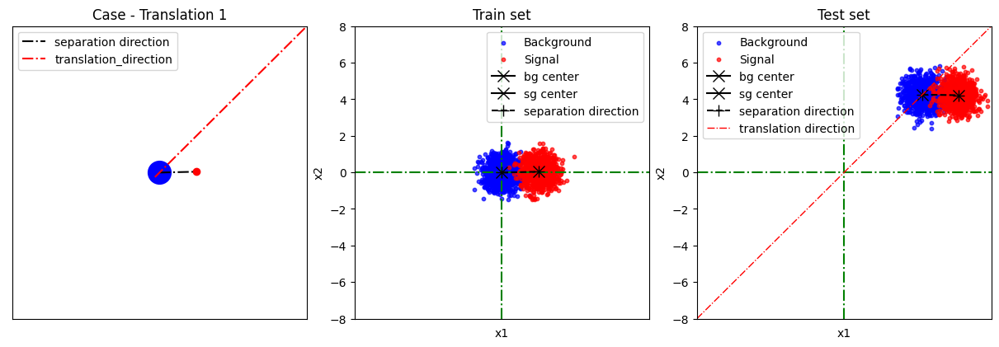

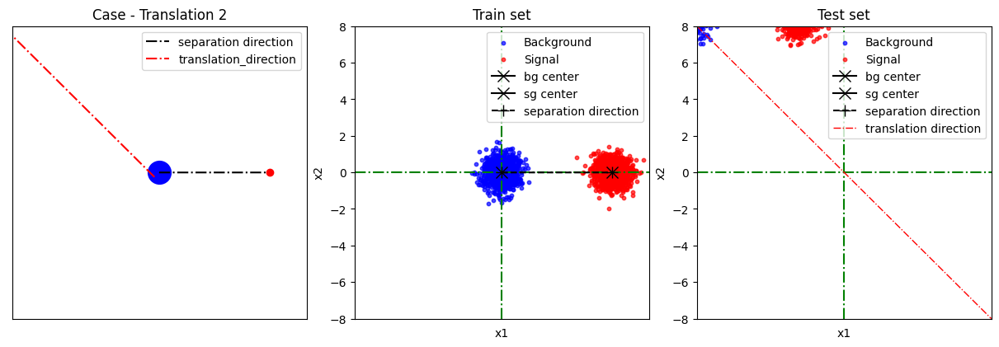

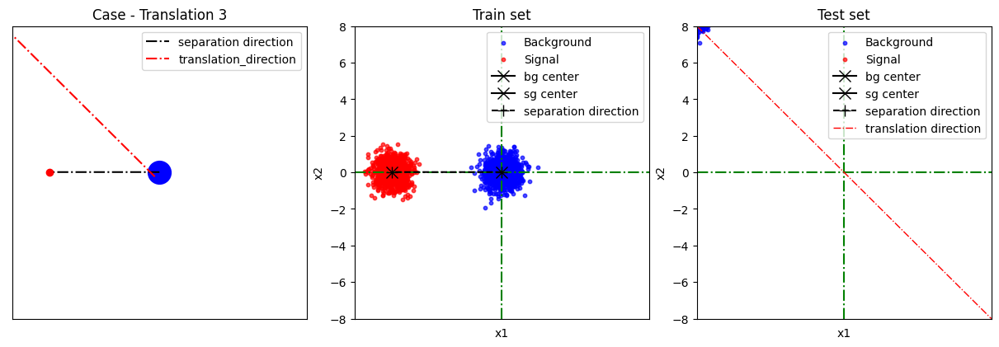

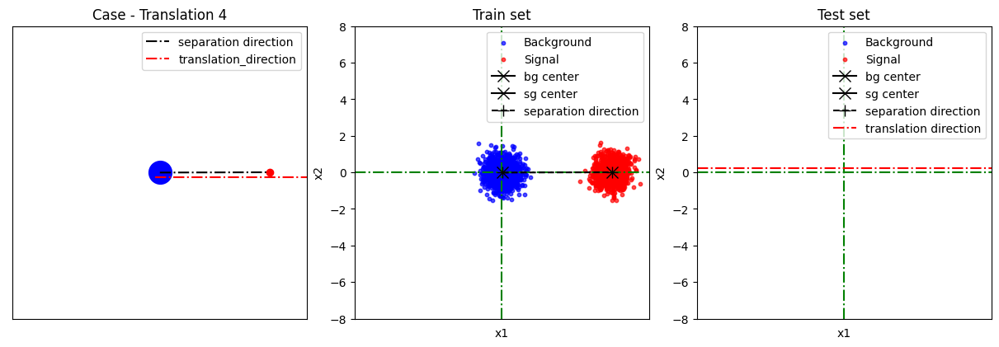

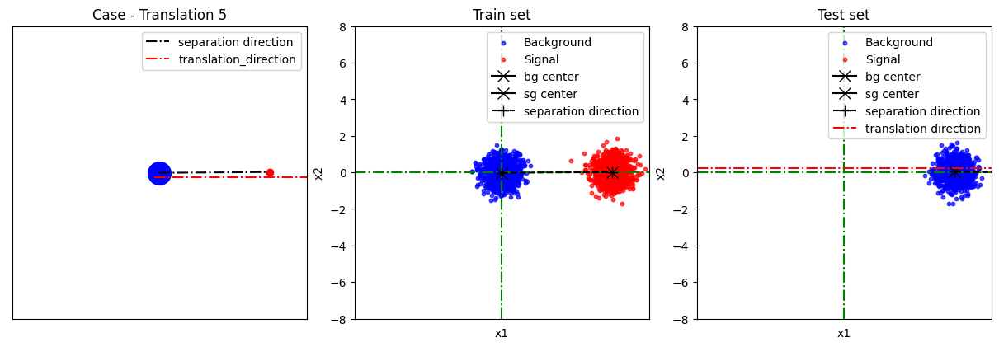

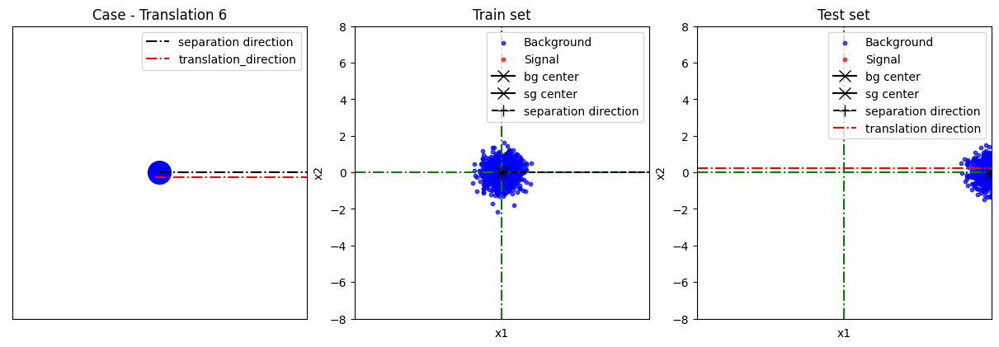

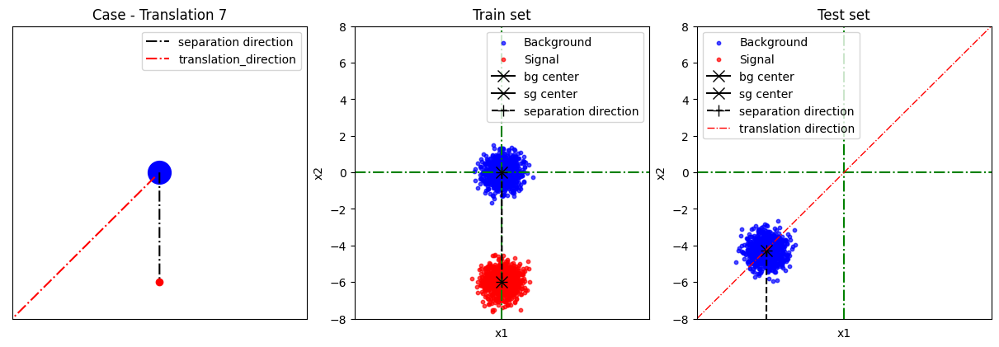

In [11]:
for index, _ in enumerate(train_sets):
    visualize_data(settings[index], train_sets[index], test_sets[index])
    if index == 6:
        break

## 1.4 - Set parameters for DANN

In [12]:
input_size  = (2,)
hp_lambda = 1.0
num_epochs  = 50
batch_size  = 20
# Becarefull that batch_size cannot be odd : if you set it to 25, each training batch will actualy be of size 24 
# and some samples will not be used at each epoch. 
# The reason for this is that training batches are made of the same number of source and target points 
nums_source_samples = [train_set["labels"].shape[0] for train_set in train_sets]

nums_target_samples = [test_set["labels"].shape[0] for test_set in test_sets]
nums_train_steps_per_epoch = [math.ceil((num_source_samples+num_target_samples)/batch_size) for num_source_samples,num_target_samples in zip(nums_source_samples,nums_target_samples)]
nums_test_steps_per_epoch = [math.ceil(num_target_samples/batch_size) for num_target_samples in nums_target_samples]

## 1.5 - Prepare data for DANN

In [13]:
from DANN import set_data_for_DANN,build_datasets_for_DANN

In [14]:
x_sources, y_sources, x_targets, y_targets = set_data_for_DANN (train_sets,test_sets)

In [15]:
training_datasets, testing_datasets = build_datasets_for_DANN (x_sources,y_sources,x_targets,y_targets,num_epochs, batch_size, portion_of_target_for_train=1)

## 1.6 - Use DANN

In [16]:
from DANN import (build_DANN,
                  compile_DANN,
                  fit_DANN,
                  evaluate_DANN,
                  add_new_feature)
from visualize import (visualize_DANN_boundaries,
                       visualize_history)

import DANN_program.DANN as DANN
DANN = importlib.reload(DANN)
build_DANN = DANN.build_DANN
fit_DANN = DANN.fit_DANN
compile_DANN = DANN.compile_DANN
add_new_feature = DANN.add_new_feature

In [17]:
models = []
histories = []
for i,data_pack in enumerate(zip(training_datasets,testing_datasets,settings,nums_train_steps_per_epoch,nums_test_steps_per_epoch)):

    # Unpack
    training_dataset,testing_dataset,setting,num_train_steps_per_epoch,num_test_steps_per_epoch = data_pack
    
    # Build DANN
    DANN_model = build_DANN("DANN_"+str(i+1),input_size,hp_lambda)
    print("Started to work with", DANN_model.name)
    
    # Compile DANN
    compile_DANN(DANN_model)
    
    # Fit DANN
    history = fit_DANN(DANN_model,training_dataset,testing_dataset,num_epochs,num_train_steps_per_epoch,num_test_steps_per_epoch)
    models.append(DANN_model)
    histories.append(history)
    
    # Stop
    if i == 6 :
        break

Started to work with DANN_1
Started to work with DANN_2
Started to work with DANN_3
Started to work with DANN_4
Started to work with DANN_5
Started to work with DANN_6
Started to work with DANN_7


Results with  DANN_1
63/63 [==============================] - 0s 2ms/step


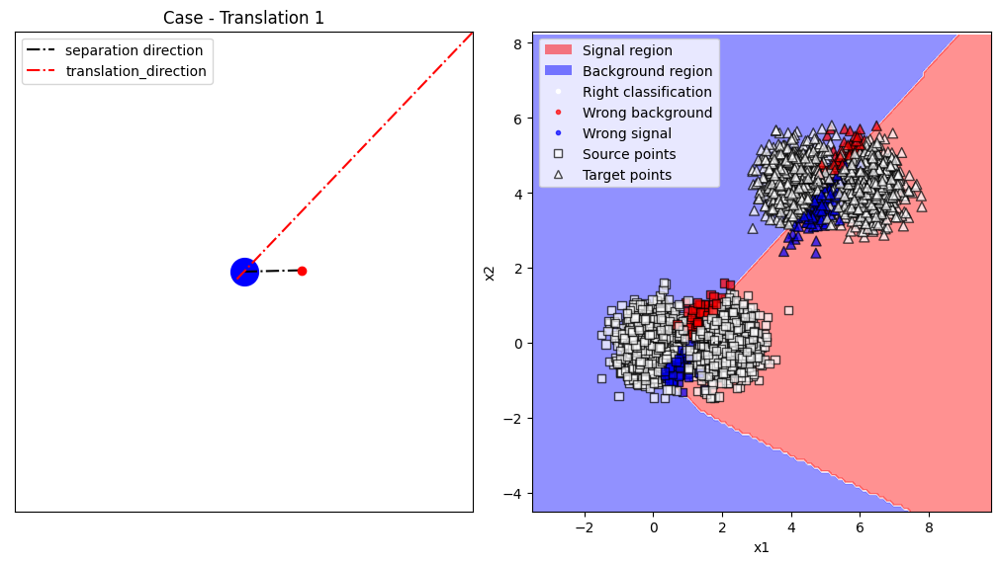

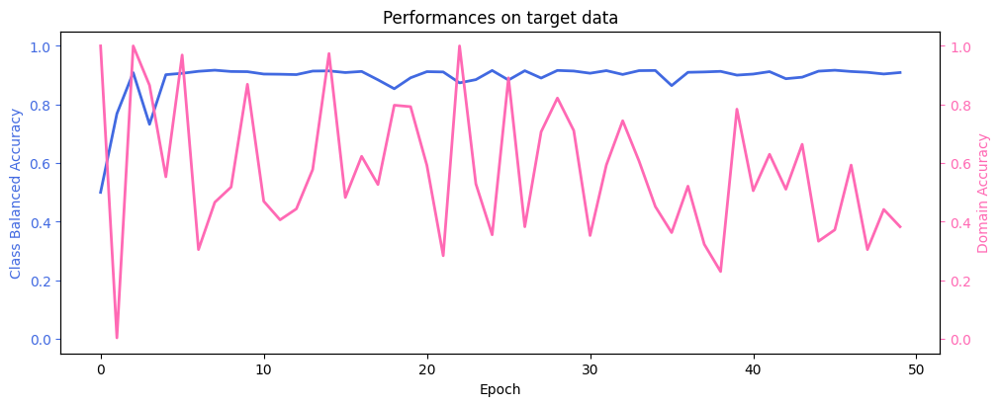

Results with  DANN_2
63/63 [==============================] - 0s 2ms/step


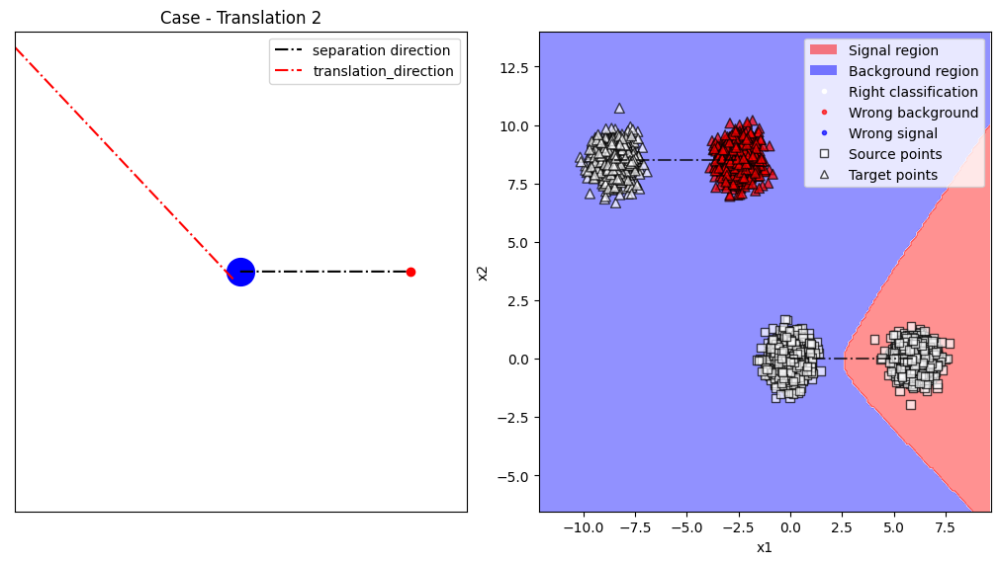

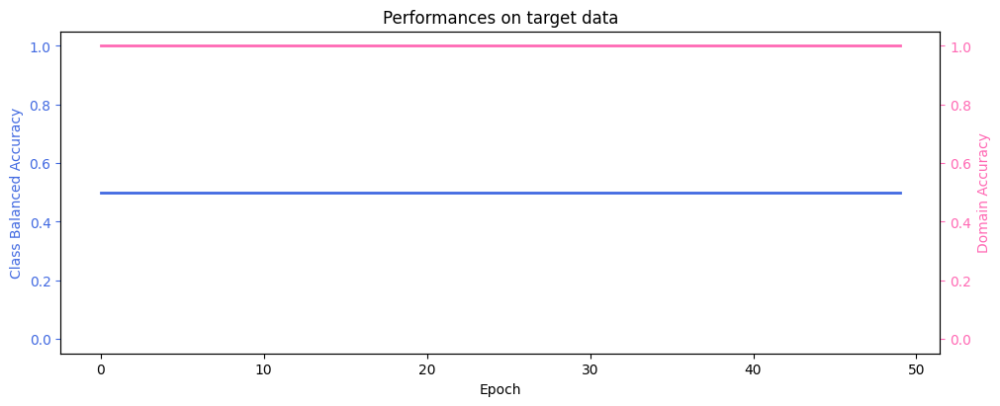

Results with  DANN_3
63/63 [==============================] - 0s 1ms/step


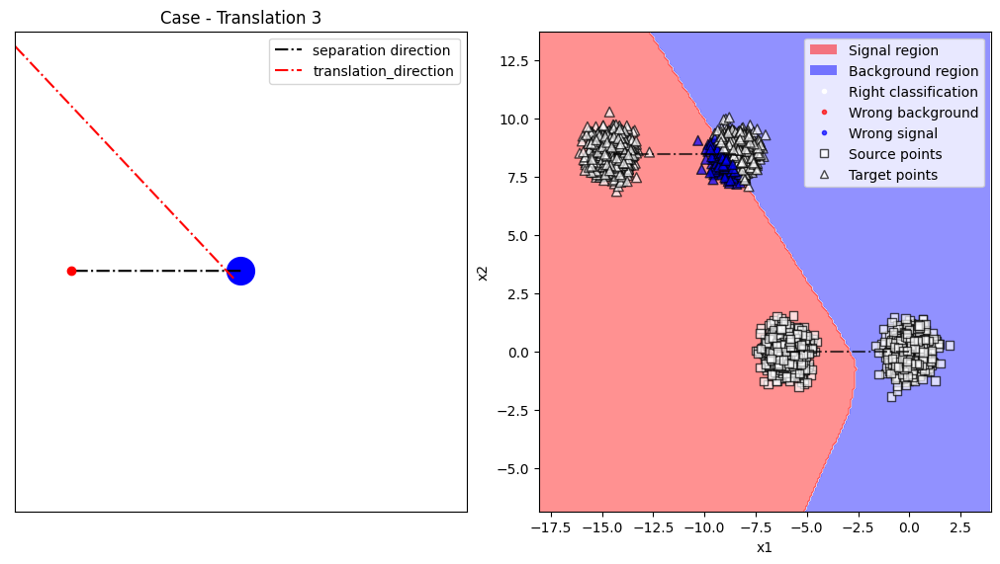

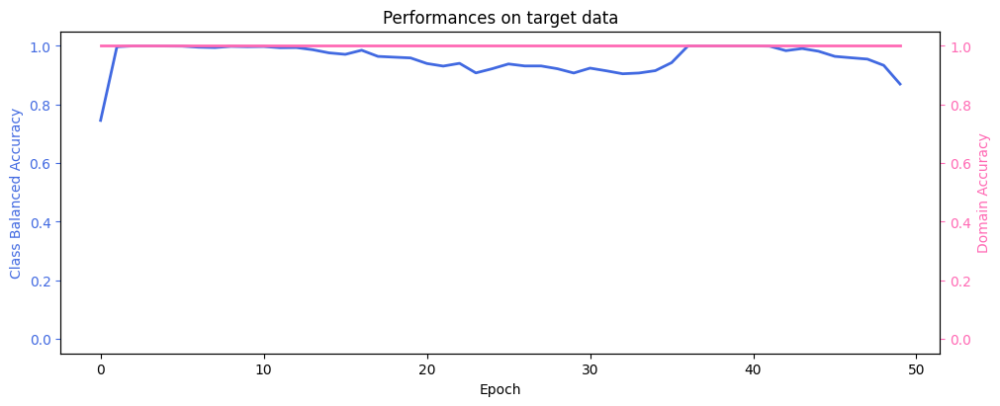

Results with  DANN_4
63/63 [==============================] - 0s 2ms/step


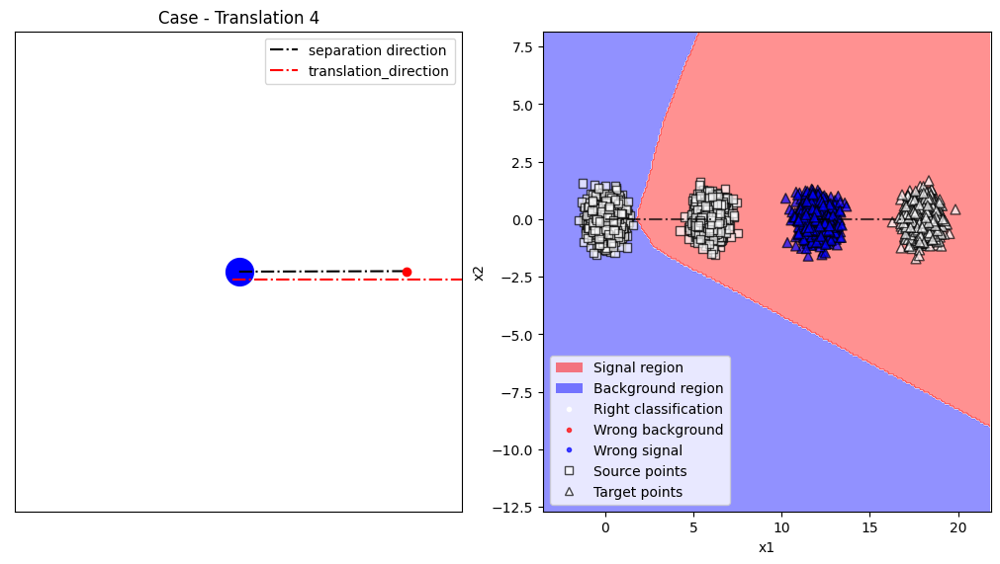

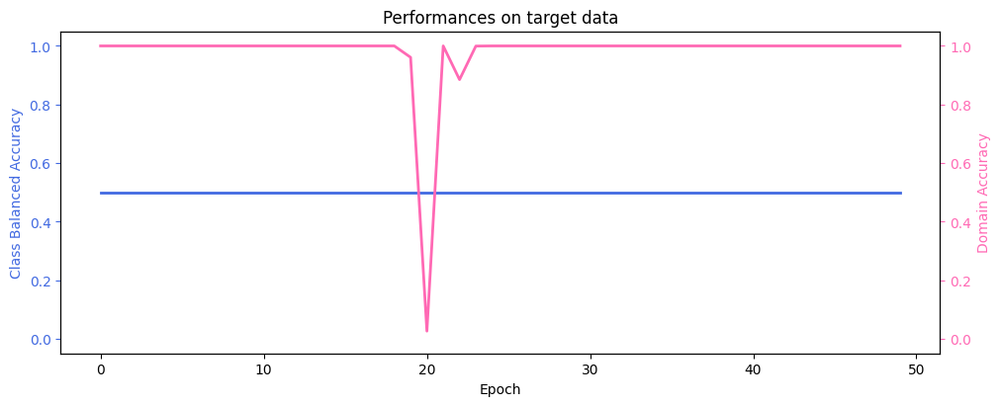

Results with  DANN_5
63/63 [==============================] - 0s 1ms/step


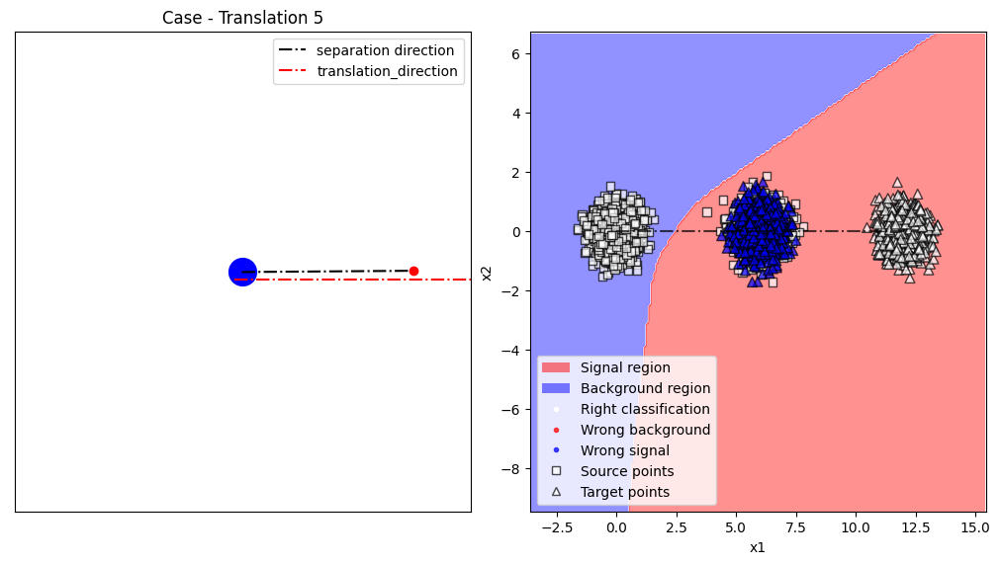

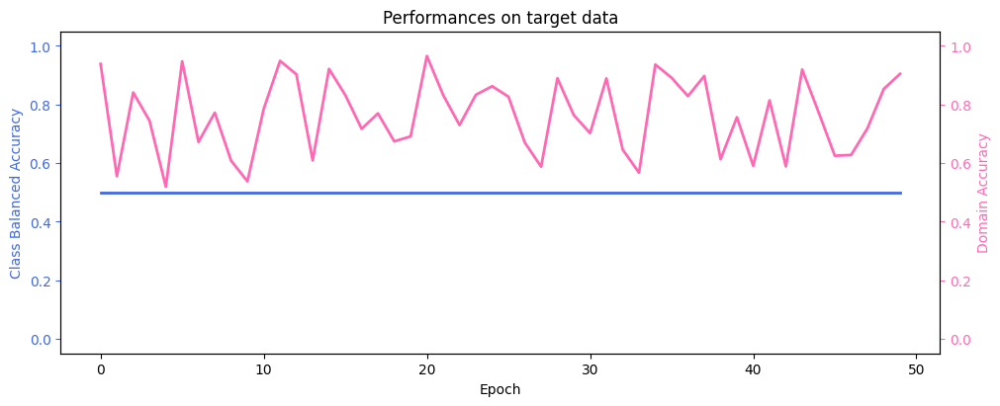

Results with  DANN_6
63/63 [==============================] - 0s 1ms/step


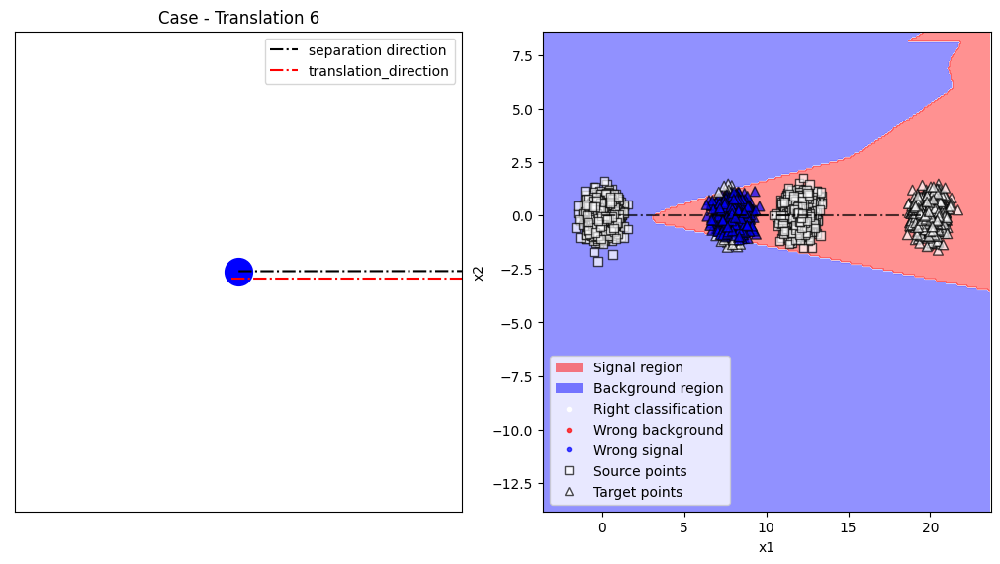

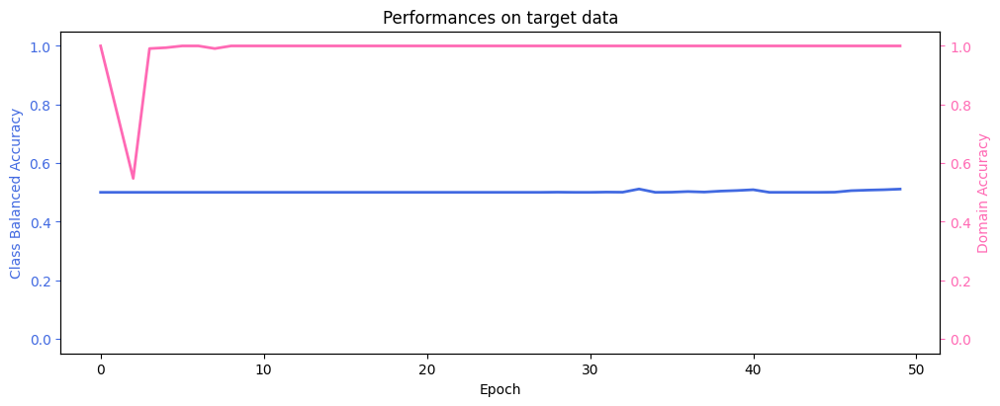

Results with  DANN_7
63/63 [==============================] - 0s 1ms/step


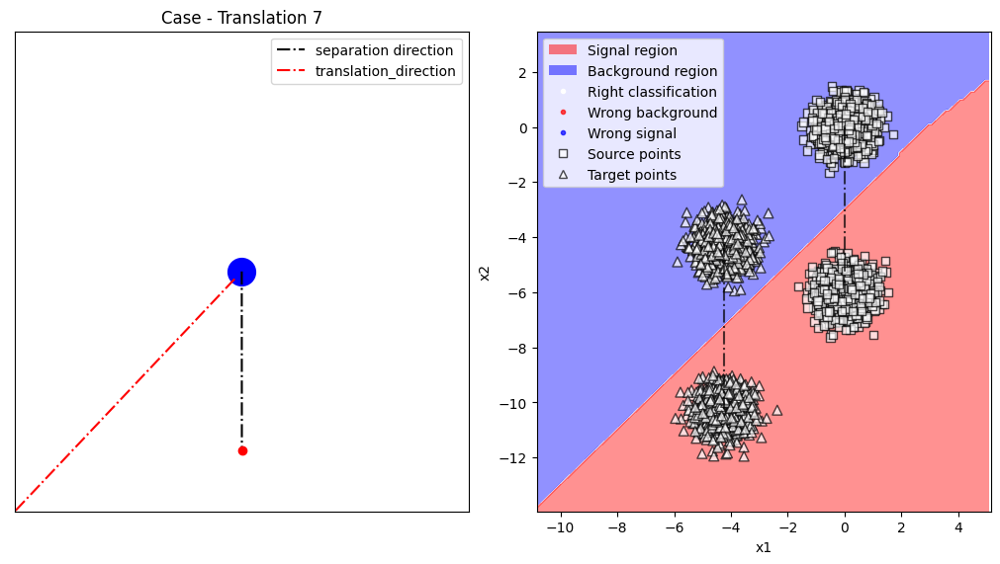

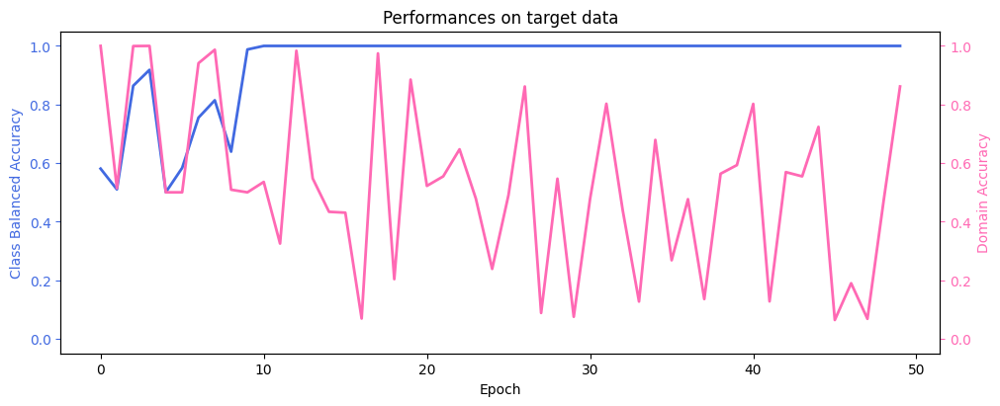

In [18]:
for i,data_pack in enumerate(zip(models,x_sources,y_sources,x_targets,y_targets,settings,histories)):
    
    # Unpack
    DANN_model,x_source,y_source,x_target,y_target,setting,history = data_pack
    print("Results with ", DANN_model.name)
    
    # Evaluate DANN
    results = evaluate_DANN(DANN_model,x_source, y_source, x_target, y_target)
    
    # Visualize DANN
    before_training = False # If True, true color of the points and no decision boundary. Prediction colors if False
    source_alpha = 0.7 # Opacity of source points
    target_alpha = 0.7 # Opacity of target points
    target_colors = True # Plot target points with meaningful colors if True and in grey if False
    regions_alpha = 0.5 # Opacity of prediction regions
    show_scores = False # Whether or not to show the title made of scores
    save_figure = False
    visualize_DANN_boundaries(DANN_model, x_source.values, y_source, x_target.values, y_target, setting, results, before_training, source_alpha, target_alpha, target_colors, regions_alpha, show_scores, save_figure)
    
    visualize_history(history)

Remarks for better performances :
- Translation 1 : 
- Translation 2 : Bending problem (see technical report). The effect of this problem becomes negligeable as the bias becomes smaller and can be mitigated with preprocessing (normalization).
- Translation 3 : 
- Translation 4 : intrinsic limitation of the DANN. The DANN is only able to extend decision boundary in the direction of the target domain. Since this direction is the same as the direction of separation, DANN will never propagate the decision boundary in a meaningful way for classification on target domain. To tackle this problem, we offer an extra dimension to the DANN by providing it a new feature in section 1.7, see technical report for more details.
- Translation 5 : intrinsic diffulty of the case. Whatever the parameters, the symmetry of the distributions will always make it difficult and unatural to achieve a good trade-off between source and target performances. Again, see section 1.7 to overcome this issue.
- Translation 6 : bigger lambda, smaller batches, more complex model.
- Translation 7 :

## 1.7 - 3D DANN

In [34]:
from visualize import visualize_3D_DANN_boundaries

import ingestion_program.visualize as visualize
visualize = importlib.reload(visualize)
visualize_3D_DANN_boundaries = visualize.visualize_3D_DANN_boundaries

In [20]:
input_size  = (3,)

In [21]:
# Add third feature containing the domain label (1 for source samples and 0 for target samples)
training_datasets_3D,testing_datasets_3D,x_sources_3D,x_targets_3D = add_new_feature(training_datasets,testing_datasets,x_sources,x_targets)

In [22]:
models_3D = []
histories_3D = []
for i,data_pack in enumerate(zip(training_datasets_3D,testing_datasets_3D,settings,nums_train_steps_per_epoch,nums_test_steps_per_epoch)):

    # Unpack
    training_dataset_3D,testing_dataset_3D,setting,num_train_steps_per_epoch,num_test_steps_per_epoch = data_pack
    
    # Build DANN
    DANN_model_3D = build_DANN("DANN_3D_"+str(i+1),input_size,hp_lambda)
    print("Started to work with", DANN_model_3D.name)
    
    # Compile DANN
    compile_DANN(DANN_model_3D)
    
    # Fit DANN
    history_3D = fit_DANN(DANN_model_3D,training_dataset_3D,testing_dataset_3D,num_epochs,num_train_steps_per_epoch,num_test_steps_per_epoch)
    models_3D.append(DANN_model_3D)
    histories_3D.append(history_3D)
    
    # Stop
    if i == 6 :
        break

Started to work with DANN_3D_1
Started to work with DANN_3D_2
Started to work with DANN_3D_3
Started to work with DANN_3D_4
Started to work with DANN_3D_5
Started to work with DANN_3D_6
Started to work with DANN_3D_7


In [37]:
visualize = importlib.reload(visualize)
visualize_3D_DANN_boundaries = visualize.visualize_3D_DANN_boundaries

In [38]:
detail = 50 # number of points per 1D unit in the 3D render of the decision boundary. The higher, the slower.

Results with  DANN_3D_1
63/63 [==============================] - 0s 2ms/step


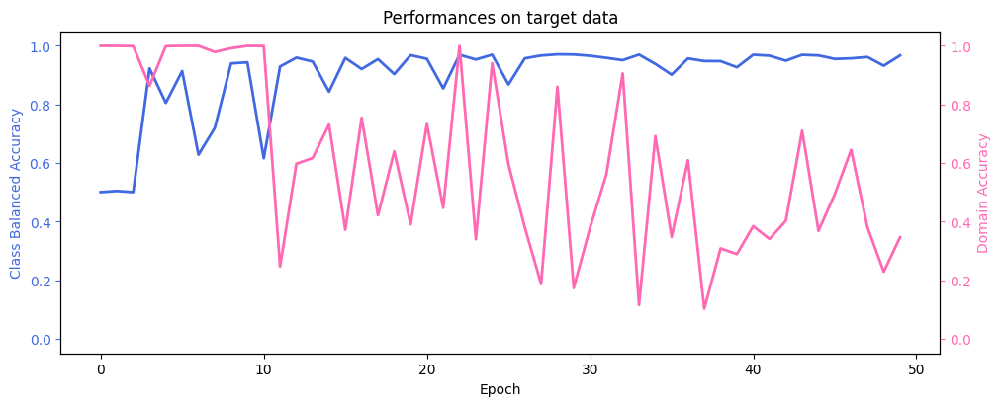

Results with  DANN_3D_2
63/63 [==============================] - 0s 2ms/step


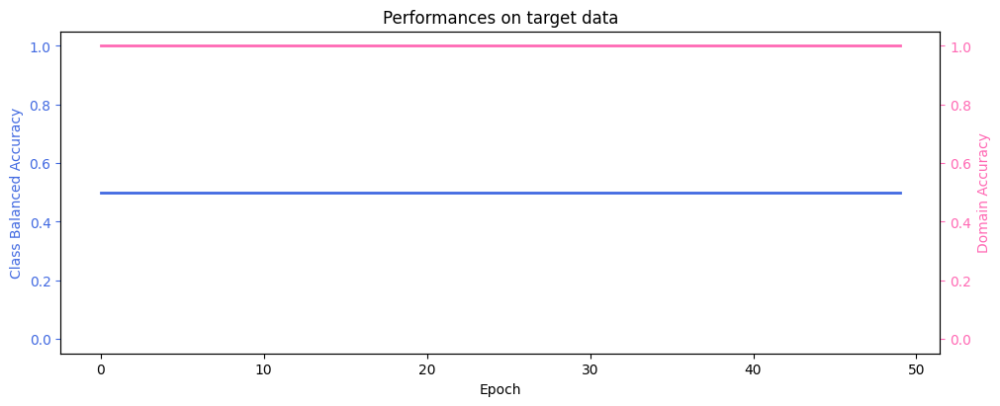

Results with  DANN_3D_3
63/63 [==============================] - 0s 757us/step


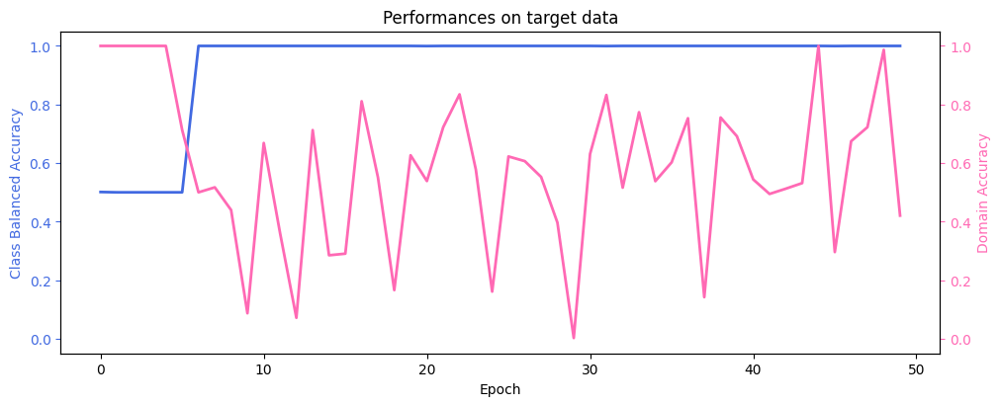

Results with  DANN_3D_4
63/63 [==============================] - 0s 2ms/step


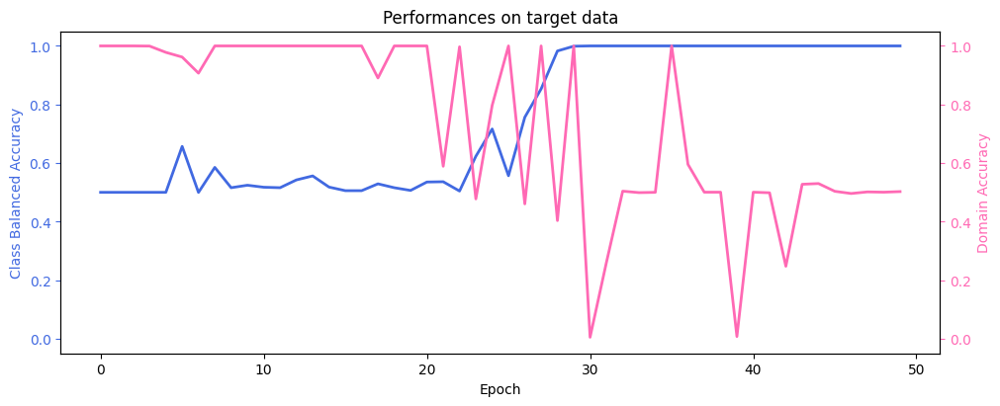

Results with  DANN_3D_5
63/63 [==============================] - 0s 2ms/step


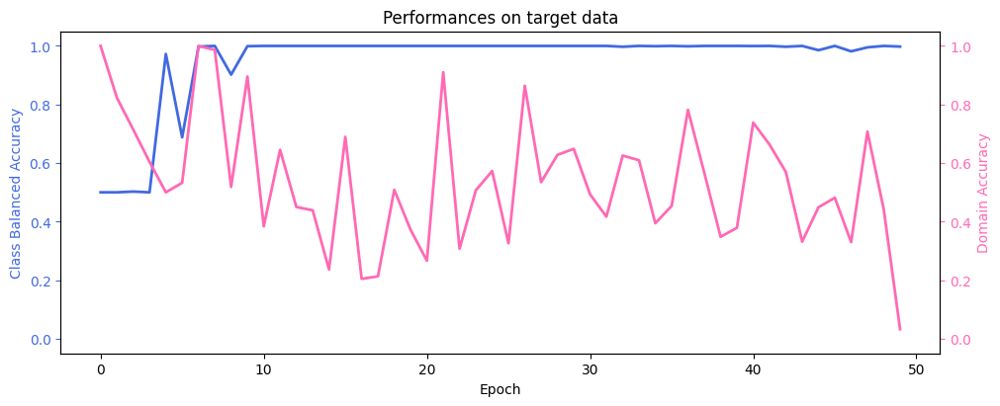

Results with  DANN_3D_6
63/63 [==============================] - 0s 2ms/step


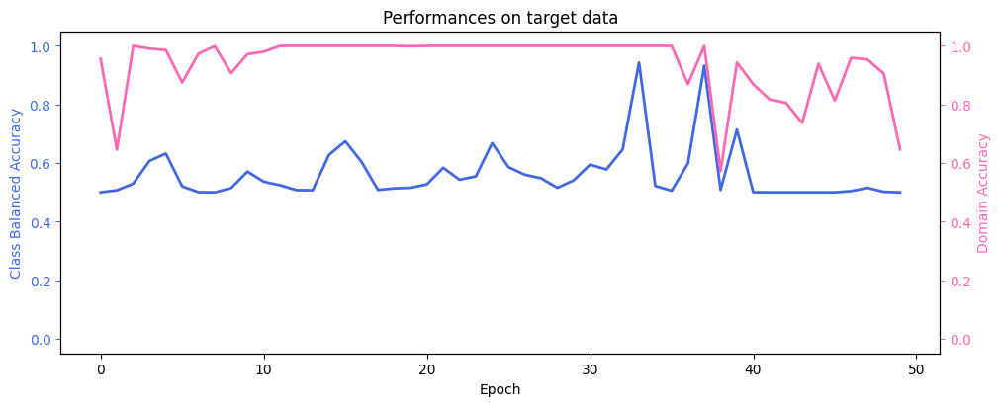

Results with  DANN_3D_7
63/63 [==============================] - 0s 2ms/step


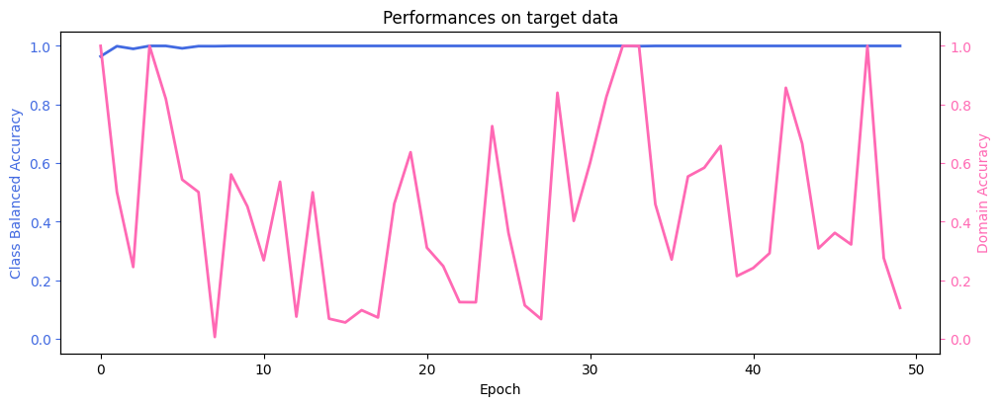

In [39]:
for i,data_pack in enumerate(zip(models_3D, x_sources_3D, y_sources, x_targets_3D, y_targets, histories_3D)) :
    
    # Unpack
    DANN_model_3D, x_source_3D, y_source, x_target_3D, y_target, history_3D = data_pack
    print("Results with ", DANN_model_3D.name)
    
    # Evaluate DANN
    results = evaluate_DANN(DANN_model_3D,x_source_3D, y_source, x_target_3D, y_target)
    
    # Visualize DANN
    visualize_3D_DANN_boundaries(DANN_model_3D,
                                 x_source_3D.values, y_source, x_target_3D.values, y_target,
                                 True, False,
                                 None, None, detail)
    
    visualize_history(history_3D)

The visualization of 3D decision boudary is not visible when you restart the notebook. You have to run the code to visualize it. Here is an example of such a visualization. This is the case Translation 5, where the regular DANN was unable to classify the target points. We see that the 3D is able to classify them and reach 100% accuracy.

<img src="Images/3D.gif" width=500 >

LEGEND :
- Black dots : generate the decision boundary
- Squares (top) : source points
- Circles (bottom) : target points
- Blue : true background points
- Red : true signal points

# 2 - Unbalanced (2% of signal events) Translation

## 2.1 - Generate Data

In [5]:
from data_loader import get_settings_from_json
from data_generator_all_systematics import DataGenerator

In [6]:
data_dir = "DANN_data/qualitative/Unbalanced_Translation"

In [7]:
data_gen_settings = get_settings_from_json('data_jsons/DANN_jsons/Unbalanced_Translation')
for index, settings in enumerate(data_gen_settings):
    data_gen = DataGenerator(settings_dict=settings)
    data_gen.generate_data()
    data_gen.save_data(directory=data_dir, file_index=index+1)
    

## 2.2 - Load Data

In [8]:
from data_io import load_data, show_data_statistics, write

In [9]:
train_sets, test_sets, settings = load_data(data_dir, load_settings=True)



###-------------------------------------###
### Data Loading
###-------------------------------------###

[*] data dir :  DANN_data/qualitative/Unbalanced_Translation
[*] train data dir :  DANN_data/qualitative/Unbalanced_Translation\train\data
[*] train labels dir :  DANN_data/qualitative/Unbalanced_Translation\train\labels
[*] test data dir :  DANN_data/qualitative/Unbalanced_Translation\test\data
[*] test labels dir :  DANN_data/qualitative/Unbalanced_Translation\test\labels
[*] settings dir :  DANN_data/qualitative/Unbalanced_Translation\settings
[+] train data dir found
[+] train labels dir found
[+] test data dir found
[+] test labels dir found
[+] settings dir found
[+] 6 train and test sets found
---------------------------------
[+] Train and Test data loaded!
---------------------------------




## 2.3 - Visualize Data

In [10]:
from visualize import visualize_data

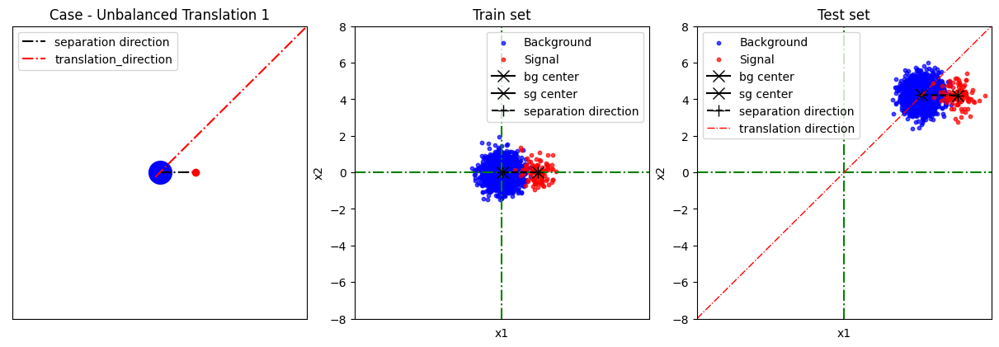

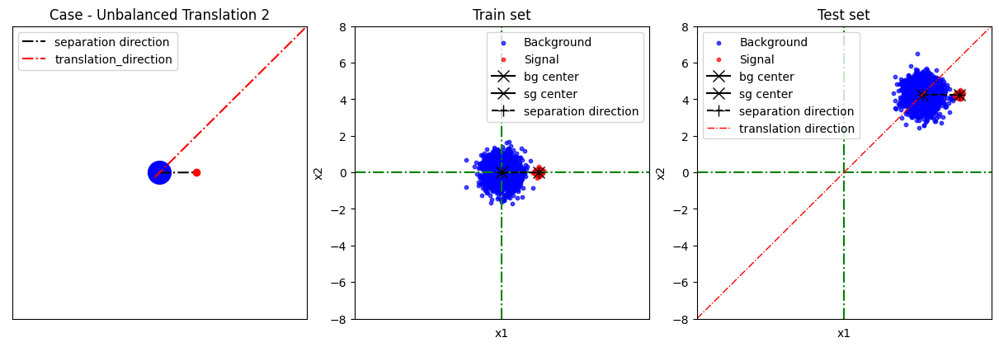

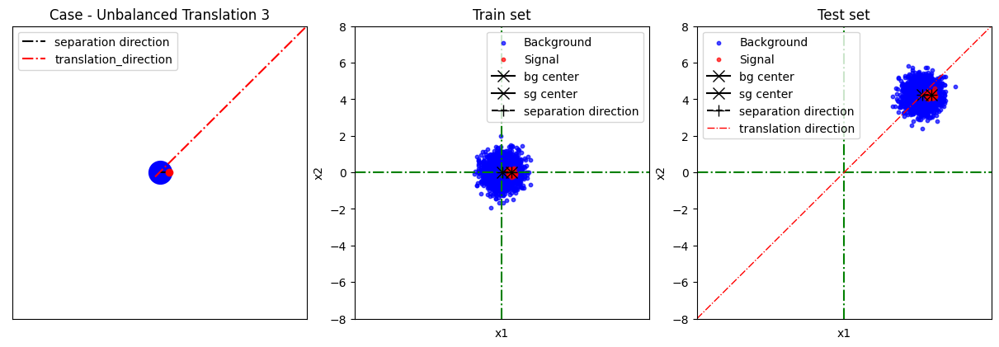

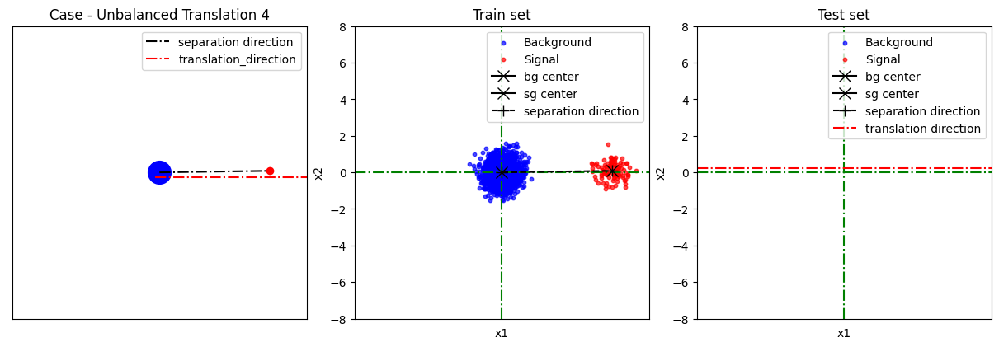

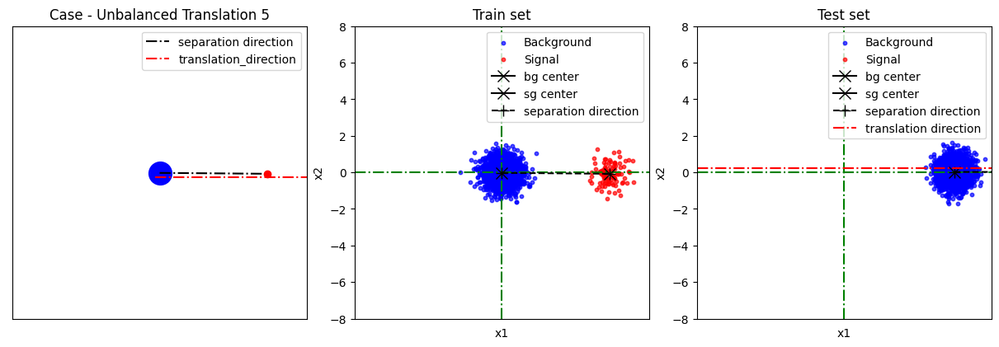

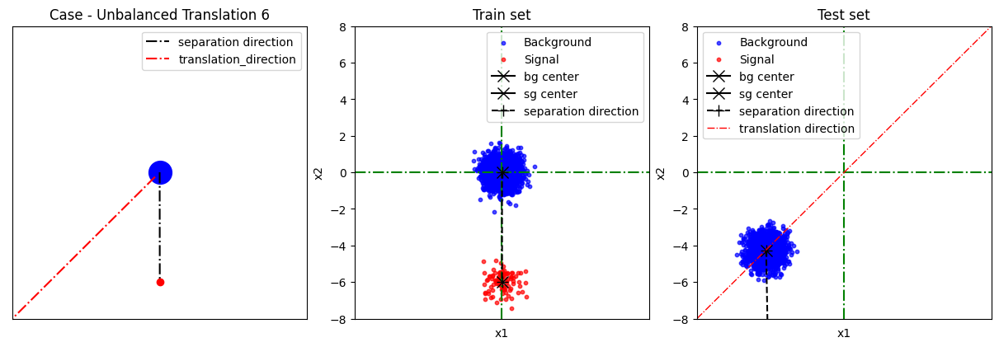

In [11]:
for index, _ in enumerate(train_sets):
    visualize_data(settings[index], train_sets[index], test_sets[index])
    #if index == 0:
    #    break

## 2.4 - Set parameters for DANN

In [12]:
input_size  = (2,)
hp_lambda = 1.0
num_epochs  = 50
batch_size  = 20
# Becarefull that batch_size cannot be odd : if you set it to 25, each training batch will actualy be of size 24 
# and some samples will not be used at each epoch. 
# The reason for this is that training batches are made of the same number of source and target points 
nums_source_samples = [train_set["labels"].shape[0] for train_set in train_sets]

nums_target_samples = [test_set["labels"].shape[0] for test_set in test_sets]
nums_train_steps_per_epoch = [math.ceil((num_source_samples+num_target_samples)/batch_size) for num_source_samples,num_target_samples in zip(nums_source_samples,nums_target_samples)]
nums_test_steps_per_epoch = [math.ceil(num_target_samples/batch_size) for num_target_samples in nums_target_samples]

## 2.5 - Prepare data for DANN

In [13]:
from DANN import set_data_for_DANN,build_datasets_for_DANN

In [14]:
x_sources, y_sources, x_targets, y_targets = set_data_for_DANN (train_sets,test_sets)

In [15]:
training_datasets, testing_datasets = build_datasets_for_DANN (x_sources,y_sources,x_targets,y_targets,num_epochs, batch_size, portion_of_target_for_train=1)

## 2.6 - Use DANN

In [16]:
from DANN import (build_DANN,
                  compile_DANN,
                  fit_DANN,
                  evaluate_DANN)
from visualize import (visualize_DANN_boundaries,
                       visualize_history)

In [17]:
models = []
histories = []
for i,data_pack in enumerate(zip(training_datasets,testing_datasets,settings,nums_train_steps_per_epoch,nums_test_steps_per_epoch)):

    # Unpack
    training_dataset,testing_dataset,setting,num_train_steps_per_epoch,num_test_steps_per_epoch = data_pack
    
    # Build DANN
    DANN_model = build_DANN("DANN_"+str(i+1),input_size,hp_lambda)
    print("Started to work with", DANN_model.name)
    
    # Compile DANN
    compile_DANN(DANN_model)
    
    # Fit DANN
    history = fit_DANN(DANN_model,training_dataset,testing_dataset,num_epochs,num_train_steps_per_epoch,num_test_steps_per_epoch)
    models.append(DANN_model)
    histories.append(history)

Started to work with DANN_1
Started to work with DANN_2
Started to work with DANN_3
Started to work with DANN_4
Started to work with DANN_5
Started to work with DANN_6


Results with  DANN_1
63/63 [==============================] - 0s 2ms/step


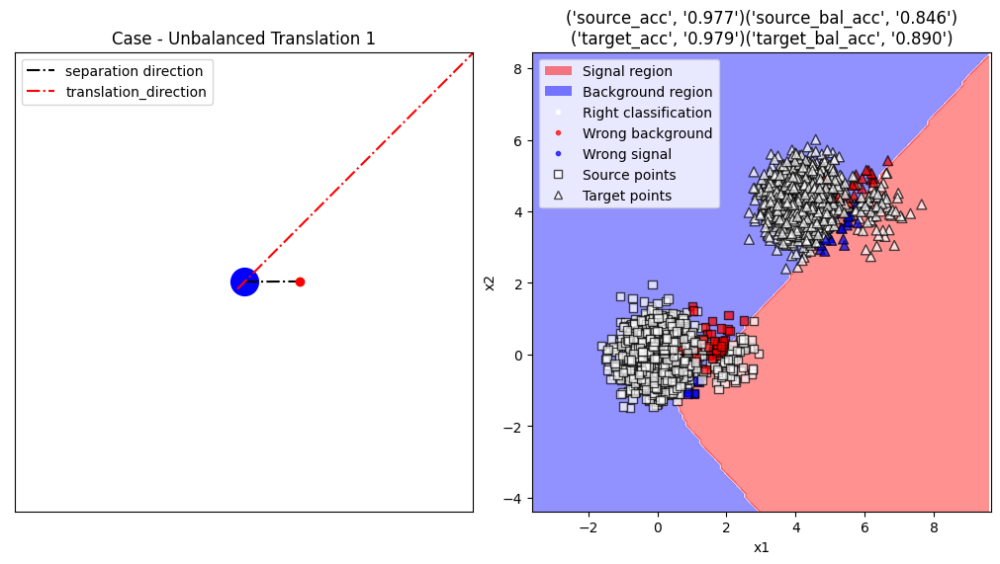

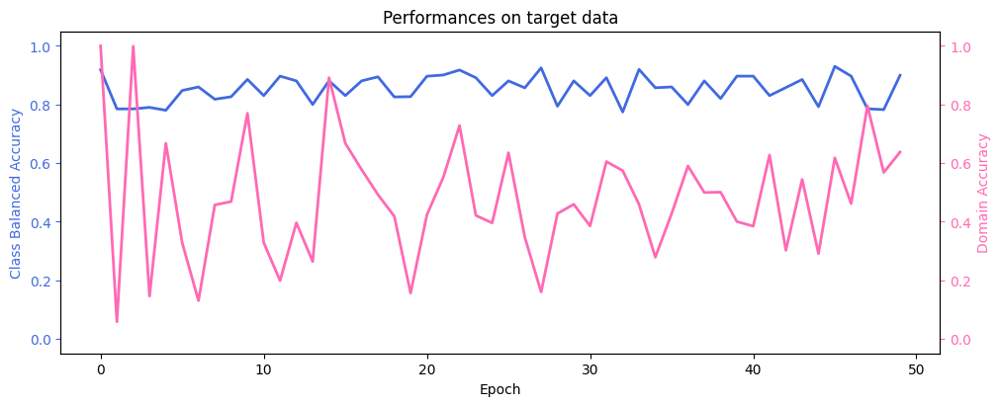

Results with  DANN_2
63/63 [==============================] - 0s 2ms/step


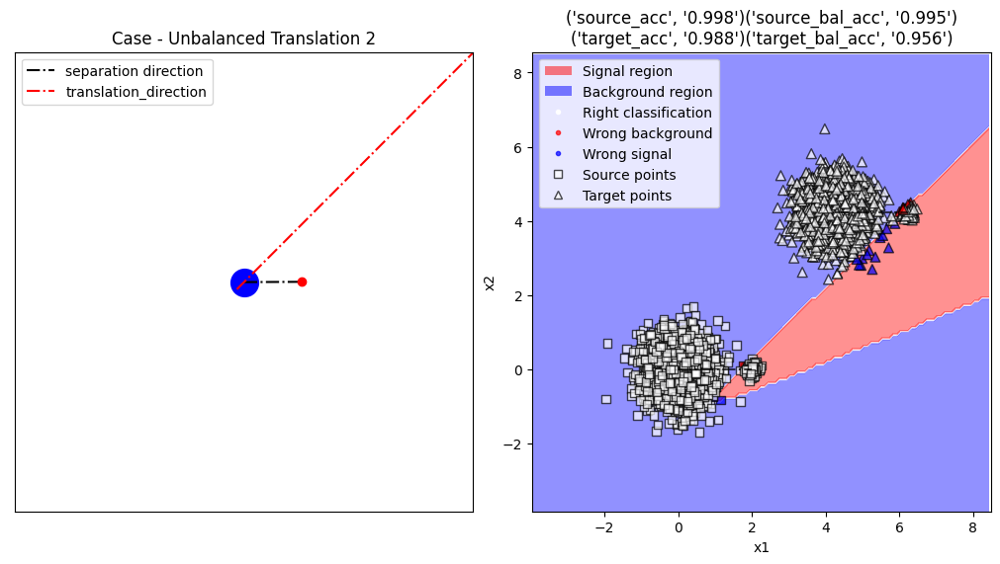

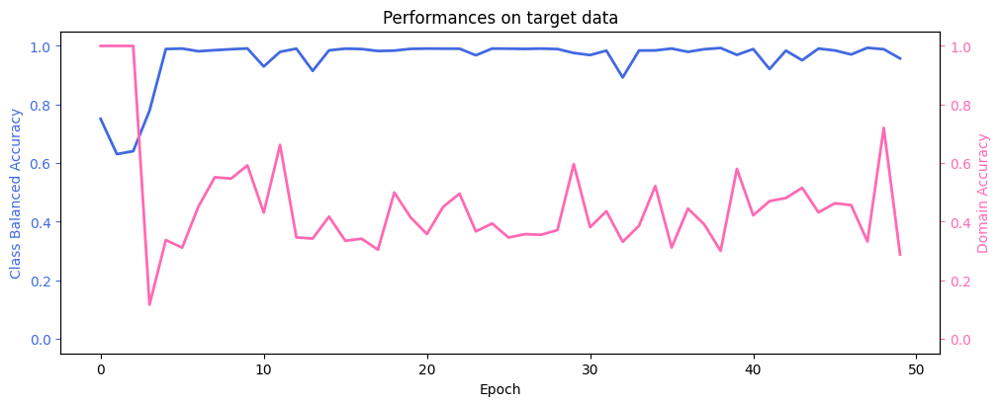

Results with  DANN_3
63/63 [==============================] - 0s 2ms/step


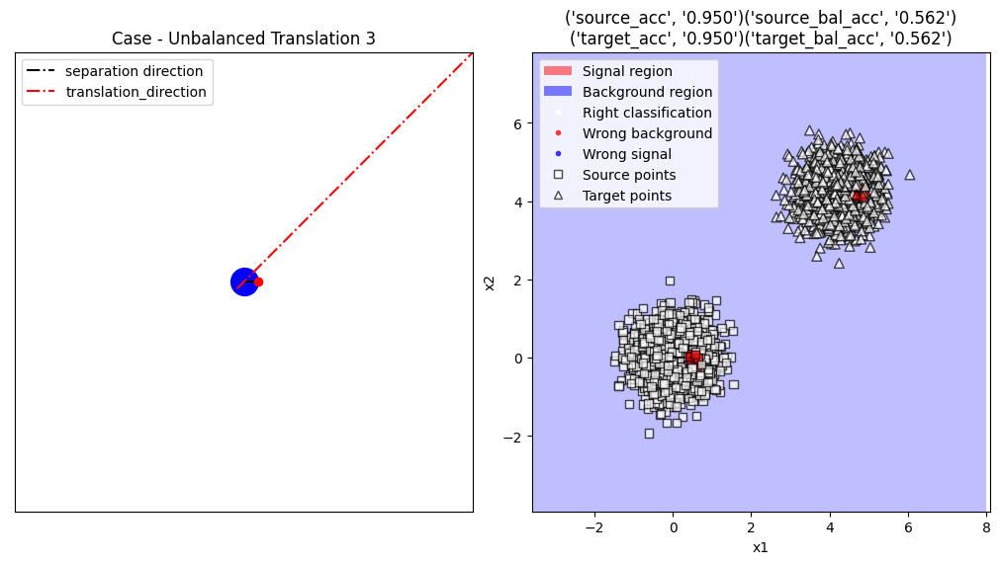

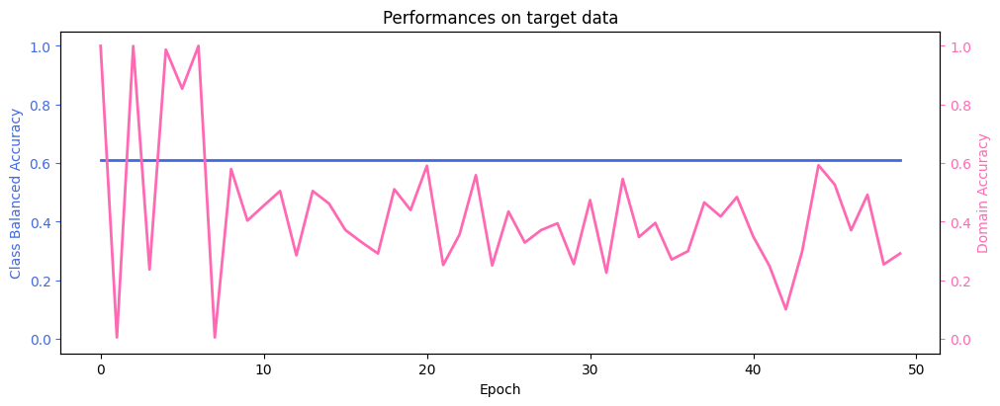

Results with  DANN_4
63/63 [==============================] - 0s 2ms/step


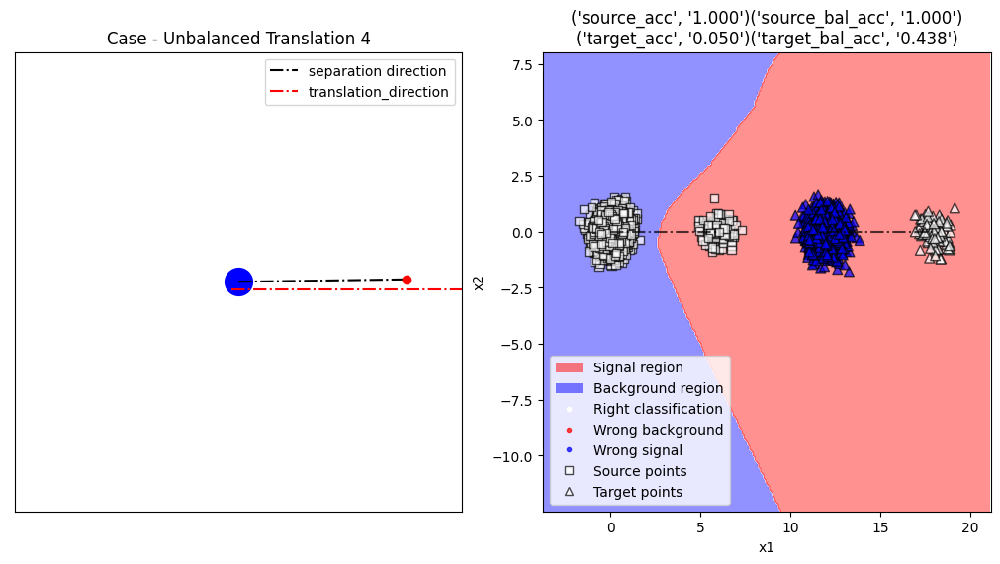

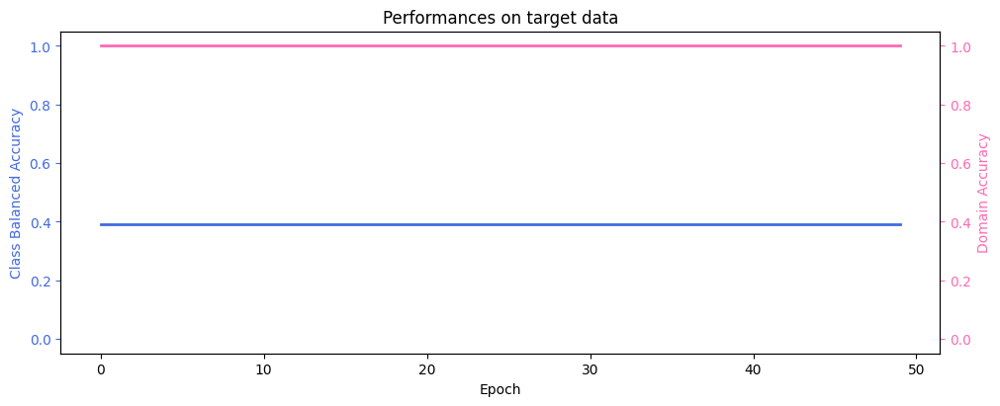

Results with  DANN_5
63/63 [==============================] - 0s 2ms/step


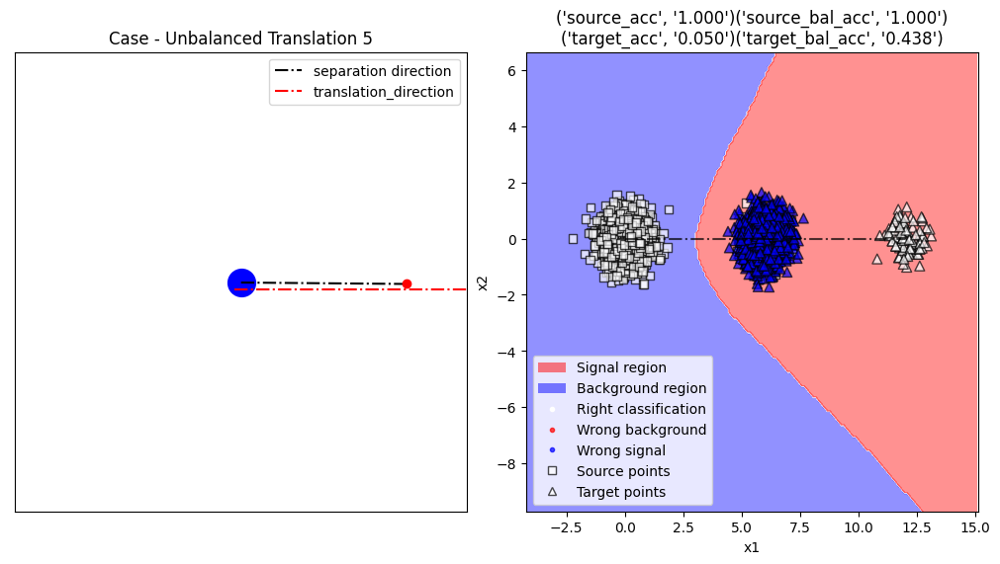

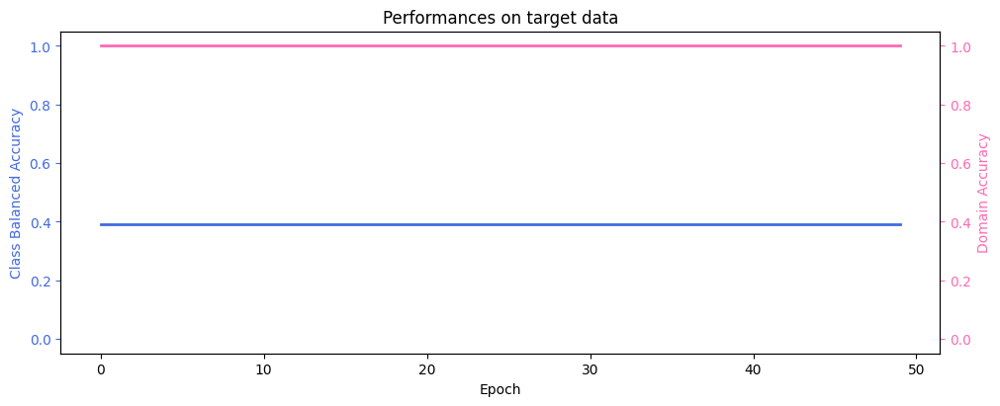

Results with  DANN_6
63/63 [==============================] - 0s 3ms/step


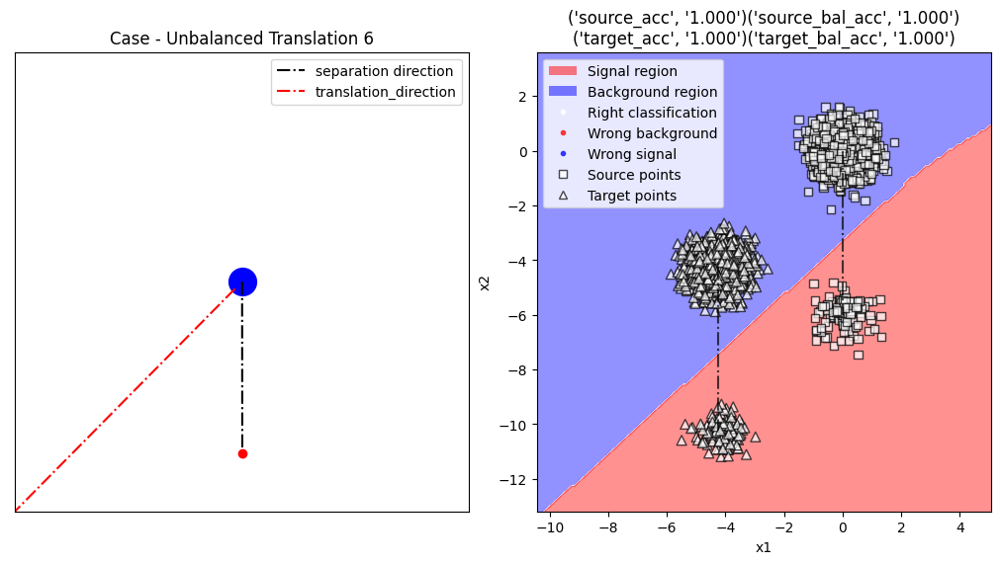

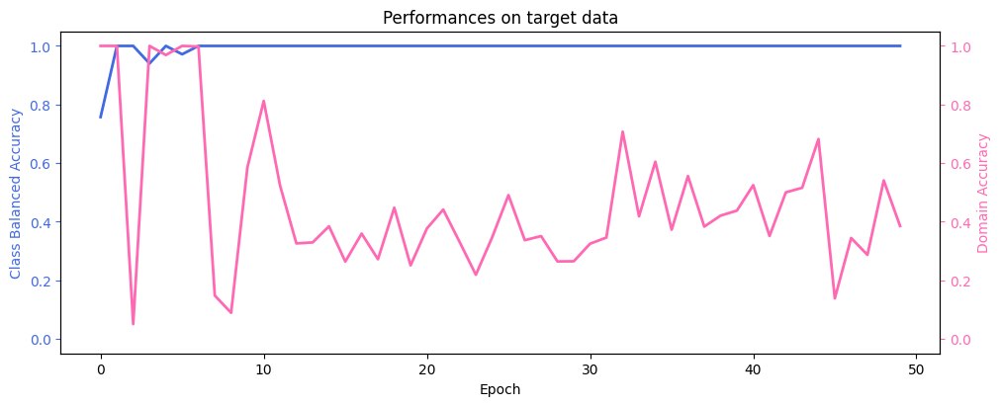

In [18]:
for i,data_pack in enumerate(zip(models,x_sources,y_sources,x_targets,y_targets,settings,histories)):

    # Unpack
    DANN_model,x_source,y_source,x_target,y_target,setting,history = data_pack
    print("Results with ", DANN_model.name)
    
    # Evaluate DANN
    results = evaluate_DANN(DANN_model,x_source, y_source, x_target, y_target)
    
    # Visualize DANN
    before_training = False # If True, true color of the points and no decision boundary. Prediction colors if False
    source_alpha = 0.7 # Opacity of source points
    target_alpha = 0.7 # Opacity of target points
    target_colors = True # Plot target points with meaningful colors if True and in grey if False
    regions_alpha = 0.5 # Opacity of prediction regions
    show_scores = True # Whether or not to show the title made of scores
    save_figure = True
    visualize_DANN_boundaries(DANN_model, x_source.values, y_source, x_target.values, y_target, setting, results, before_training, source_alpha, target_alpha, target_colors, regions_alpha, show_scores, save_figure)
    
    visualize_history(history)

Remarks for better performances :
- Unbalanced Translation 1 : tell the model about the imbalance of the dataset, see section 2.7.
- Unbalanced Translation 2 : idem.
- Unbalanced Translation 3 : this case shows an intrinsic limitation of the DANN. The DANN is only able to extend decision boundary in the direction of the target domain. If it thinks that closed-circular boundary around the signal points of the source domain is better, then there is no way for it to create a similar closed-circular boundary around the target domain. This is because the DANN doesn't have access to target labels. To tackle thi issue, one can increasing the dimension of the feature space as performed in section 1.7.
- Unbalanced Translation 4 : tell the model about the imbalance of the dataset, same as Translation 4.
- Unbalanced Translation 5 : same as Translation 5.
- Unbalanced Translation 6 :

## 2.7 - Use DANN, but we mitigate data imbalance with weights

In [19]:
class_weights = [1,49]

In [20]:
models = []
histories = []
for i,data_pack in enumerate(zip(training_datasets,testing_datasets,settings,nums_train_steps_per_epoch,nums_test_steps_per_epoch)):

    # Unpack
    training_dataset,testing_dataset,setting,num_train_steps_per_epoch,num_test_steps_per_epoch = data_pack
    
    # Build DANN
    DANN_model = build_DANN("DANN_"+str(i+1),input_size,hp_lambda)
    print("Started to work with", DANN_model.name)
    
    # Compile DANN
    compile_DANN(DANN_model,class_weights)
    
    # Fit DANN
    history = fit_DANN(DANN_model,training_dataset,testing_dataset,num_epochs,num_train_steps_per_epoch,num_test_steps_per_epoch)
    models.append(DANN_model)
    histories.append(history)

Started to work with DANN_1
Started to work with DANN_2
Started to work with DANN_3
Started to work with DANN_4
Started to work with DANN_5
Started to work with DANN_6


Results with  DANN_1
63/63 [==============================] - 0s 2ms/step


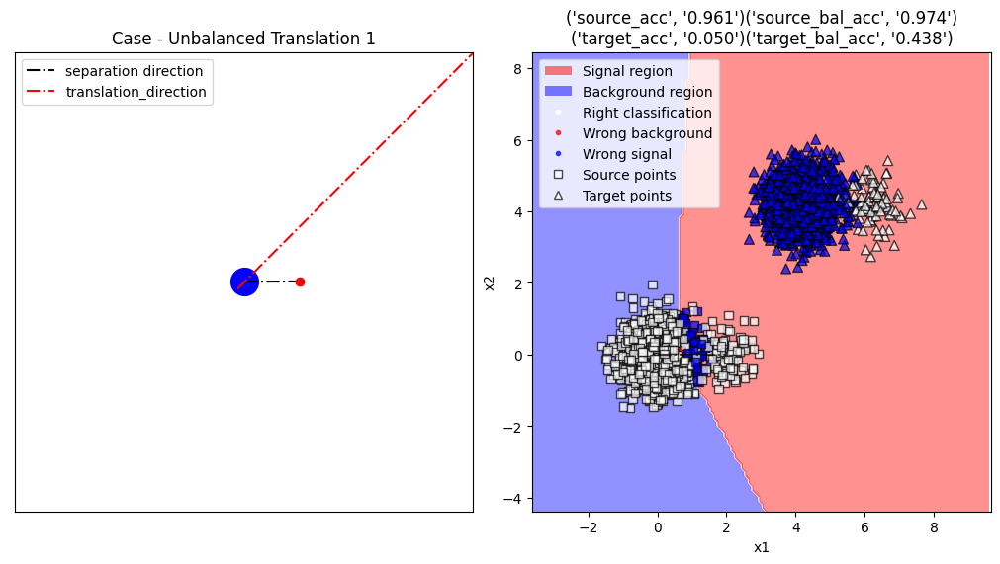

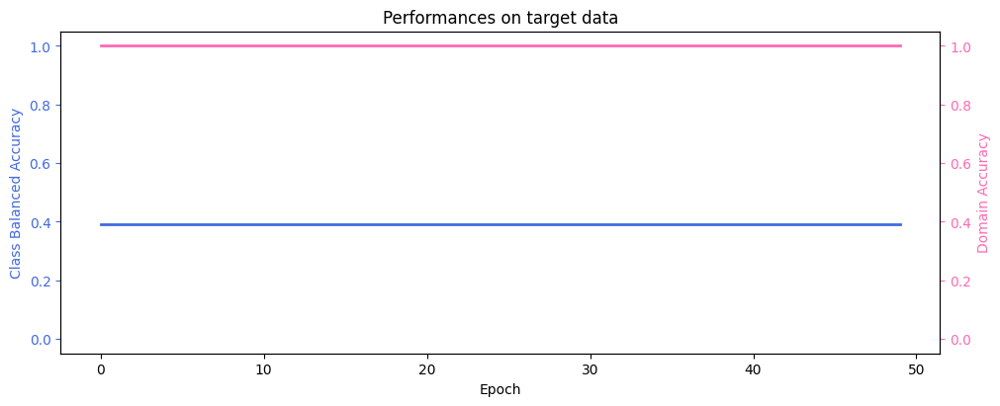

Results with  DANN_2
63/63 [==============================] - 0s 2ms/step


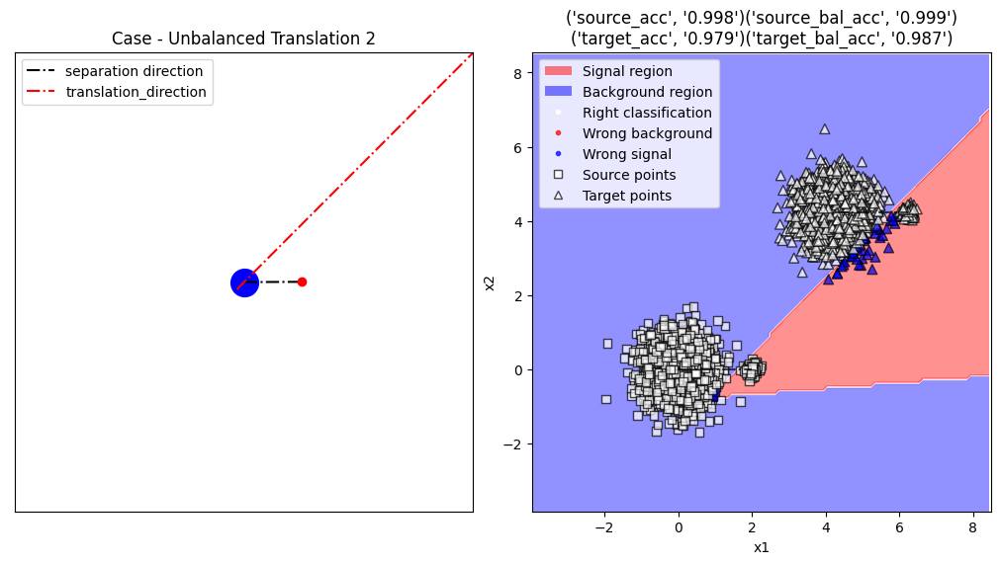

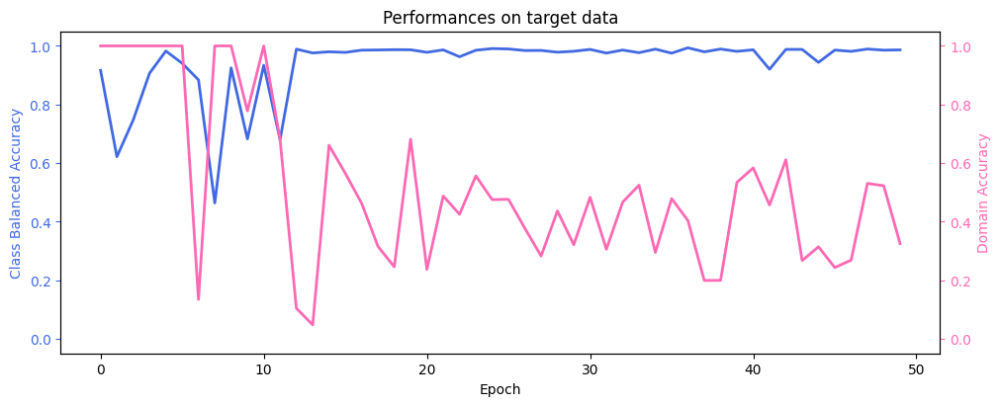

Results with  DANN_3
63/63 [==============================] - 0s 2ms/step


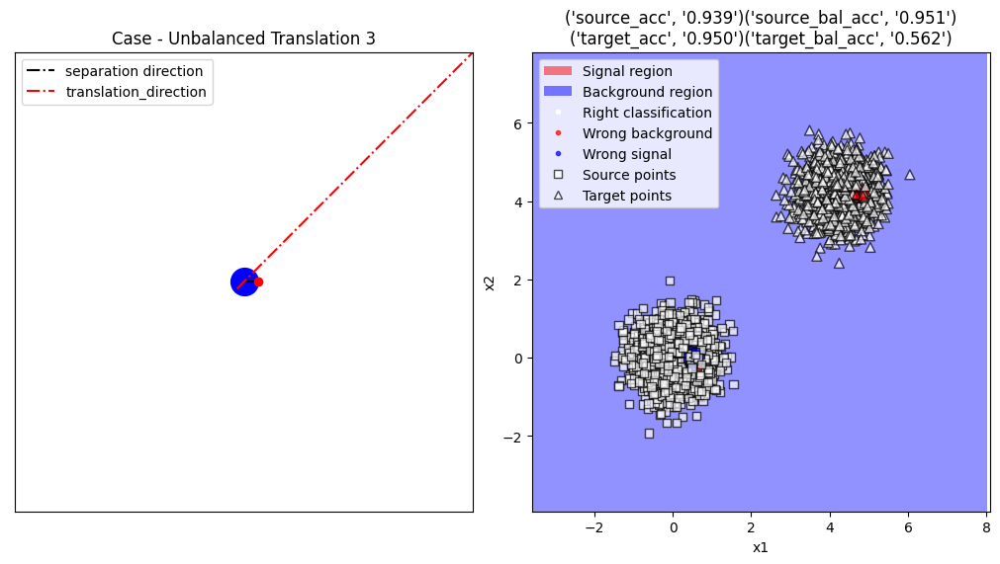

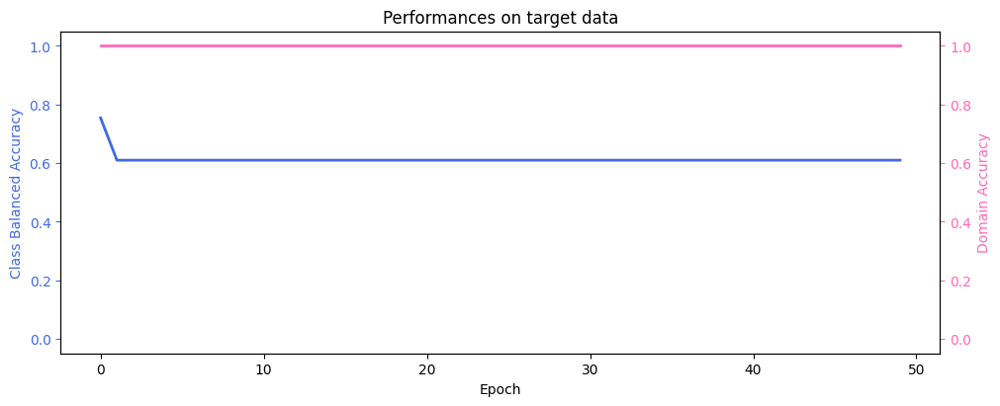

Results with  DANN_4
63/63 [==============================] - 0s 2ms/step


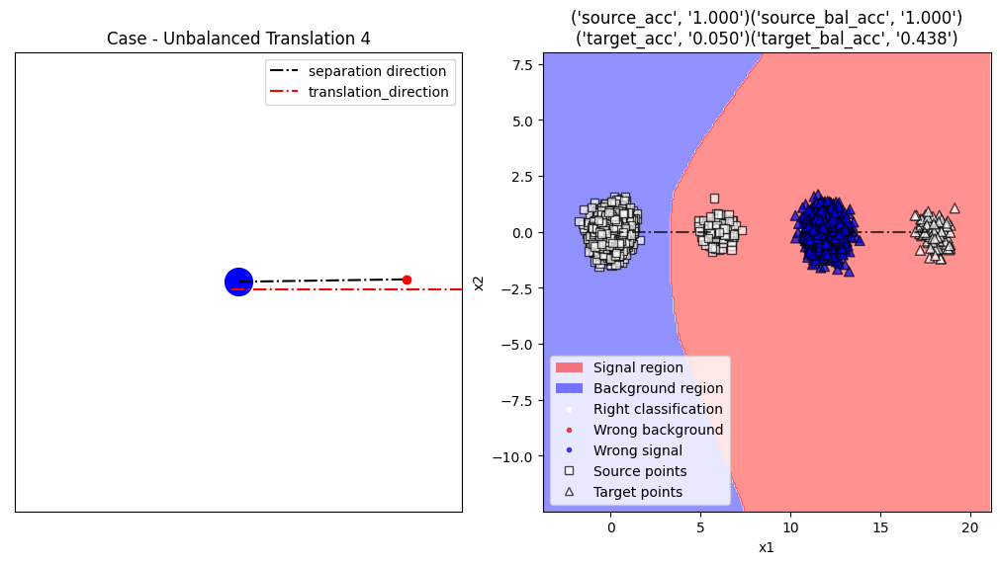

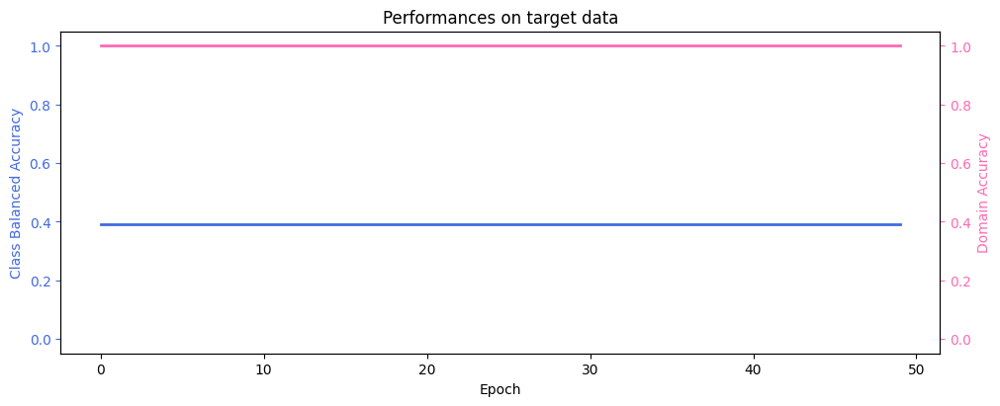

Results with  DANN_5
63/63 [==============================] - 0s 2ms/step


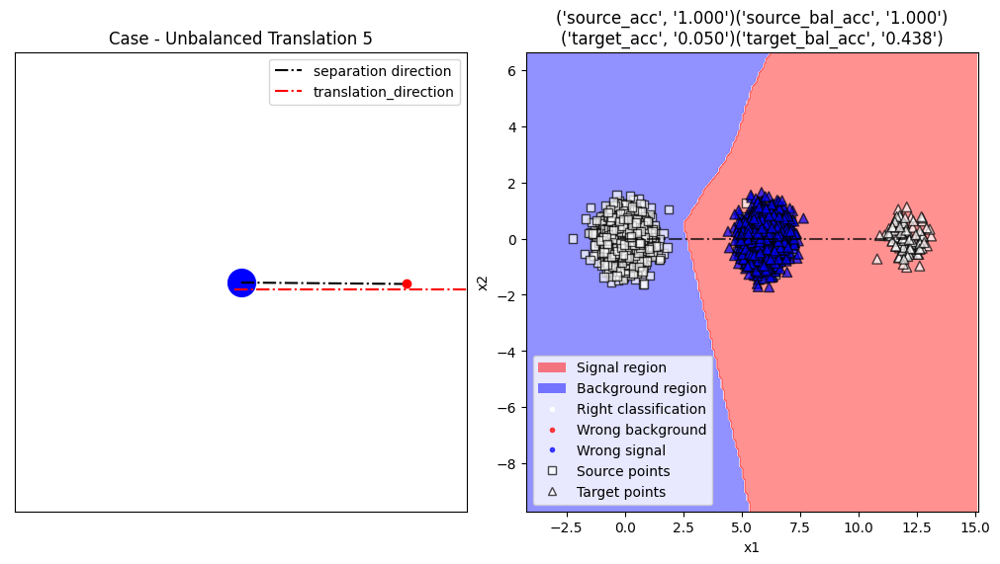

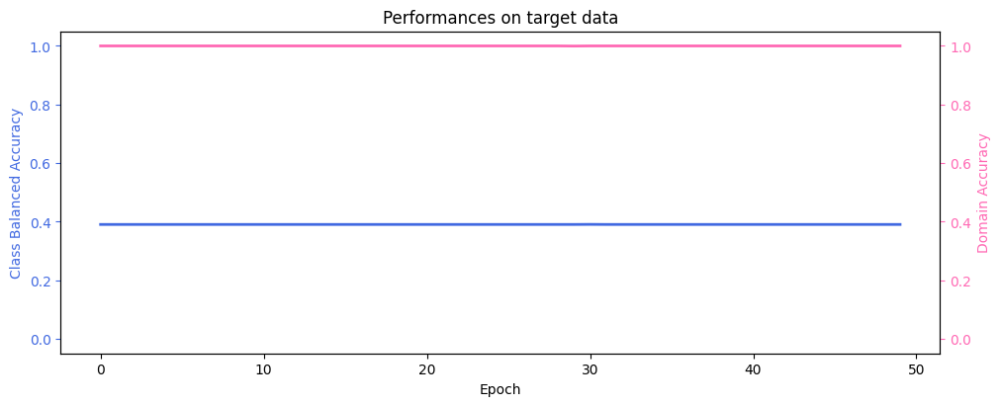

Results with  DANN_6
63/63 [==============================] - 0s 2ms/step


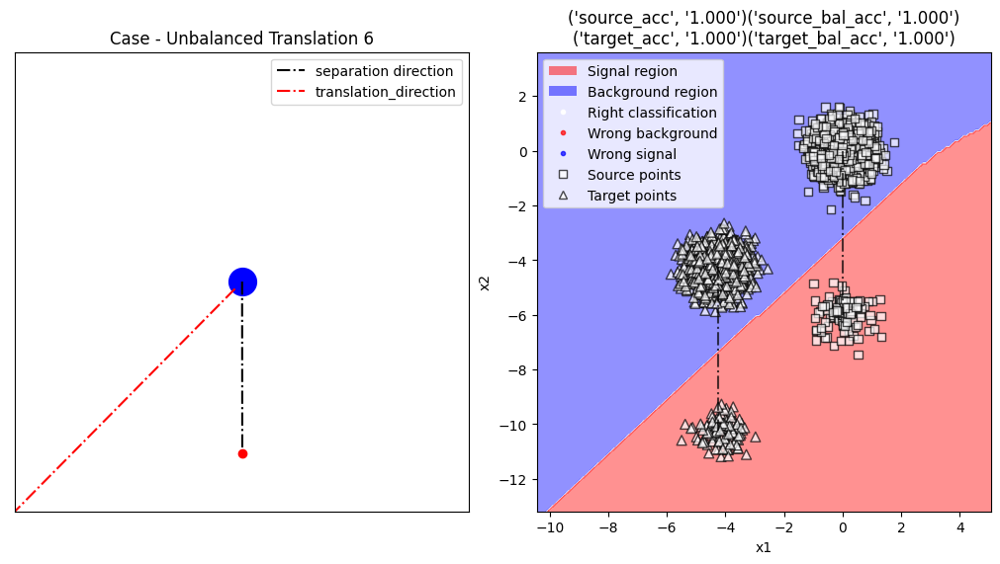

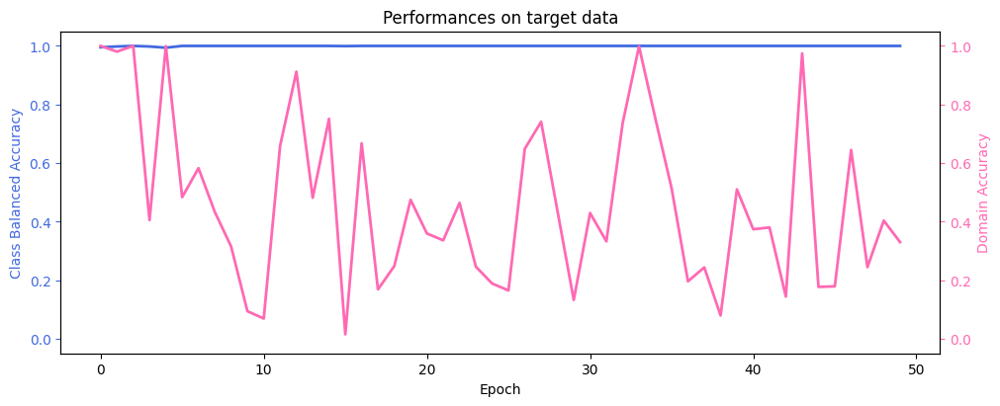

In [21]:
for i,data_pack in enumerate(zip(models,x_sources,y_sources,x_targets,y_targets,settings,histories)):

    # Unpack
    DANN_model,x_source,y_source,x_target,y_target,setting,history = data_pack
    print("Results with ", DANN_model.name)
    
    # Evaluate DANN
    results = evaluate_DANN(DANN_model,x_source, y_source, x_target, y_target)
    
    # Visualize DANN
    before_training = False # If True, true color of the points and no decision boundary. Prediction colors if False
    source_alpha = 0.7 # Opacity of source points
    target_alpha = 0.7 # Opacity of target points
    target_colors = True # Plot target points with meaningful colors if True and in grey if False
    regions_alpha = 0.5 # Opacity of prediction regions
    show_scores = True # Whether or not to show the title made of scores
    save_figure = True
    visualize_DANN_boundaries(DANN_model, x_source.values, y_source, x_target.values, y_target, setting, results, before_training, source_alpha, target_alpha, target_colors, regions_alpha, show_scores, save_figure)
    
    visualize_history(history)

# 3 - Translation + Scaling

## 3.1 - Generate Data

In [22]:
from data_loader import get_settings_from_json
from data_generator_all_systematics import DataGenerator

In [23]:
data_dir = "DANN_data/qualitative/Scaling"

In [24]:
data_gen_settings = get_settings_from_json('data_jsons/DANN_jsons/Scaling')
for index, settings in enumerate(data_gen_settings):
    data_gen = DataGenerator(settings_dict=settings)
    data_gen.generate_data()
    data_gen.save_data(directory=data_dir, file_index=index+1)
    

## 3.2 - Load Data

In [25]:
from data_io import load_data, show_data_statistics, write

In [26]:
train_sets, test_sets, settings = load_data(data_dir, load_settings=True)



###-------------------------------------###
### Data Loading
###-------------------------------------###

[*] data dir :  DANN_data/qualitative/Scaling
[*] train data dir :  DANN_data/qualitative/Scaling\train\data
[*] train labels dir :  DANN_data/qualitative/Scaling\train\labels
[*] test data dir :  DANN_data/qualitative/Scaling\test\data
[*] test labels dir :  DANN_data/qualitative/Scaling\test\labels
[*] settings dir :  DANN_data/qualitative/Scaling\settings
[+] train data dir found
[+] train labels dir found
[+] test data dir found
[+] test labels dir found
[+] settings dir found
[+] 6 train and test sets found
---------------------------------
[+] Train and Test data loaded!
---------------------------------




## 3.3 - Visualize Data

In [27]:
from visualize import visualize_data

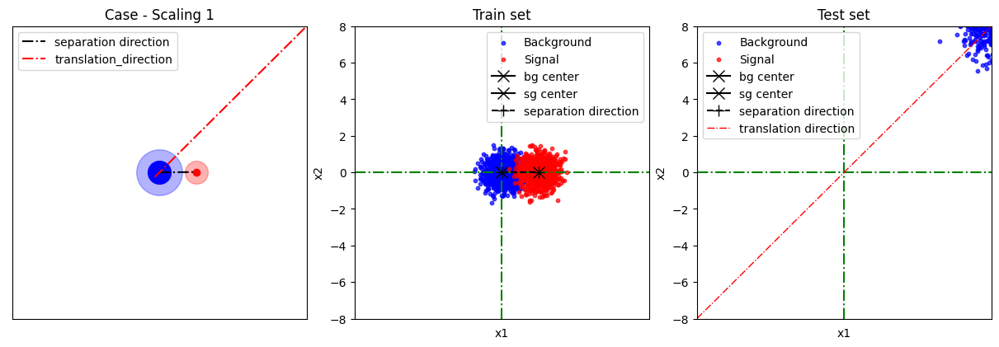

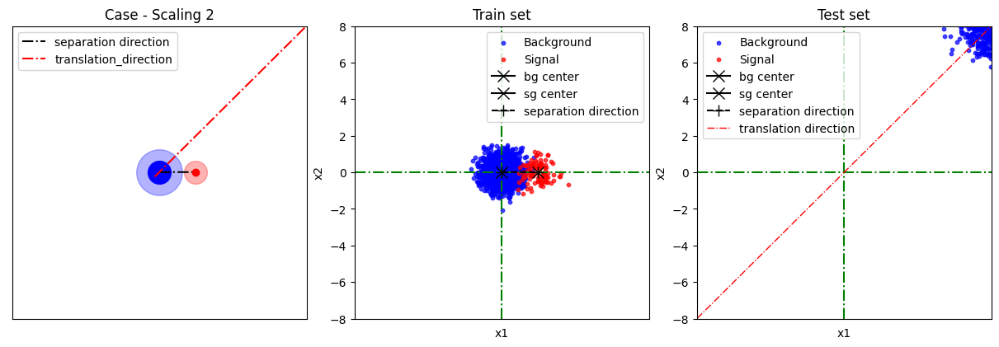

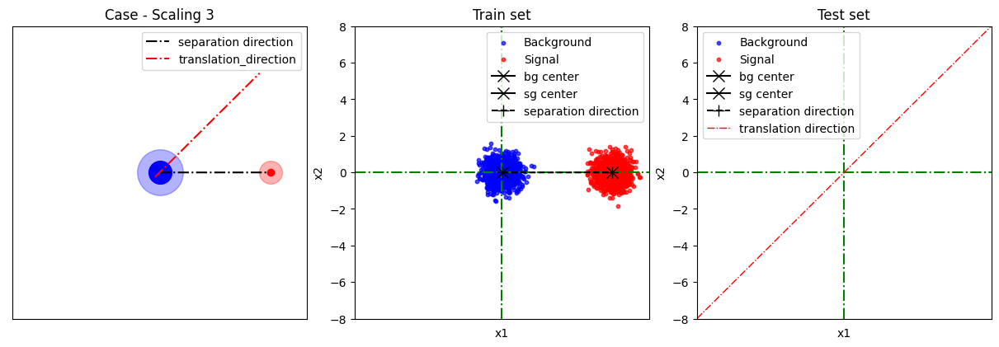

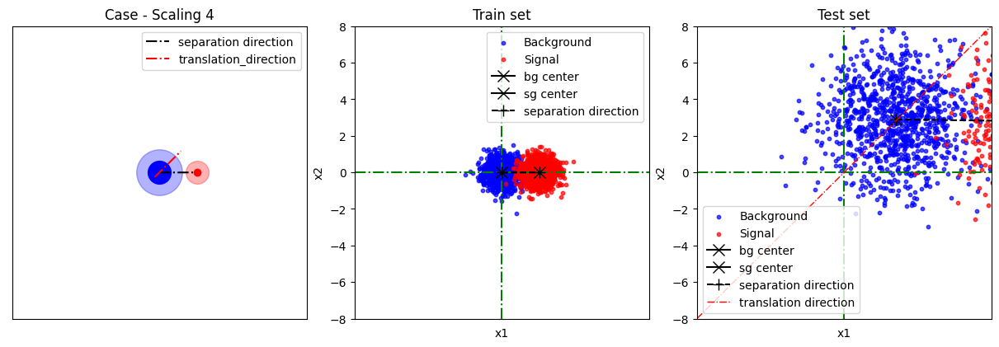

In [28]:
for index, _ in enumerate(train_sets):
    visualize_data(settings[index], train_sets[index], test_sets[index])
    if index == 3:
        break

## 3.4 - Set parameters for DANN

In [29]:
input_size  = (2,)
hp_lambda = 1.0
num_epochs  = 50
batch_size  = 20
# Becarefull that batch_size cannot be odd : if you set it to 25, each training batch will actualy be of size 24 
# and some samples will not be used at each epoch. 
# The reason for this is that training batches are made of the same number of source and target points 
nums_source_samples = [train_set["labels"].shape[0] for train_set in train_sets]

nums_target_samples = [test_set["labels"].shape[0] for test_set in test_sets]
nums_train_steps_per_epoch = [math.ceil((num_source_samples+num_target_samples)/batch_size) for num_source_samples,num_target_samples in zip(nums_source_samples,nums_target_samples)]
nums_test_steps_per_epoch = [math.ceil(num_target_samples/batch_size) for num_target_samples in nums_target_samples]

## 3.5 - Prepare data for DANN

In [30]:
from DANN import set_data_for_DANN,build_datasets_for_DANN

In [31]:
x_sources, y_sources, x_targets, y_targets = set_data_for_DANN (train_sets,test_sets)

In [32]:
training_datasets, testing_datasets = build_datasets_for_DANN (x_sources,y_sources,x_targets,y_targets,num_epochs, batch_size, portion_of_target_for_train=1)

## 3.6 - Use DANN

In [33]:
from DANN import (build_DANN,
                  compile_DANN,
                  fit_DANN,
                  evaluate_DANN)
from visualize import (visualize_DANN_boundaries,
                       visualize_history)

In [34]:
models = []
histories = []
for i,data_pack in enumerate(zip(training_datasets,testing_datasets,settings,nums_train_steps_per_epoch,nums_test_steps_per_epoch)):

    # Unpack
    training_dataset,testing_dataset,setting,num_train_steps_per_epoch,num_test_steps_per_epoch = data_pack
    
    # Build DANN
    DANN_model = build_DANN("DANN_"+str(i+1),input_size,hp_lambda)
    print("Started to work with", DANN_model.name)
    
    # Compile DANN
    compile_DANN(DANN_model)
    
    # Fit DANN
    history = fit_DANN(DANN_model,training_dataset,testing_dataset,num_epochs,num_train_steps_per_epoch,num_test_steps_per_epoch)
    models.append(DANN_model)
    histories.append(history)
    
    # Stop
    if i == 3 :
        break

Started to work with DANN_1
Started to work with DANN_2
Started to work with DANN_3
Started to work with DANN_4


Results with  DANN_1
63/63 [==============================] - 0s 2ms/step


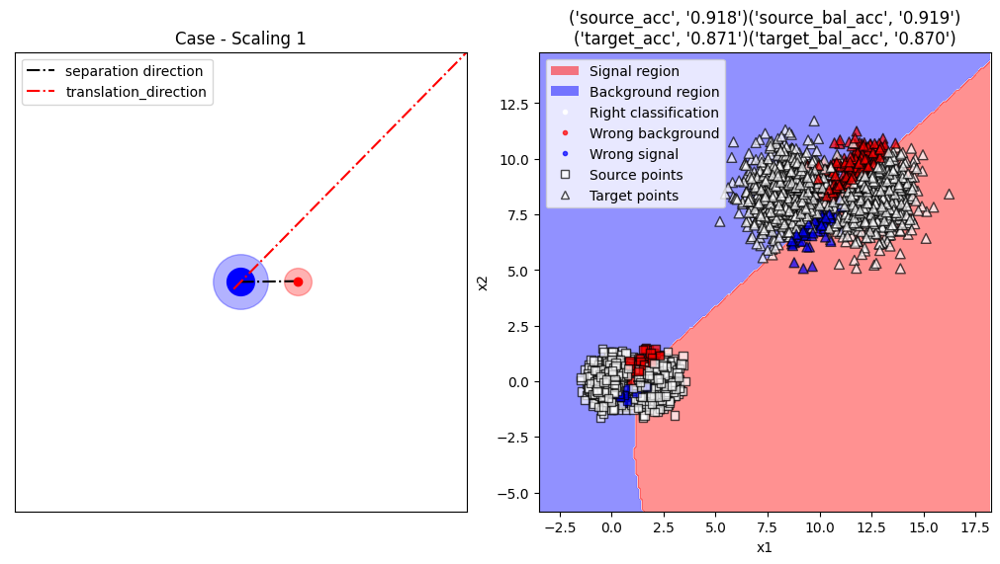

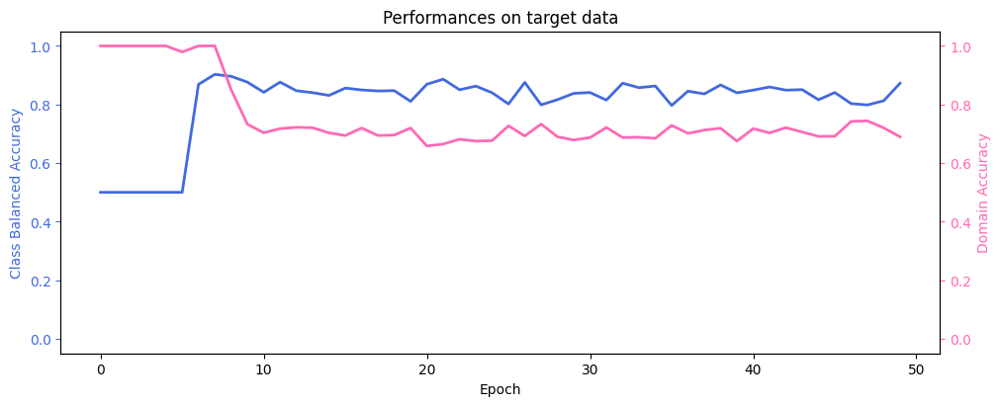

Results with  DANN_2
63/63 [==============================] - 0s 2ms/step


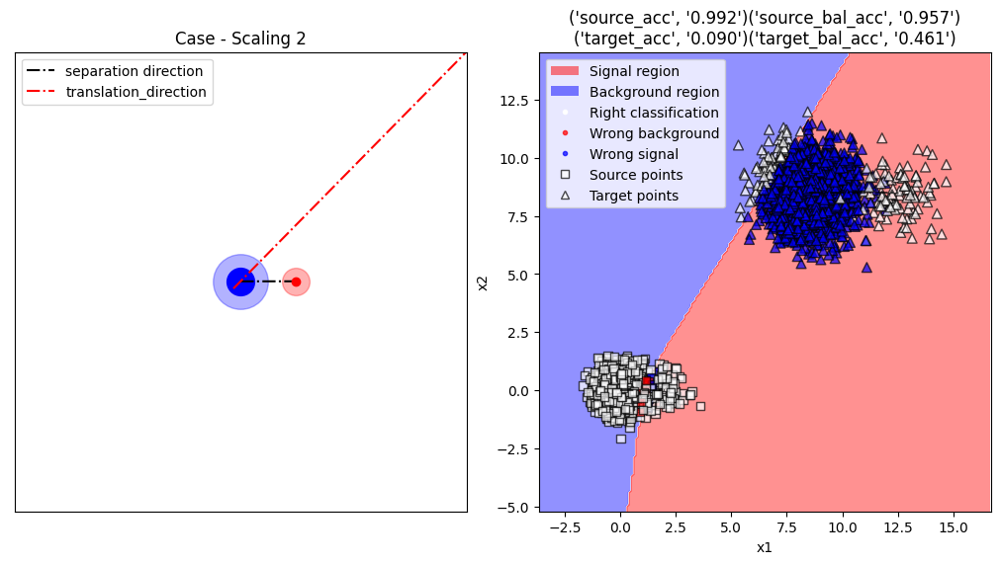

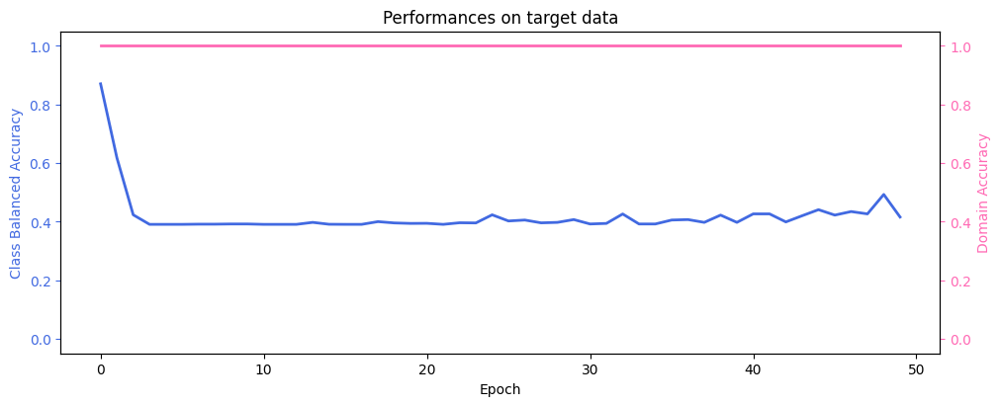

Results with  DANN_3
63/63 [==============================] - 0s 2ms/step


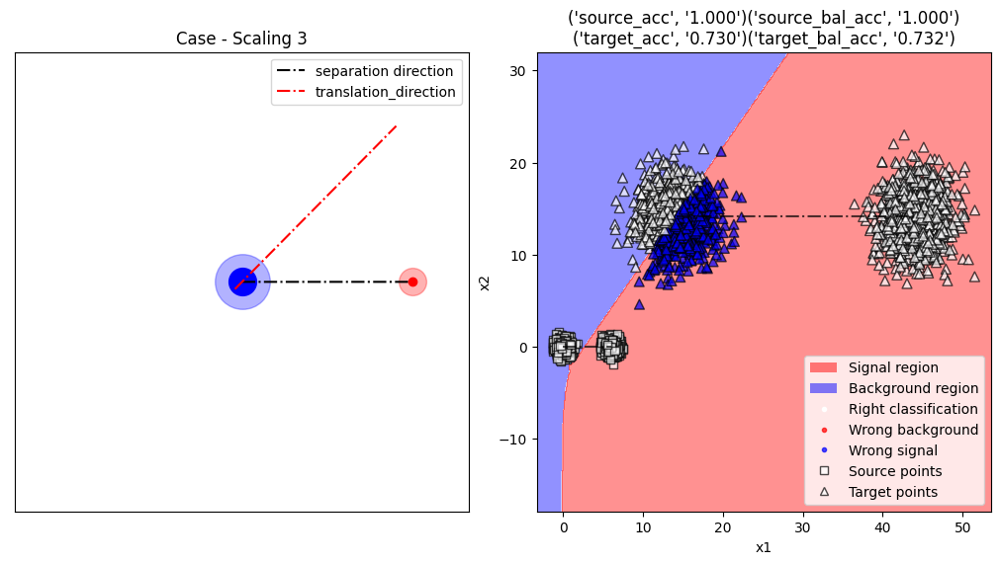

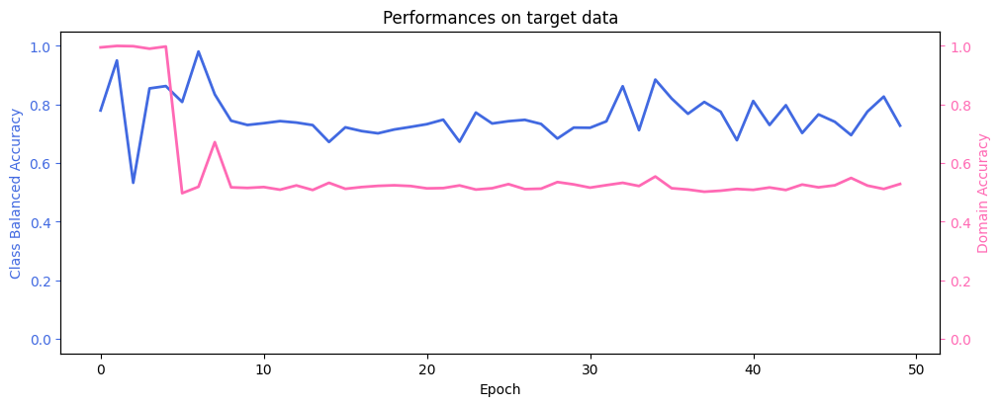

Results with  DANN_4
63/63 [==============================] - 0s 2ms/step


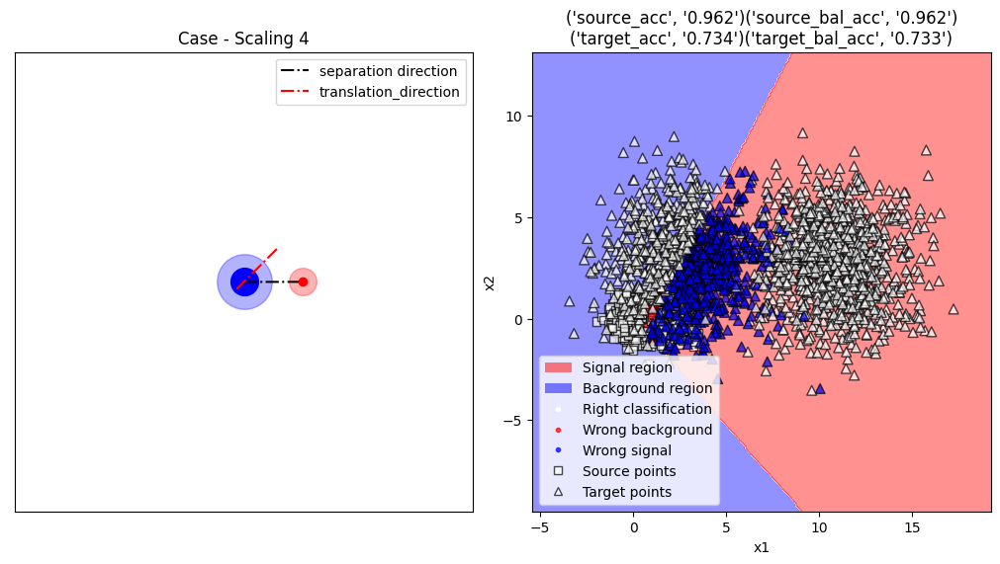

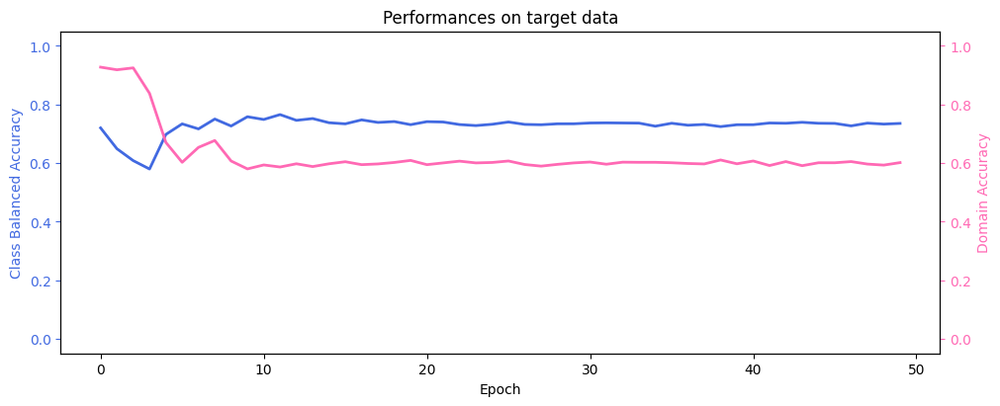

In [35]:
for i,data_pack in enumerate(zip(models,x_sources,y_sources,x_targets,y_targets,settings,histories)):

    # Unpack
    DANN_model,x_source,y_source,x_target,y_target,setting,history = data_pack
    print("Results with ", DANN_model.name)
    
    # Evaluate DANN
    results = evaluate_DANN(DANN_model,x_source, y_source, x_target, y_target)
    
    # Visualize DANN
    before_training = False # If True, true color of the points and no decision boundary. Prediction colors if False
    source_alpha = 0.7 # Opacity of source points
    target_alpha = 0.7 # Opacity of target points
    target_colors = True # Plot target points with meaningful colors if True and in grey if False
    regions_alpha = 0.5 # Opacity of prediction regions
    show_scores = True # Whether or not to show the title made of scores
    save_figure = True
    visualize_DANN_boundaries(DANN_model, x_source.values, y_source, x_target.values, y_target, setting, results, before_training, source_alpha, target_alpha, target_colors, regions_alpha, show_scores, save_figure)
    
    visualize_history(history)
    
    # Stop
    if i == 3 : 
        break

Remarks for better performances :
- Scaling 1 : bigger lambda, more epochs or more complex model
- Scaling 2 : use class weights to mitigate class imbalance
- Scaling 3 : bigger lambda, more epochs or more complex model
- Scaling 4 : bigger lambda, more epochs or more complex model

# 4 - Translation + Rotation

## 4.1 - Generate Data

In [36]:
from data_loader import get_settings_from_json
from data_generator_all_systematics import DataGenerator

In [37]:
data_dir = "DANN_data/qualitative/Rotation"

In [38]:
data_gen_settings = get_settings_from_json('data_jsons/DANN_jsons/Rotation')
for index, settings in enumerate(data_gen_settings):
    data_gen = DataGenerator(settings_dict=settings)
    data_gen.generate_data()
    data_gen.save_data(directory=data_dir, file_index=index+1)
    

## 4.2 - Load Data

In [39]:
from data_io import load_data, show_data_statistics, write

In [40]:
train_sets, test_sets, settings = load_data(data_dir, load_settings=True)



###-------------------------------------###
### Data Loading
###-------------------------------------###

[*] data dir :  DANN_data/qualitative/Rotation
[*] train data dir :  DANN_data/qualitative/Rotation\train\data
[*] train labels dir :  DANN_data/qualitative/Rotation\train\labels
[*] test data dir :  DANN_data/qualitative/Rotation\test\data
[*] test labels dir :  DANN_data/qualitative/Rotation\test\labels
[*] settings dir :  DANN_data/qualitative/Rotation\settings
[+] train data dir found
[+] train labels dir found
[+] test data dir found
[+] test labels dir found
[+] settings dir found
[+] 6 train and test sets found
---------------------------------
[+] Train and Test data loaded!
---------------------------------




## 4.3 - Visualize Data

In [41]:
from visualize import visualize_data

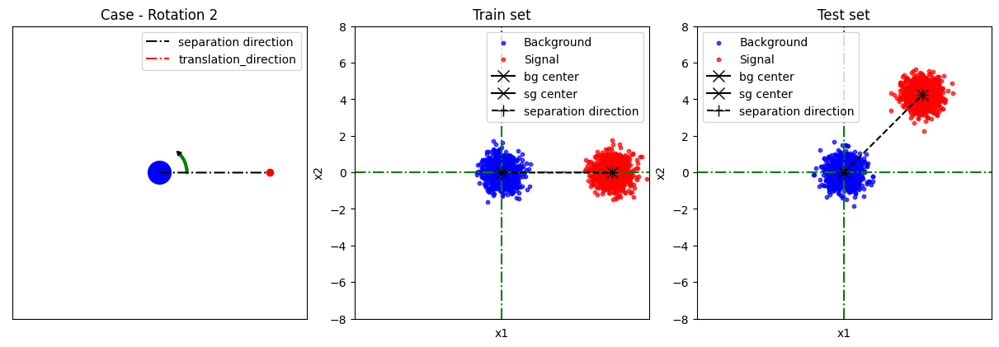

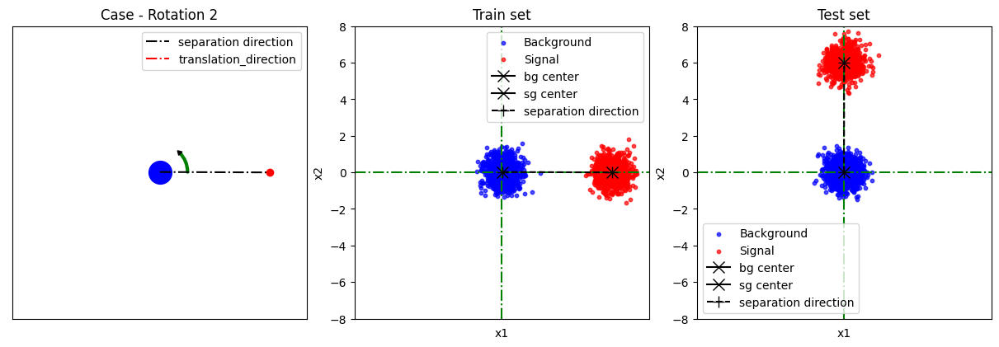

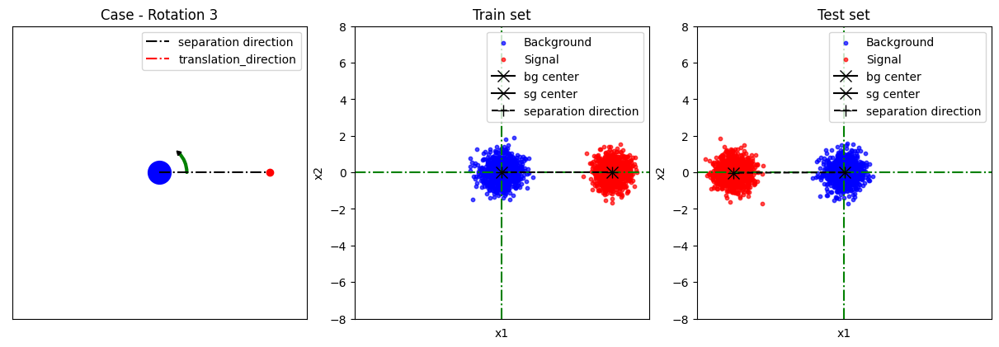

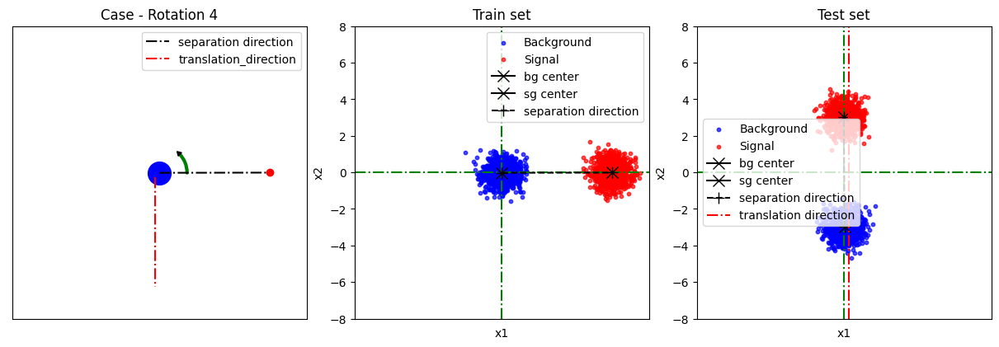

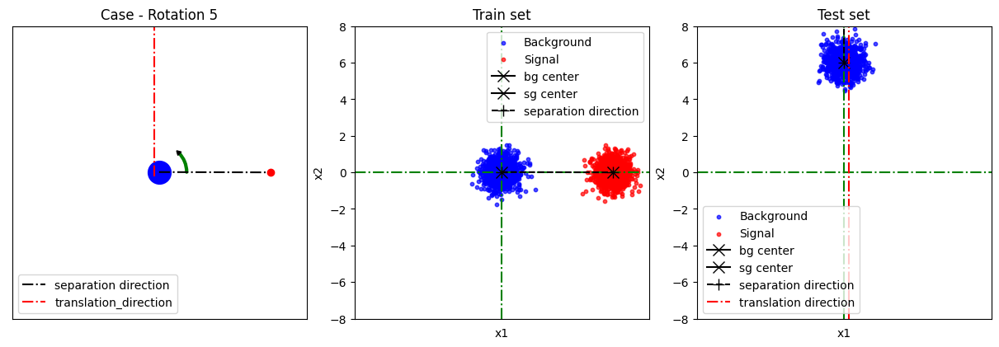

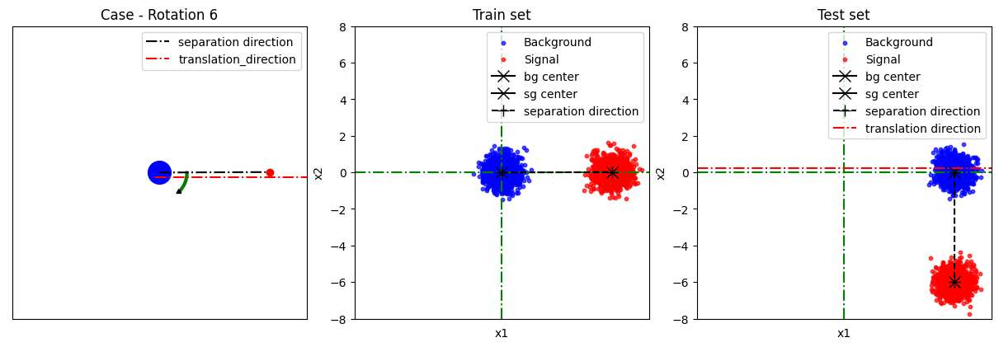

In [42]:
for index, _ in enumerate(train_sets):
    visualize_data(settings[index], train_sets[index], test_sets[index])

## 4.4 - Set parameters for DANN

In [43]:
input_size  = (2,)
hp_lambda = 1.0
num_epochs  = 50
batch_size  = 20
# Becarefull that batch_size cannot be odd : if you set it to 25, each training batch will actualy be of size 24 
# and some samples will not be used at each epoch. 
# The reason for this is that training batches are made of the same number of source and target points 
nums_source_samples = [train_set["labels"].shape[0] for train_set in train_sets]

nums_target_samples = [test_set["labels"].shape[0] for test_set in test_sets]
nums_train_steps_per_epoch = [math.ceil((num_source_samples+num_target_samples)/batch_size) for num_source_samples,num_target_samples in zip(nums_source_samples,nums_target_samples)]
nums_test_steps_per_epoch = [math.ceil(num_target_samples/batch_size) for num_target_samples in nums_target_samples]

## 4.5 - Prepare data for DANN

In [44]:
from DANN import set_data_for_DANN,build_datasets_for_DANN

In [45]:
x_sources, y_sources, x_targets, y_targets = set_data_for_DANN (train_sets,test_sets)

In [46]:
training_datasets, testing_datasets = build_datasets_for_DANN (x_sources,y_sources,x_targets,y_targets,num_epochs, batch_size, portion_of_target_for_train=1)

## 4.6 - Use DANN

In [47]:
from DANN import (build_DANN,
                  compile_DANN,
                  fit_DANN,
                  evaluate_DANN)
from visualize import (visualize_DANN_boundaries,
                       visualize_history)

In [48]:
models = []
histories = []
for i,data_pack in enumerate(zip(training_datasets,testing_datasets,settings,nums_train_steps_per_epoch,nums_test_steps_per_epoch)):

    # Unpack
    training_dataset,testing_dataset,setting,num_train_steps_per_epoch,num_test_steps_per_epoch = data_pack
    
    # Build DANN
    DANN_model = build_DANN("DANN_"+str(i+1),input_size,hp_lambda)
    print("Started to work with", DANN_model.name)
    
    # Compile DANN
    compile_DANN(DANN_model)
    
    # Fit DANN
    history = fit_DANN(DANN_model,training_dataset,testing_dataset,num_epochs,num_train_steps_per_epoch,num_test_steps_per_epoch)
    models.append(DANN_model)
    histories.append(history)

Started to work with DANN_1
Started to work with DANN_2
Started to work with DANN_3
Started to work with DANN_4
Started to work with DANN_5
Started to work with DANN_6


Results with  DANN_1
63/63 [==============================] - 0s 2ms/step


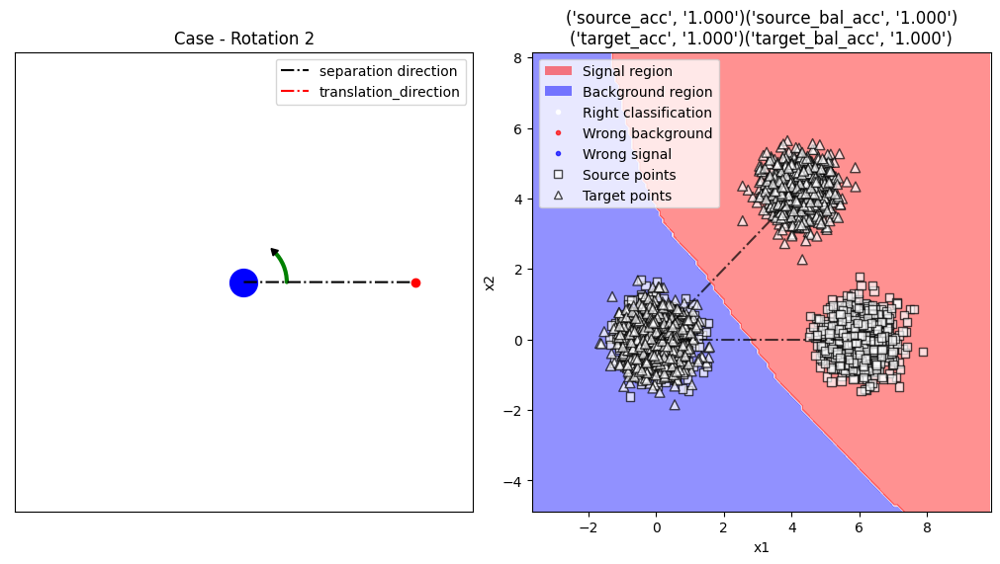

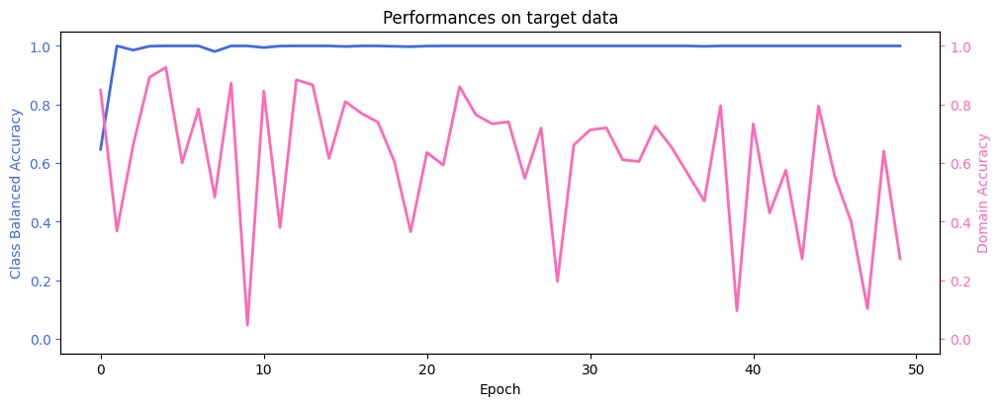

Results with  DANN_2
63/63 [==============================] - 0s 2ms/step


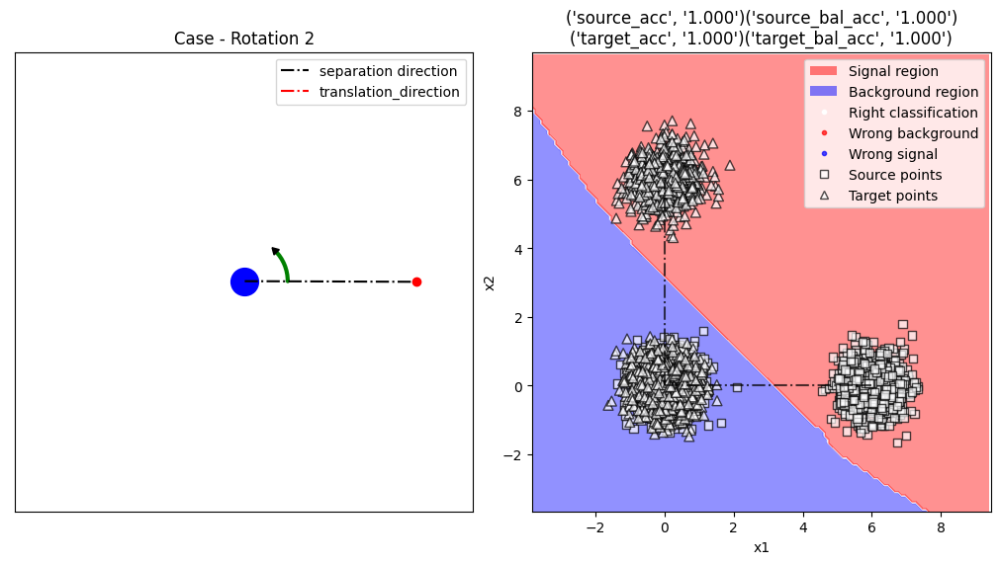

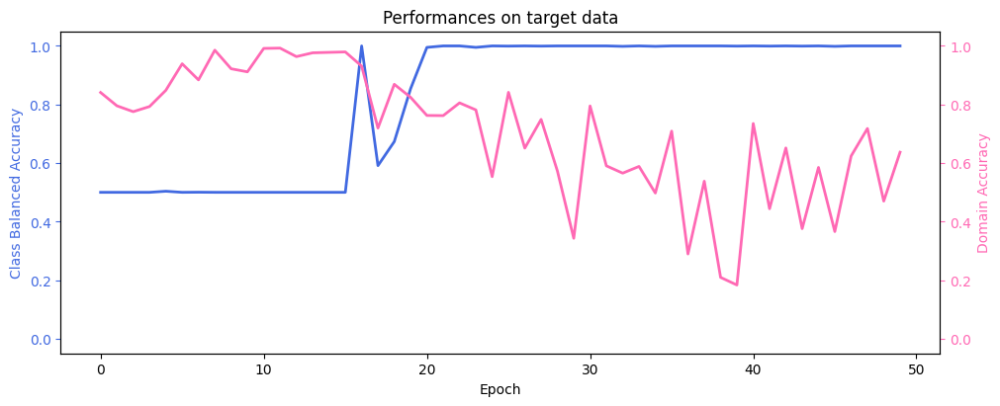

Results with  DANN_3
63/63 [==============================] - 0s 2ms/step


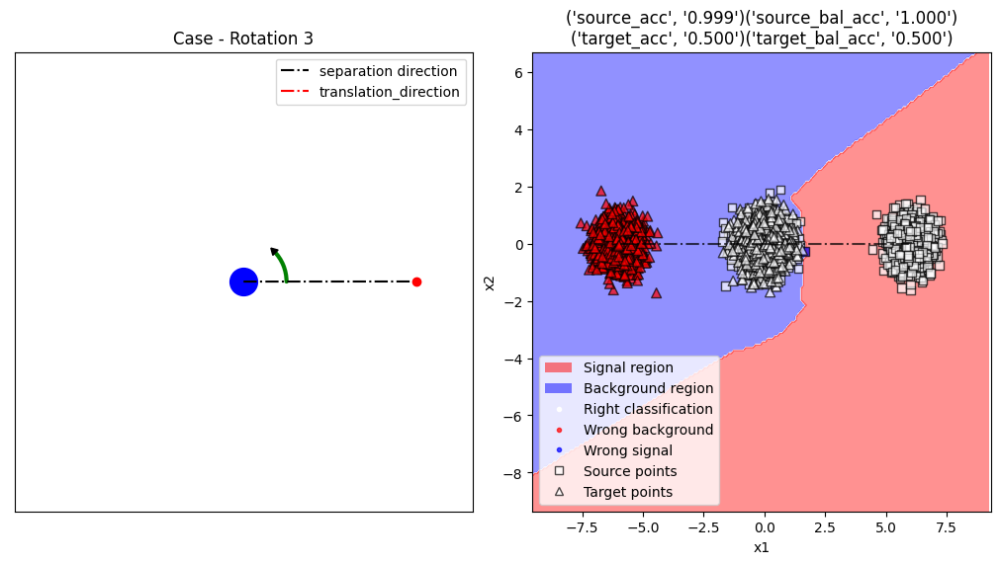

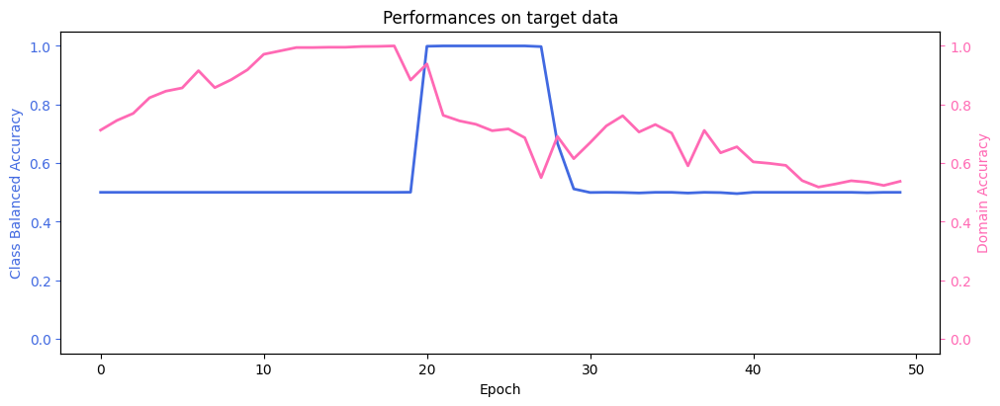

Results with  DANN_4
63/63 [==============================] - 0s 2ms/step


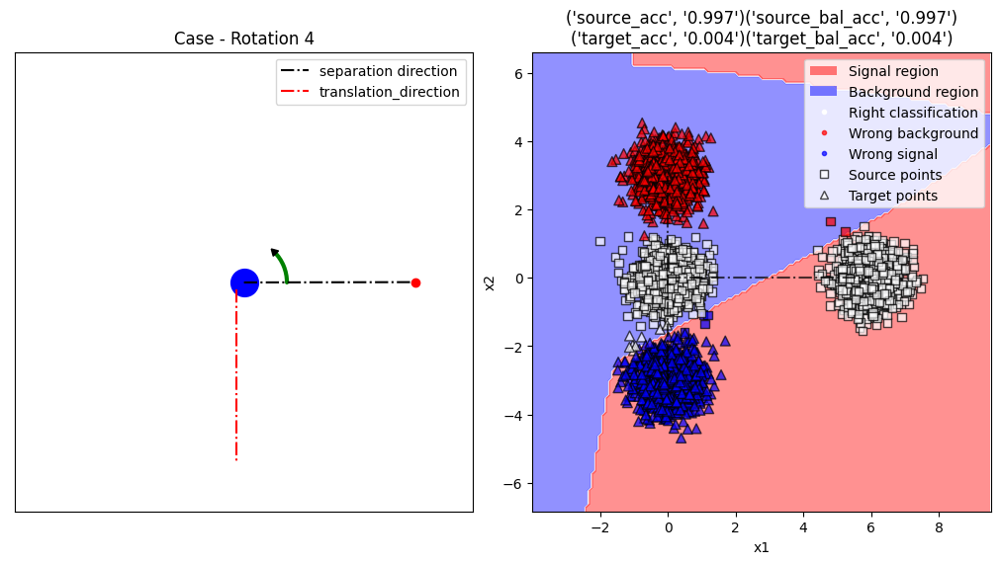

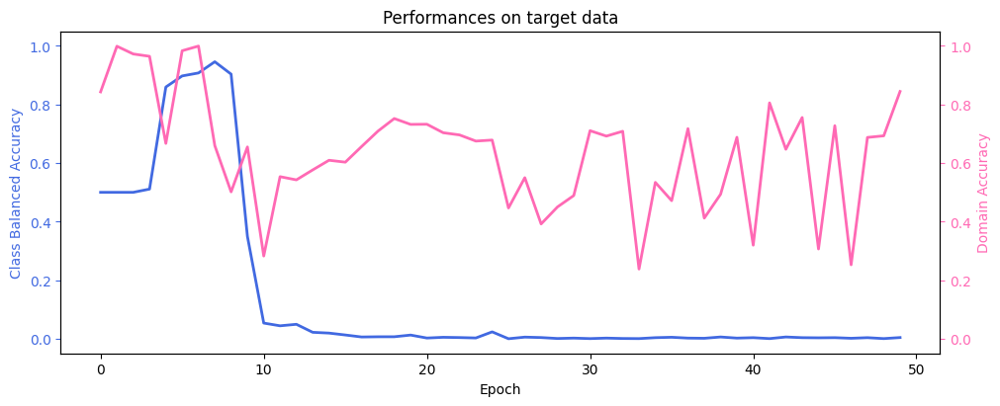

Results with  DANN_5
63/63 [==============================] - 0s 2ms/step


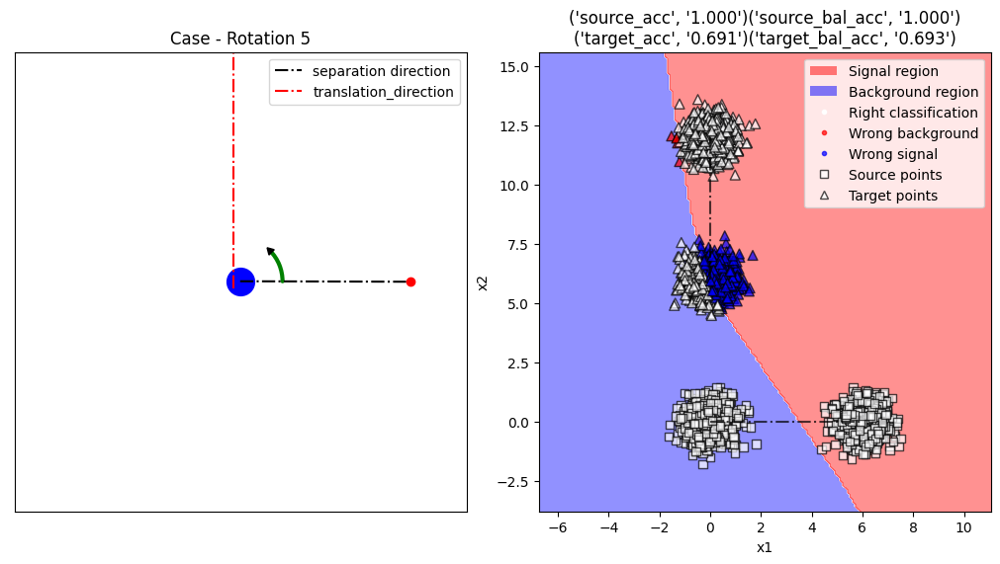

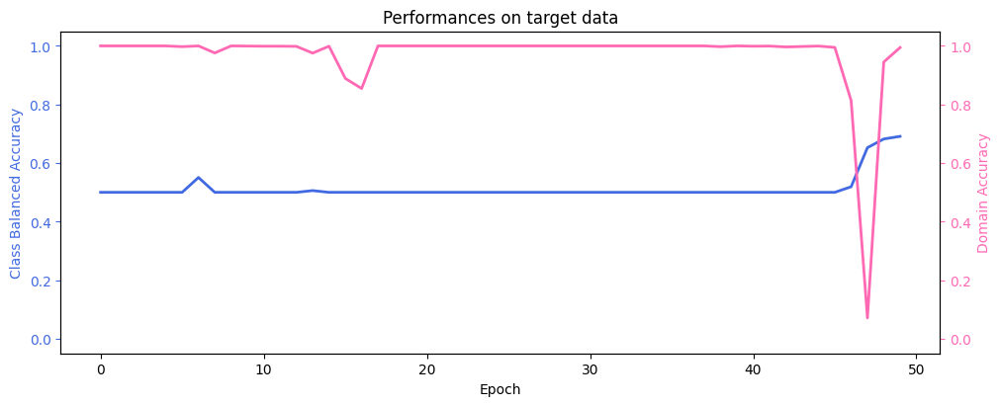

Results with  DANN_6
63/63 [==============================] - 0s 3ms/step


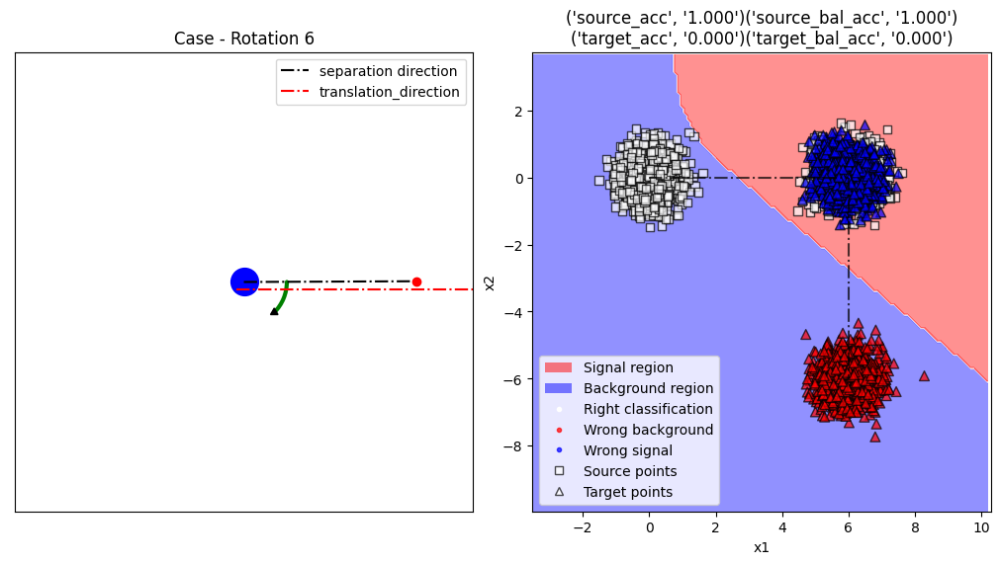

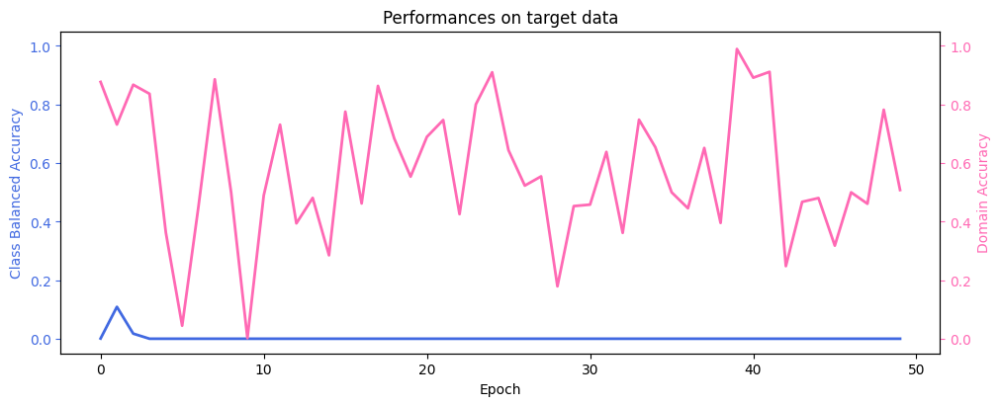

In [49]:
for i,data_pack in enumerate(zip(models,x_sources,y_sources,x_targets,y_targets,settings,histories)):

    # Unpack
    DANN_model,x_source,y_source,x_target,y_target,setting,history = data_pack
    print("Results with ", DANN_model.name)
    
    # Evaluate DANN
    results = evaluate_DANN(DANN_model,x_source, y_source, x_target, y_target)
    
    # Visualize DANN
    before_training = False # If True, true color of the points and no decision boundary. Prediction colors if False
    source_alpha = 0.7 # Opacity of source points
    target_alpha = 0.7 # Opacity of target points
    target_colors = True # Plot target points with meaningful colors if True and in grey if False
    regions_alpha = 0.5 # Opacity of prediction regions
    show_scores = True # Whether or not to show the title made of scores
    save_figure = True
    visualize_DANN_boundaries(DANN_model, x_source.values, y_source, x_target.values, y_target, setting, results, before_training, source_alpha, target_alpha, target_colors, regions_alpha, show_scores, save_figure)
    
    visualize_history(history)

Remarks for better performances :
- Rotation 1 :
- Rotation 2 : 
- Rotation 3 : more complex model, bending problem
- Rotation 4 : bigger lambda, more complex model, bending problem
- Rotation 5 : bigger lambda, more complex model, bending problem
- Rotation 6 : there is nothing to do. This is an intrinsic limitation of DANN. It guides the decision boundary in the direction of the target domain but since it doesn't access target labels, it has no idea that the classification on target domain is wrong.

# 5 - Translation + Boxing

Available soon

# 6 - All systematics normal Gaussian

## 6.1 - Generate Data

In [50]:
from data_loader import get_settings_from_json
from data_generator_all_systematics import DataGenerator

In [51]:
data_dir = "DANN_data/qualitative/all_systematics_normal_gaussian"

In [52]:
data_gen_settings = get_settings_from_json('data_jsons/all_systematics_normal_gaussian')
for index, settings in enumerate(data_gen_settings):
    data_gen = DataGenerator(settings_dict=settings)
    data_gen.generate_data()
    data_gen.save_data(directory=data_dir, file_index=index+1)
    

## 6.2 - Load Data

In [53]:
from data_io import load_data, show_data_statistics, write

In [54]:
train_sets, test_sets, settings = load_data(data_dir, load_settings=True)



###-------------------------------------###
### Data Loading
###-------------------------------------###

[*] data dir :  DANN_data/qualitative/all_systematics_normal_gaussian
[*] train data dir :  DANN_data/qualitative/all_systematics_normal_gaussian\train\data
[*] train labels dir :  DANN_data/qualitative/all_systematics_normal_gaussian\train\labels
[*] test data dir :  DANN_data/qualitative/all_systematics_normal_gaussian\test\data
[*] test labels dir :  DANN_data/qualitative/all_systematics_normal_gaussian\test\labels
[*] settings dir :  DANN_data/qualitative/all_systematics_normal_gaussian\settings
[+] train data dir found
[+] train labels dir found
[+] test data dir found
[+] test labels dir found
[+] settings dir found
[+] 12 train and test sets found
---------------------------------
[+] Train and Test data loaded!
---------------------------------




## 6.3 - Visualize Data

In [55]:
from visualize import visualize_data

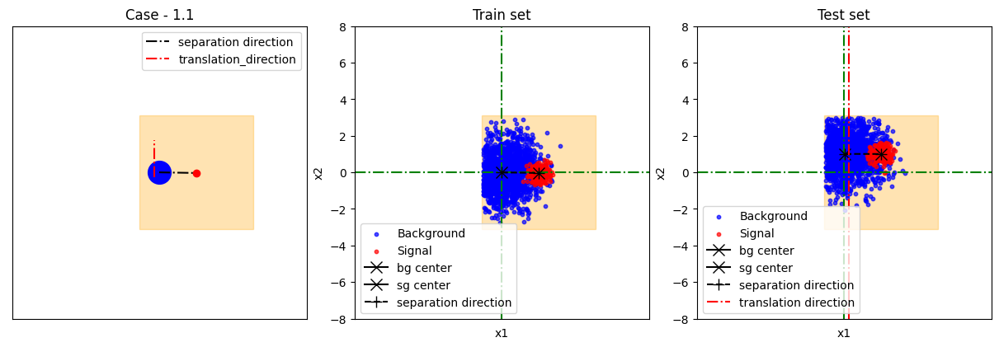

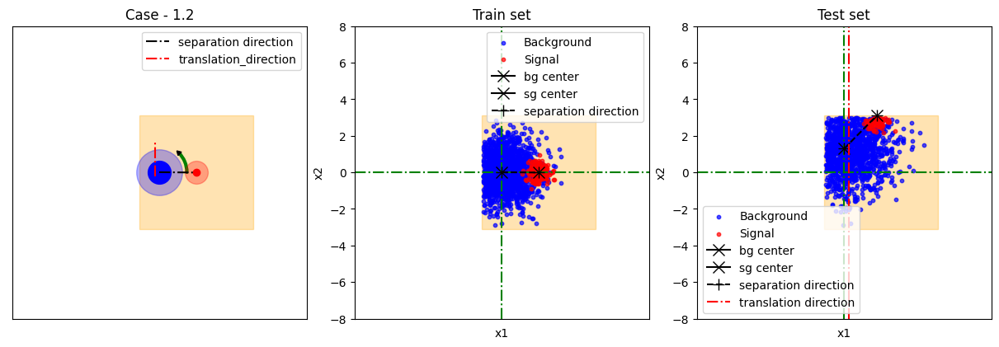

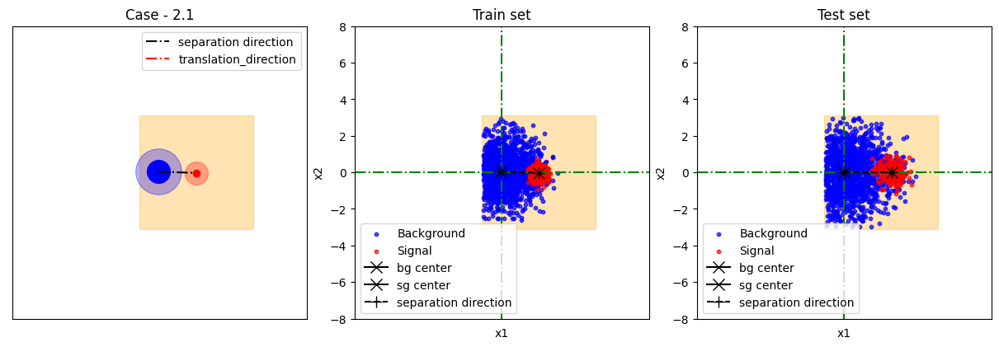

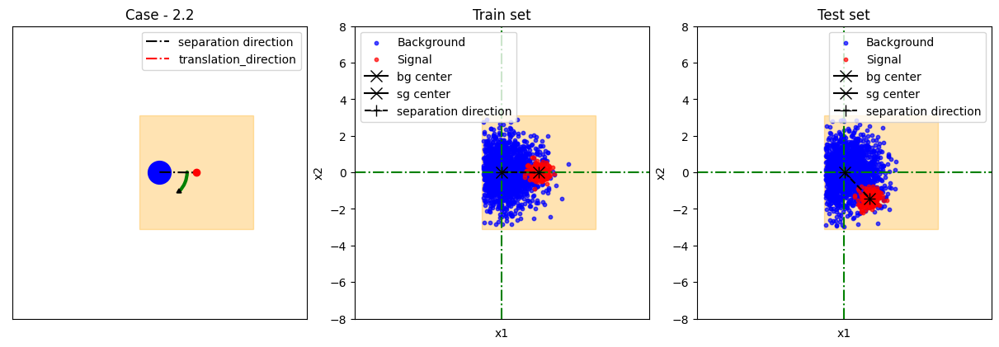

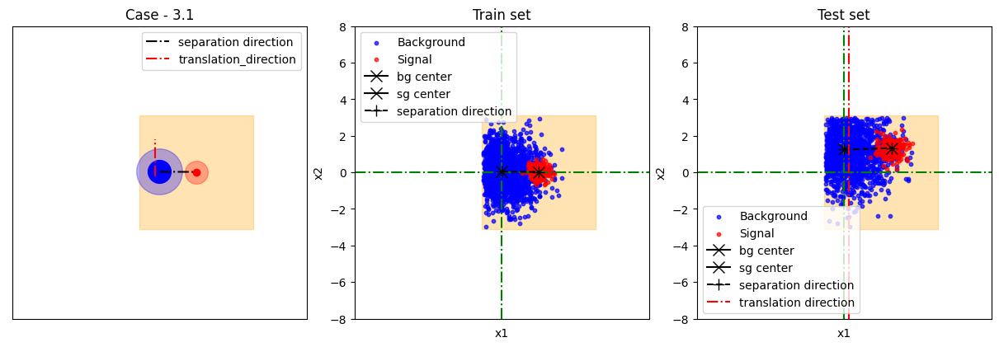

...

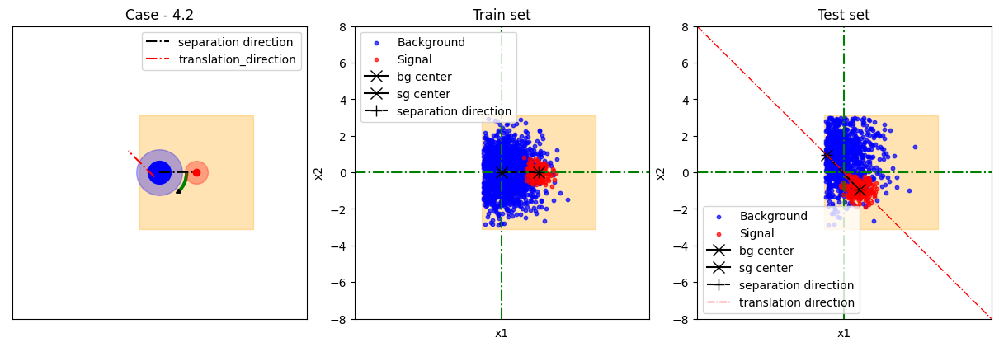

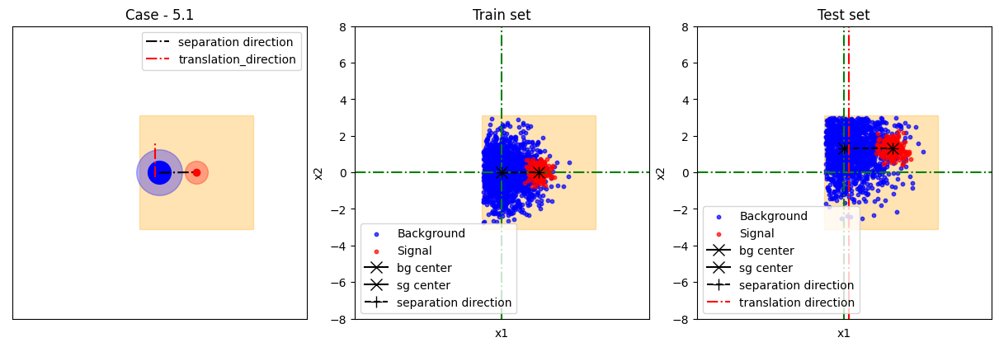

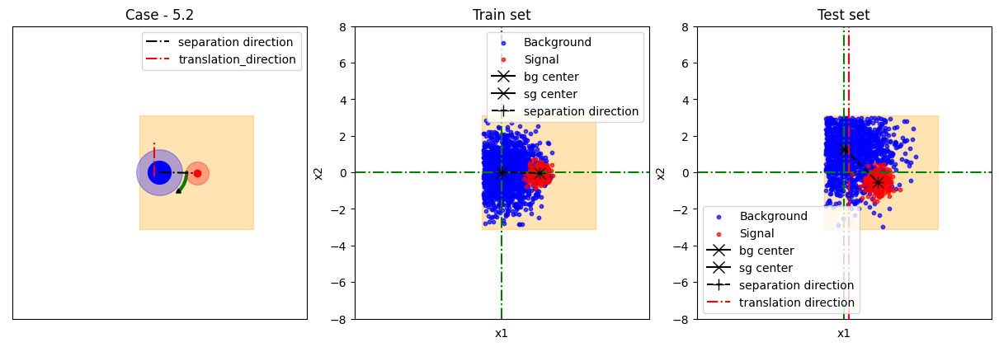

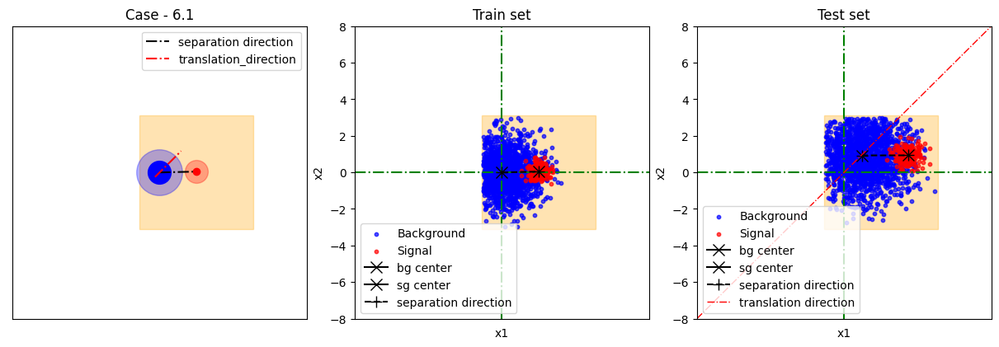

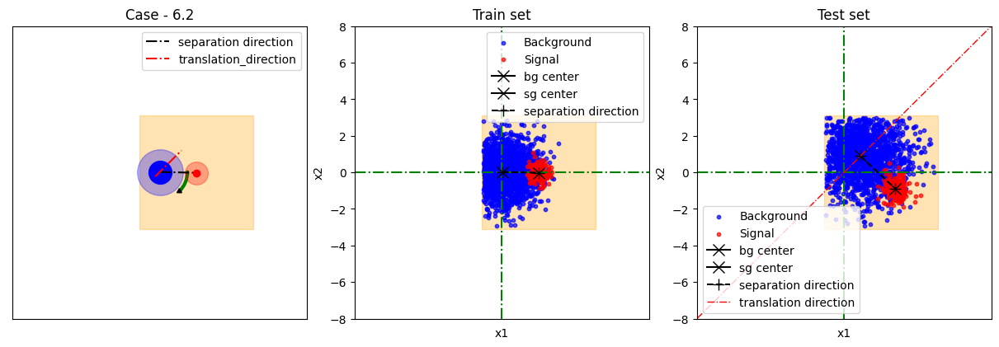

In [56]:
for index, _ in enumerate(train_sets):
    visualize_data(settings[index], train_sets[index], test_sets[index])
    #if index == 0:
    #    break

## 6.4 - Set parameters for DANN

In [57]:
input_size  = (2,)
hp_lambda = 1.0
num_epochs  = 50
batch_size  = 20
class_weights = [1,9]
# Becarefull that batch_size cannot be odd : if you set it to 25, each training batch will actualy be of size 24 
# and some samples will not be used at each epoch. 
# The reason for this is that training batches are made of the same number of source and target points 
nums_source_samples = [train_set["labels"].shape[0] for train_set in train_sets]

nums_target_samples = [test_set["labels"].shape[0] for test_set in test_sets]
nums_train_steps_per_epoch = [math.ceil((num_source_samples+num_target_samples)/batch_size) for num_source_samples,num_target_samples in zip(nums_source_samples,nums_target_samples)]
nums_test_steps_per_epoch = [math.ceil(num_target_samples/batch_size) for num_target_samples in nums_target_samples]

## 6.5 - Prepare data for DANN

In [58]:
from DANN import set_data_for_DANN,build_datasets_for_DANN

In [59]:
x_sources, y_sources, x_targets, y_targets = set_data_for_DANN (train_sets,test_sets)

In [60]:
training_datasets, testing_datasets = build_datasets_for_DANN (x_sources,y_sources,x_targets,y_targets,num_epochs, batch_size, portion_of_target_for_train=1)

## 6.6 - Use DANN

In [61]:
from DANN import (build_DANN,
                  compile_DANN,
                  fit_DANN,
                  evaluate_DANN)
from visualize import visualize_DANN_boundaries

In [62]:
models = []
histories = []
for i,data_pack in enumerate(zip(training_datasets,testing_datasets,settings,nums_train_steps_per_epoch,nums_test_steps_per_epoch)):

    # Unpack
    training_dataset,testing_dataset,setting,num_train_steps_per_epoch,num_test_steps_per_epoch = data_pack
    
    # Build DANN
    DANN_model = build_DANN("DANN_"+str(i+1),input_size,hp_lambda)
    print("Started to work with", DANN_model.name)
    
    # Compile DANN
    compile_DANN(DANN_model,class_weights)
    
    # Fit DANN
    history = fit_DANN(DANN_model,training_dataset,testing_dataset,num_epochs,num_train_steps_per_epoch,num_test_steps_per_epoch)
    models.append(DANN_model)
    histories.append(history)

Started to work with DANN_1
Started to work with DANN_2
Started to work with DANN_3
Started to work with DANN_4
Started to work with DANN_5
Started to work with DANN_6
Started to work with DANN_7
Started to work with DANN_8
Started to work with DANN_9
Started to work with DANN_10
Started to work with DANN_11
Started to work with DANN_12


Results with  DANN_1
54/54 [==============================] - 0s 2ms/step


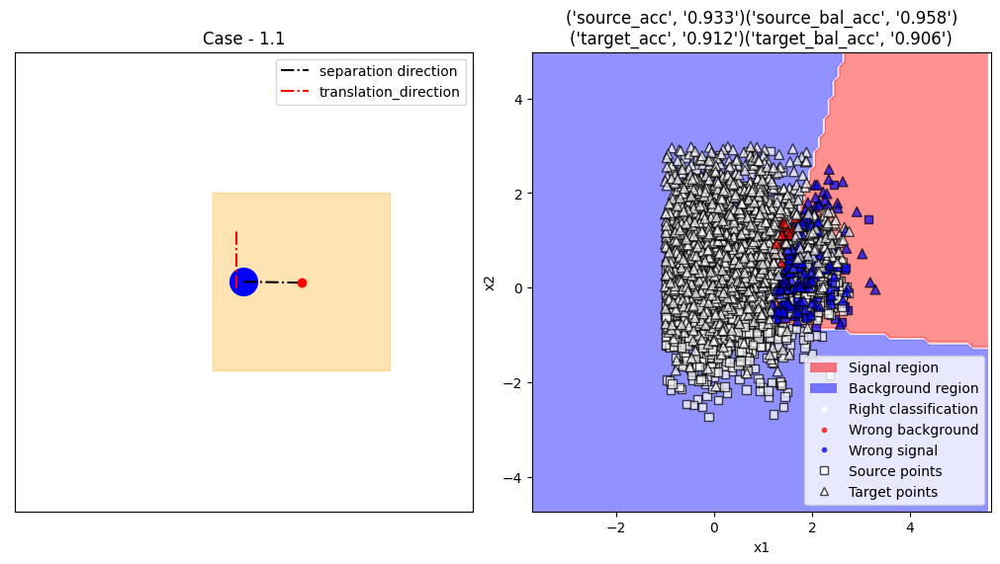

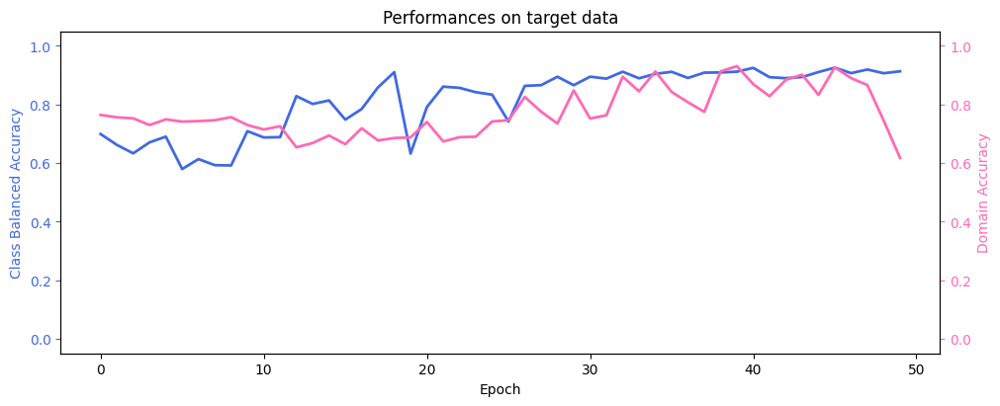

Results with  DANN_2
43/43 [==============================] - 0s 2ms/step


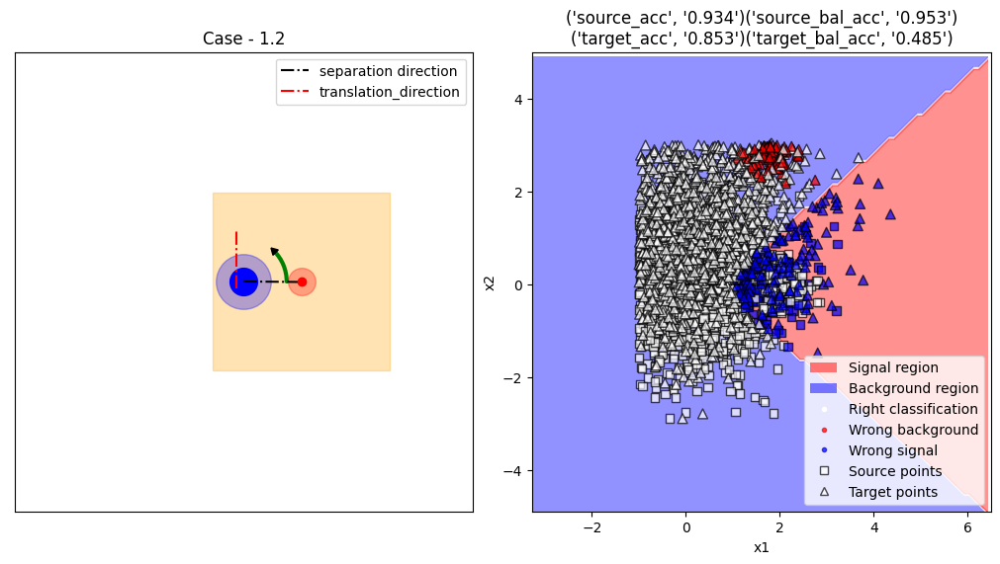

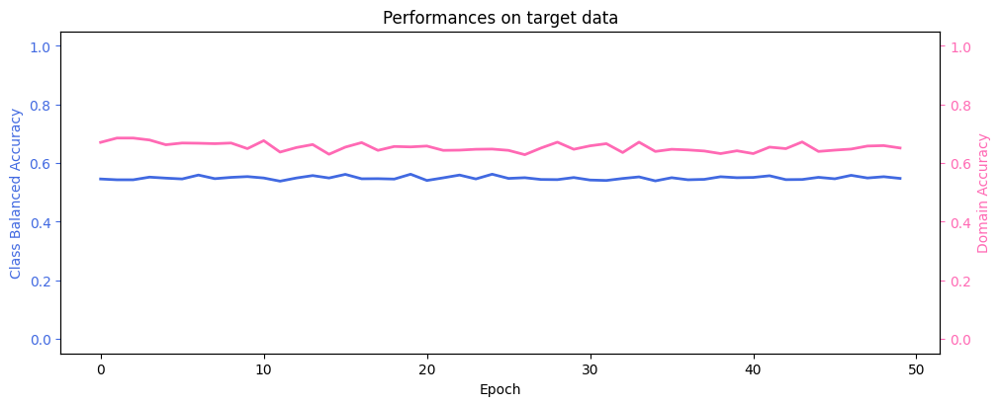

Results with  DANN_3
49/49 [==============================] - 0s 2ms/step


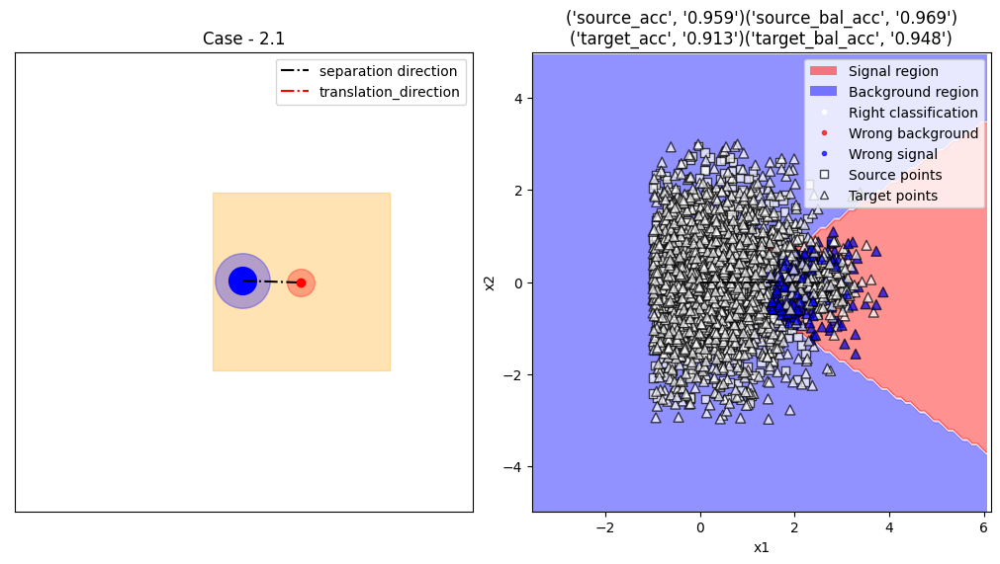

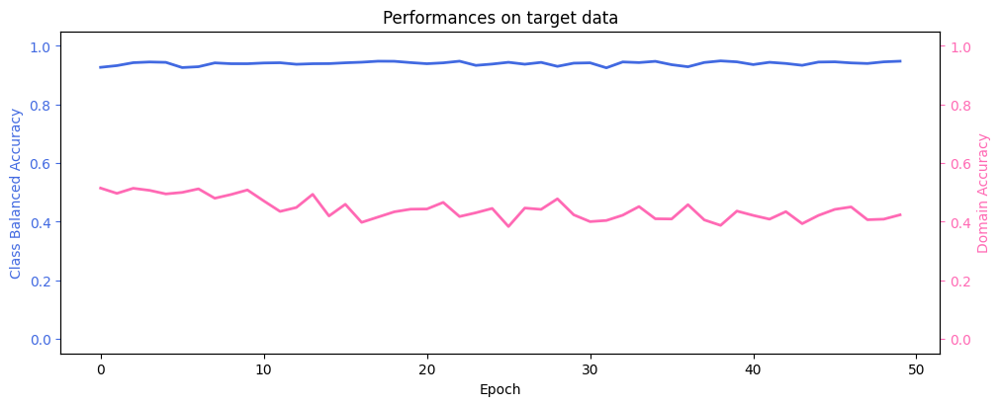

Results with  DANN_4
55/55 [==============================] - 0s 2ms/step


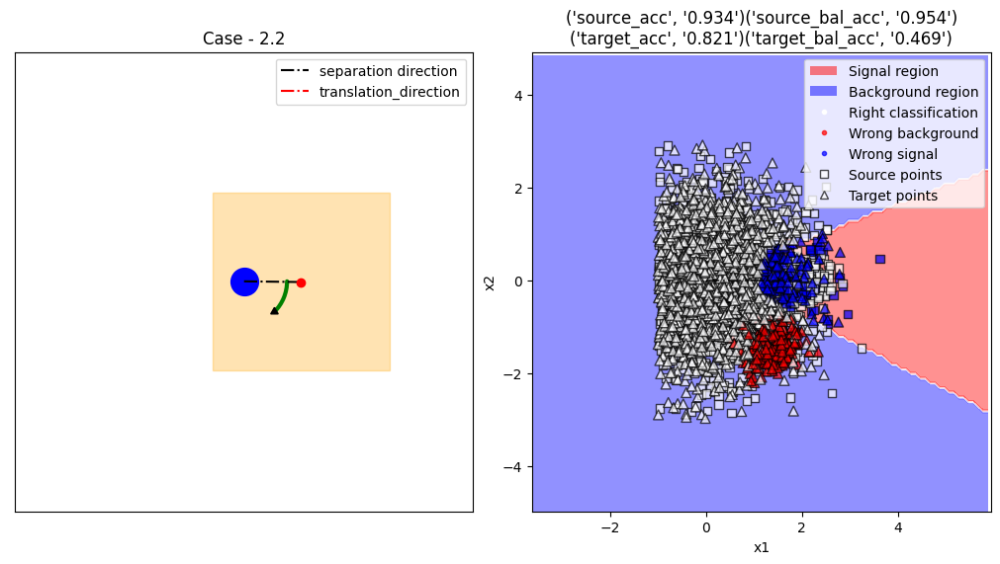

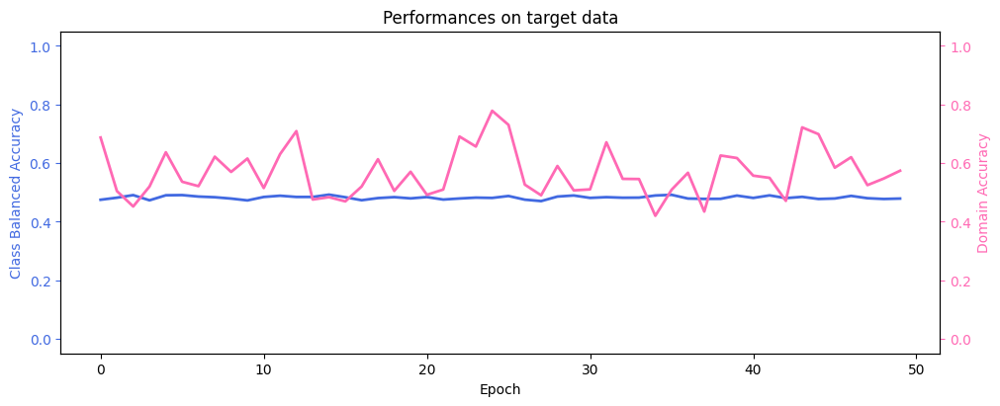

Results with  DANN_5
47/47 [==============================] - 0s 2ms/step


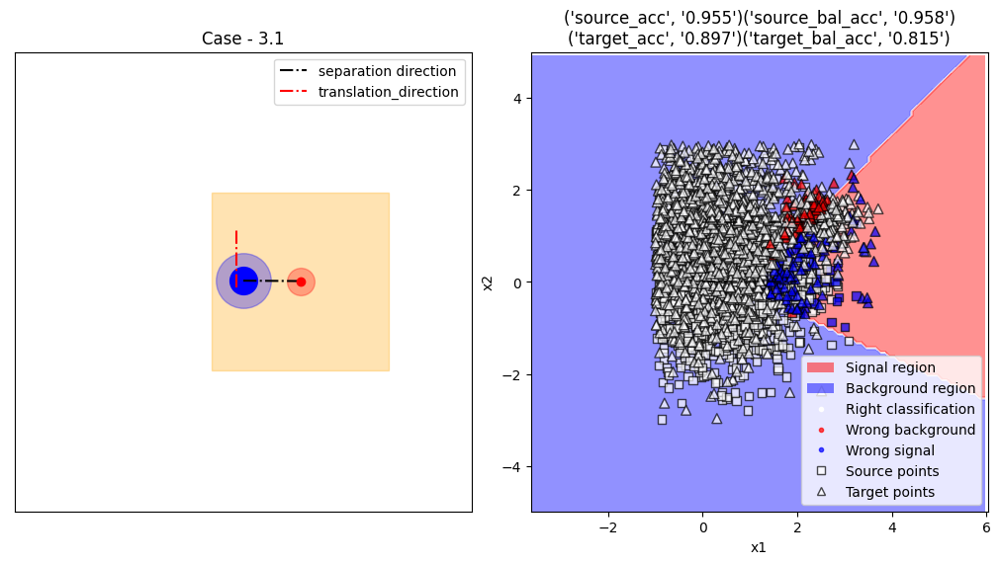

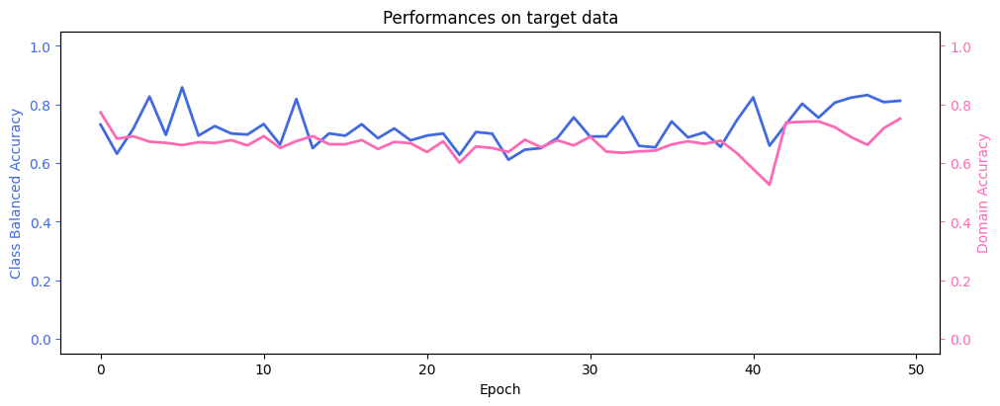

Results with  DANN_6
47/47 [==============================] - 0s 2ms/step


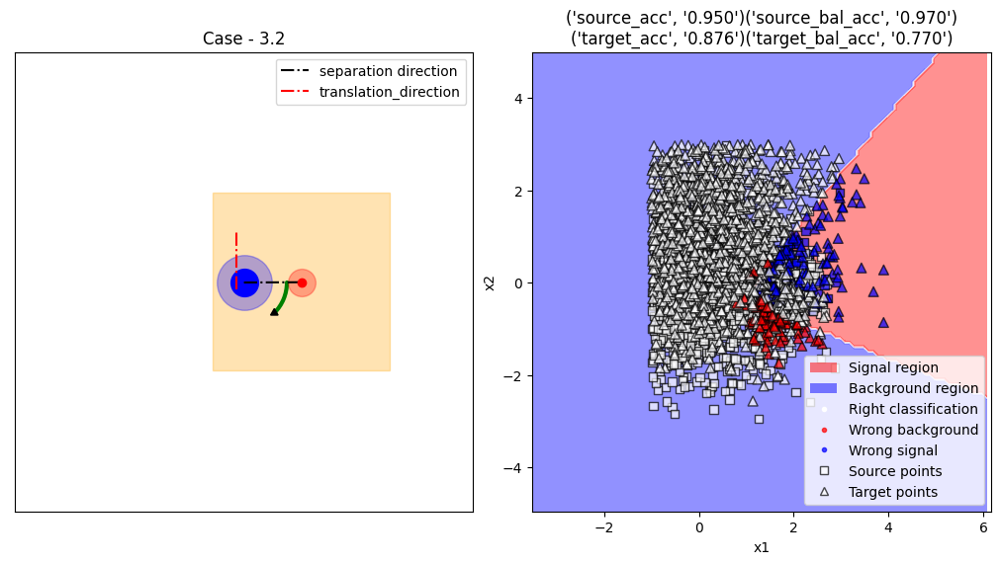

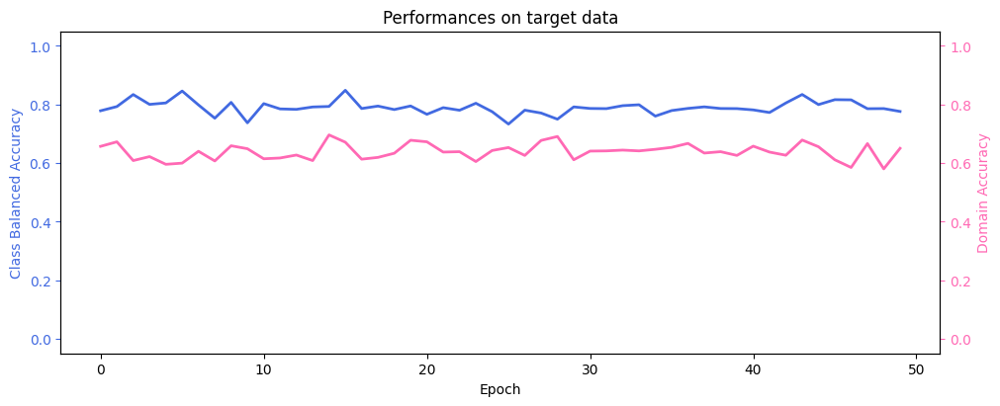

Results with  DANN_7
33/33 [==============================] - 0s 2ms/step


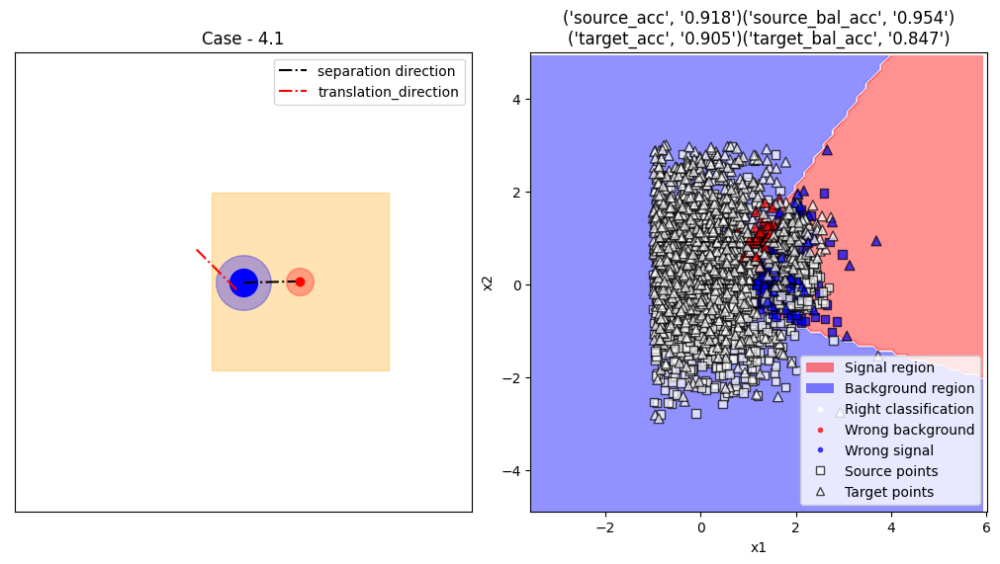

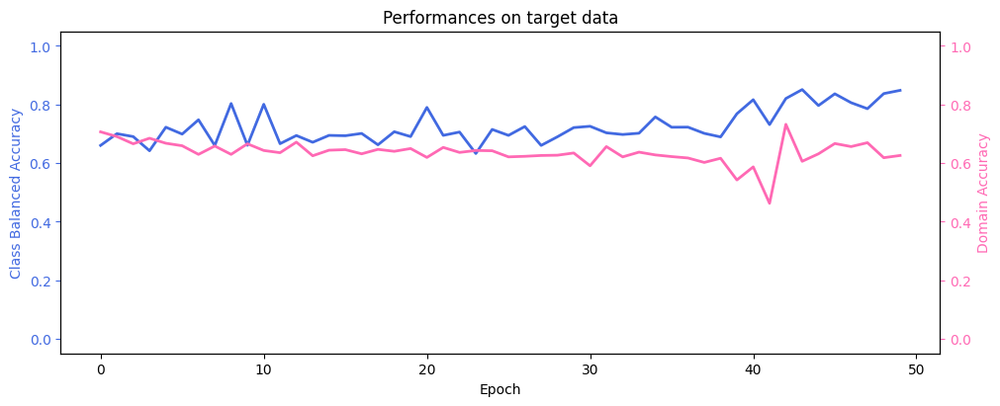

Results with  DANN_8
34/34 [==============================] - 1s 16ms/step


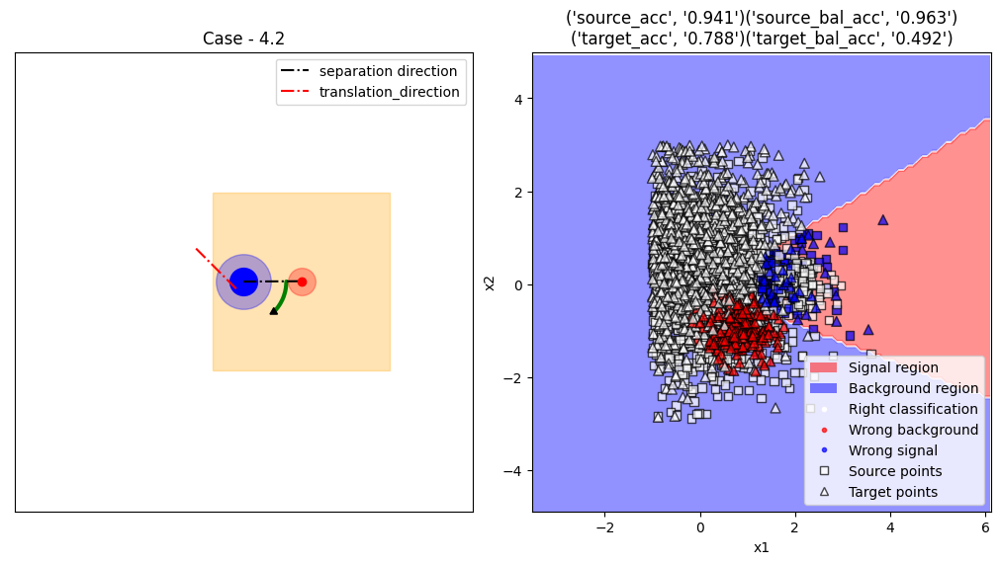

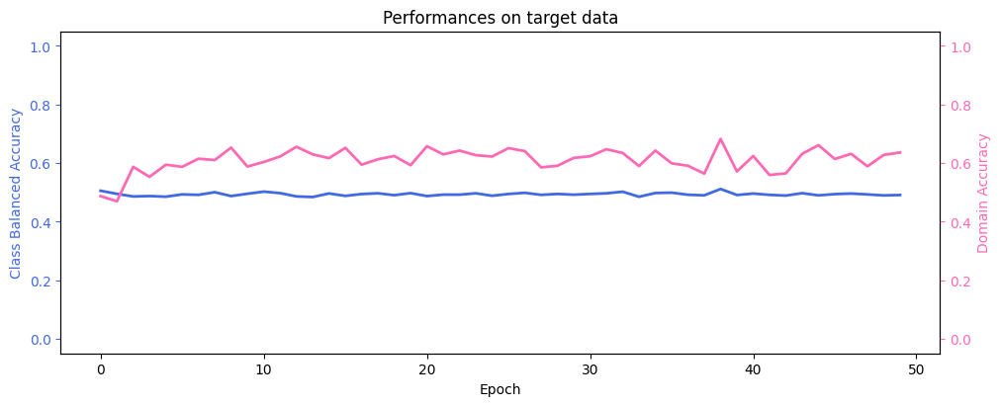

Results with  DANN_9
47/47 [==============================] - 0s 2ms/step


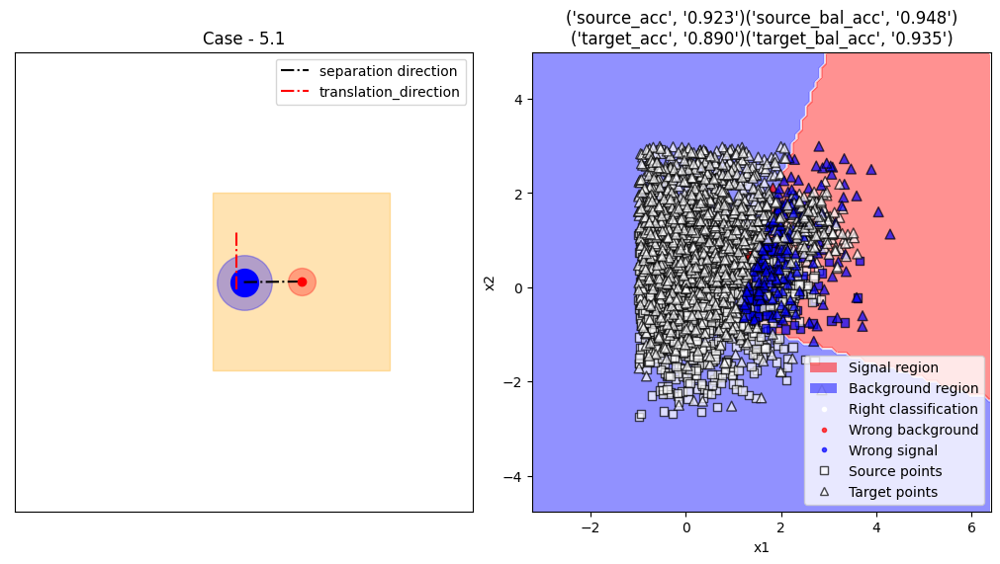

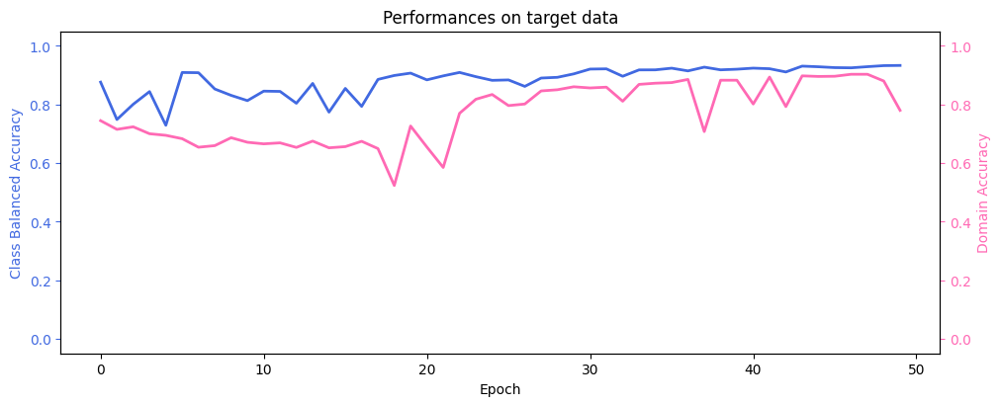

Results with  DANN_10
47/47 [==============================] - 0s 2ms/step


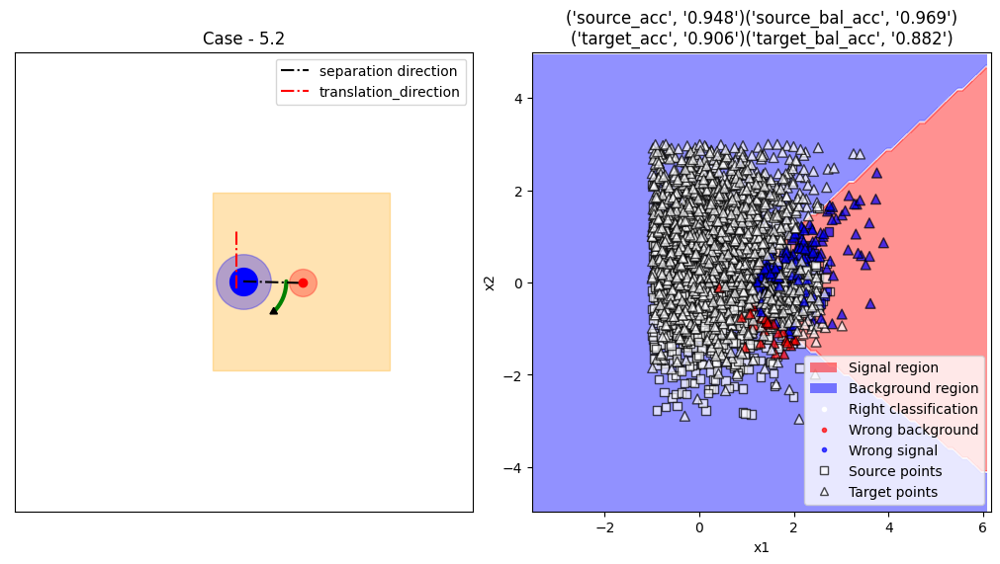

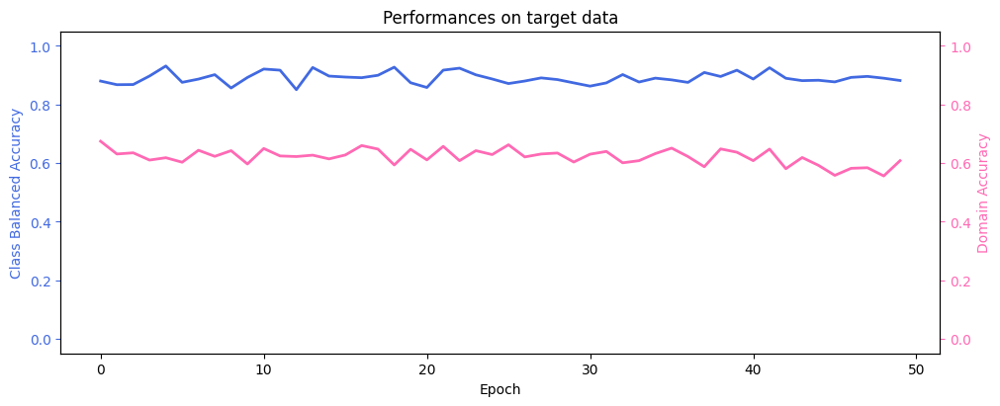

Results with  DANN_11
56/56 [==============================] - 0s 1ms/step


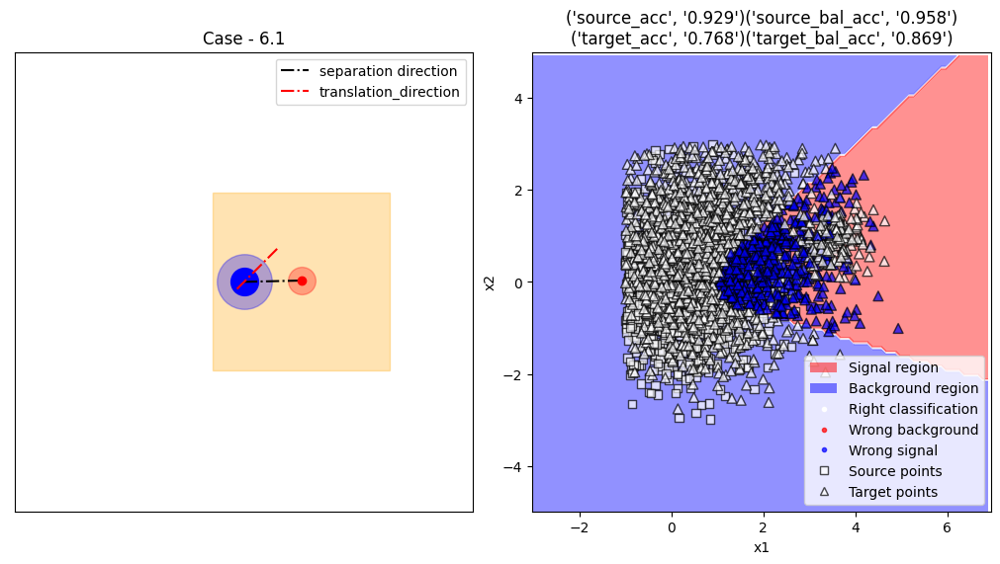

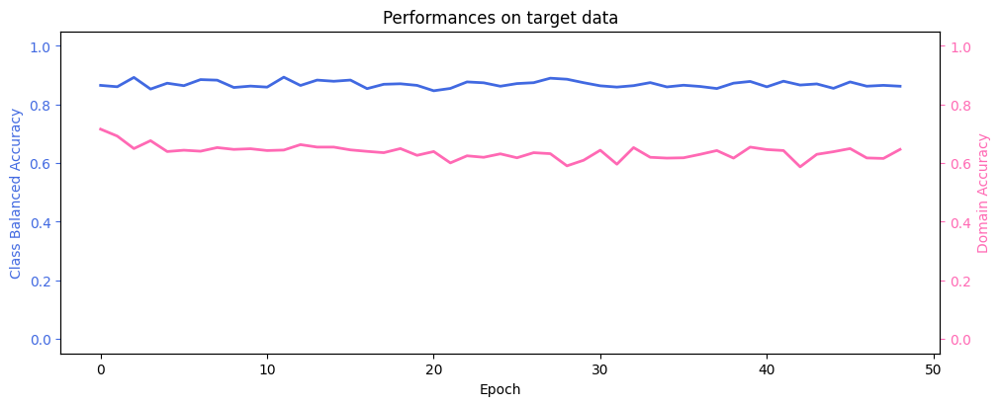

Results with  DANN_12
56/56 [==============================] - 0s 1ms/step


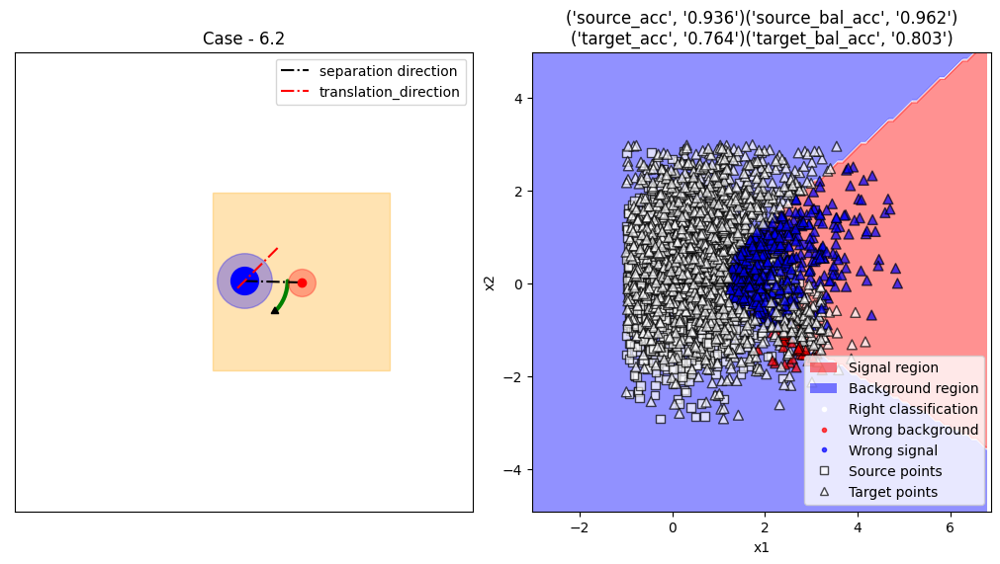

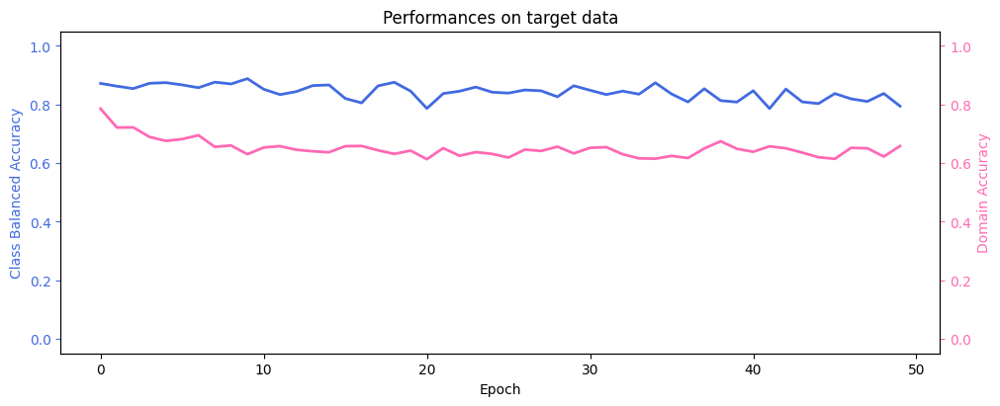

In [63]:
for i,data_pack in enumerate(zip(models,x_sources,y_sources,x_targets,y_targets,settings,histories)):

    # Unpack
    DANN_model,x_source,y_source,x_target,y_target,setting,history = data_pack
    print("Results with ", DANN_model.name)
    
    # Evaluate DANN
    results = evaluate_DANN(DANN_model,x_source, y_source, x_target, y_target)
    
    # Visualize DANN
    before_training = False # If True, true color of the points and no decision boundary. Prediction colors if False
    source_alpha = 0.7 # Opacity of source points
    target_alpha = 0.7 # Opacity of target points
    target_colors = True # Plot target points with meaningful colors if True and in grey if False
    regions_alpha = 0.5 # Opacity of prediction regions
    show_scores = True # Whether or not to show the title made of scores
    save_figure = True
    visualize_DANN_boundaries(DANN_model, x_source.values, y_source, x_target.values, y_target, setting, results, before_training, source_alpha, target_alpha, target_colors, regions_alpha, show_scores, save_figure)
    
    visualize_history(history)

# 7 - All systematics multivariate Gaussian

## 7.1 - Generate Data

In [64]:
from data_loader import get_settings_from_json
from data_generator_all_systematics import DataGenerator

In [65]:
data_dir = "DANN_data/qualitative/all_systematics_multivariate"

In [66]:
data_gen_settings = get_settings_from_json('data_jsons/all_systematics_multivariate')
for index, settings in enumerate(data_gen_settings):
    data_gen = DataGenerator(settings_dict=settings)
    data_gen.generate_data()
    data_gen.save_data(directory=data_dir, file_index=index+1)
    

## 7.2 - Load Data

In [67]:
from data_io import load_data, show_data_statistics, write

In [68]:
train_sets, test_sets, settings = load_data(data_dir, load_settings=True)



###-------------------------------------###
### Data Loading
###-------------------------------------###

[*] data dir :  DANN_data/qualitative/all_systematics_multivariate
[*] train data dir :  DANN_data/qualitative/all_systematics_multivariate\train\data
[*] train labels dir :  DANN_data/qualitative/all_systematics_multivariate\train\labels
[*] test data dir :  DANN_data/qualitative/all_systematics_multivariate\test\data
[*] test labels dir :  DANN_data/qualitative/all_systematics_multivariate\test\labels
[*] settings dir :  DANN_data/qualitative/all_systematics_multivariate\settings
[+] train data dir found
[+] train labels dir found
[+] test data dir found
[+] test labels dir found
[+] settings dir found
[+] 12 train and test sets found
---------------------------------
[+] Train and Test data loaded!
---------------------------------




## 7.3 - Visualize Data

In [69]:
from visualize import visualize_data

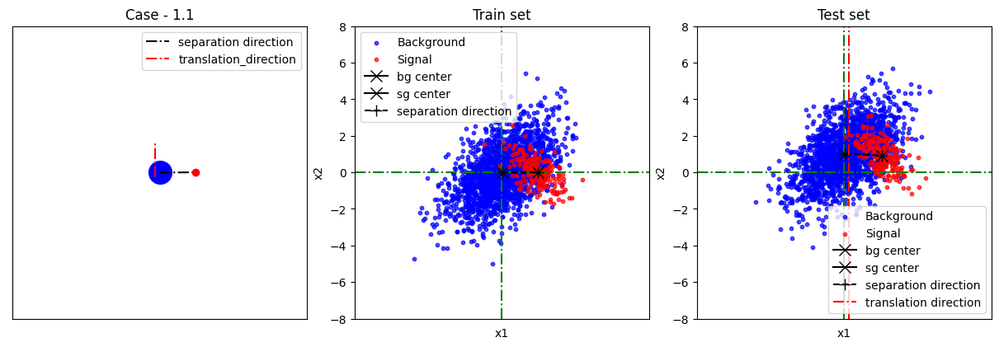

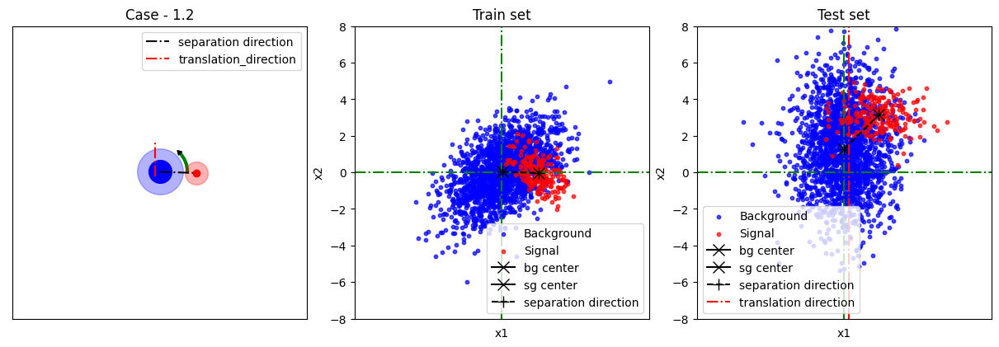

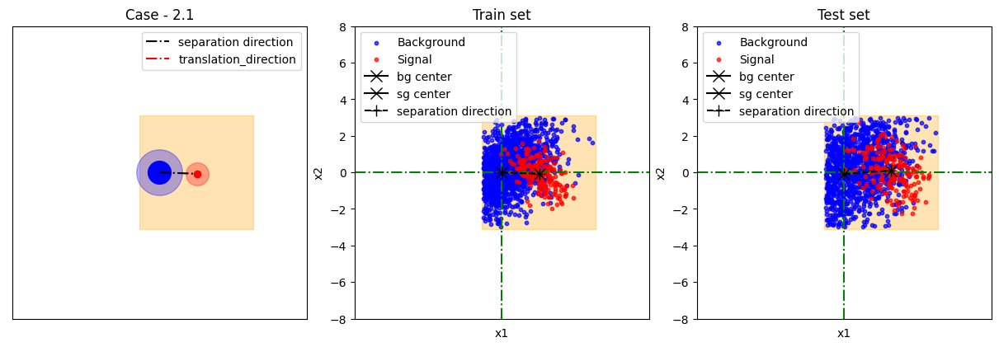

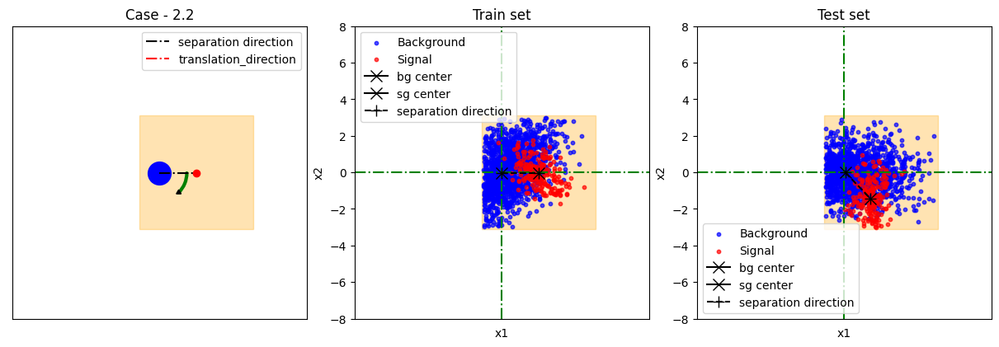

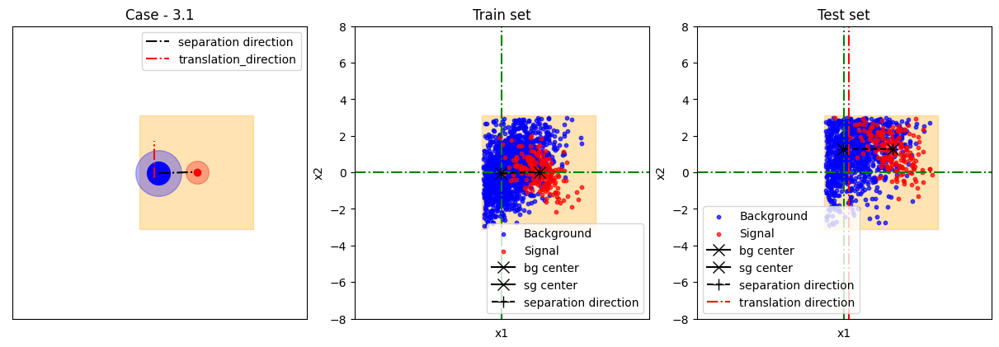

...

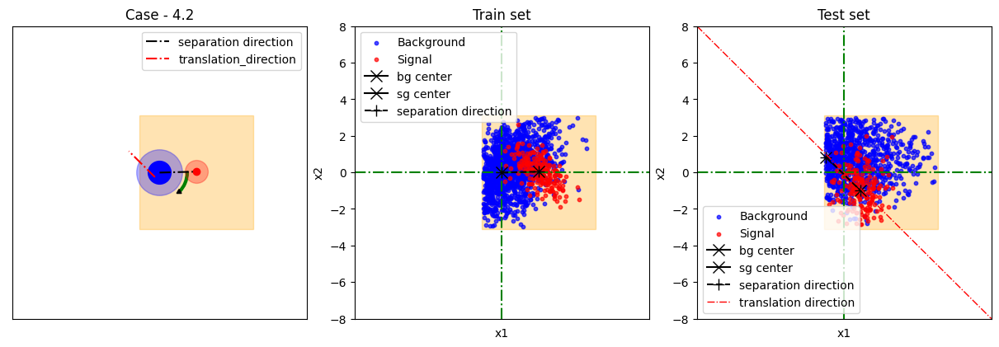

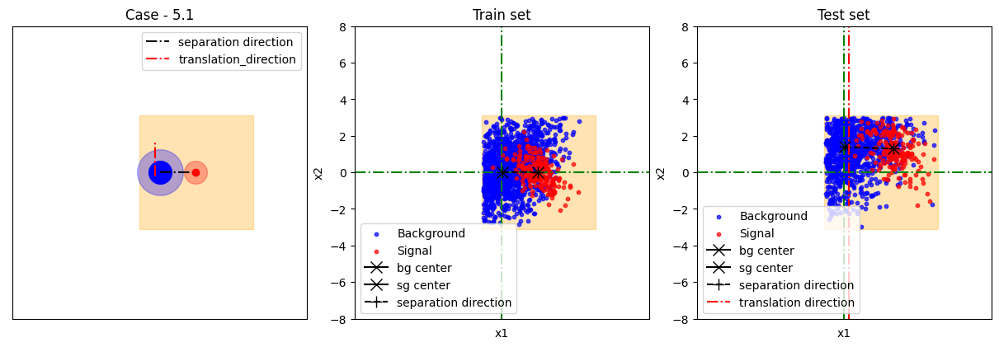

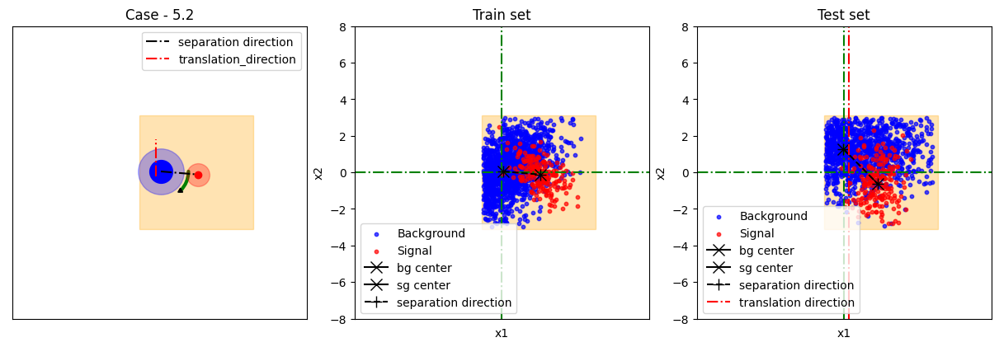

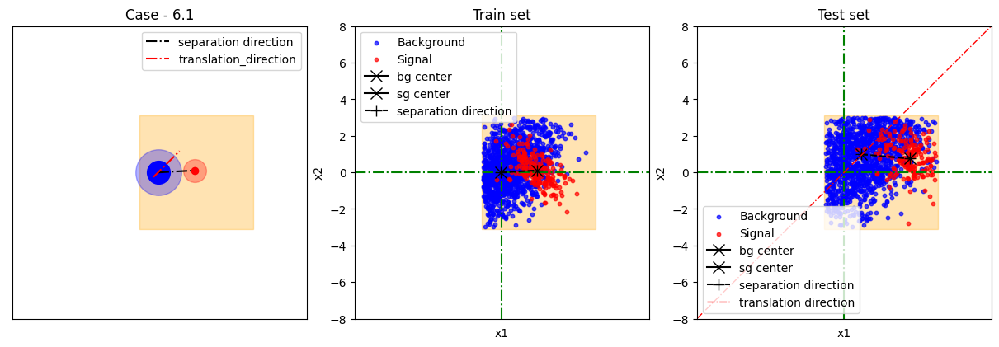

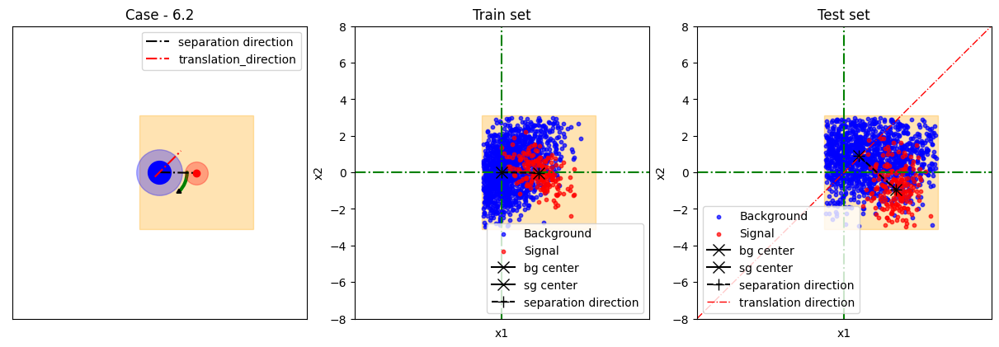

In [70]:
for index, _ in enumerate(train_sets):
    visualize_data(settings[index], train_sets[index], test_sets[index])
    #if index == 0:
    #    break

## 7.4 - Set parameters for DANN

In [71]:
input_size  = (2,)
hp_lambda = 1.0
num_epochs  = 50
batch_size  = 20
class_weights = [1,9]
# Becarefull that batch_size cannot be odd : if you set it to 25, each training batch will actualy be of size 24 
# and some samples will not be used at each epoch. 
# The reason for this is that training batches are made of the same number of source and target points 
nums_source_samples = [train_set["labels"].shape[0] for train_set in train_sets]

nums_target_samples = [test_set["labels"].shape[0] for test_set in test_sets]
nums_train_steps_per_epoch = [math.ceil((num_source_samples+num_target_samples)/batch_size) for num_source_samples,num_target_samples in zip(nums_source_samples,nums_target_samples)]
nums_test_steps_per_epoch = [math.ceil(num_target_samples/batch_size) for num_target_samples in nums_target_samples]

## 7.5 - Prepare data for DANN

In [72]:
from DANN import set_data_for_DANN,build_datasets_for_DANN

In [73]:
x_sources, y_sources, x_targets, y_targets = set_data_for_DANN (train_sets,test_sets)

In [74]:
training_datasets, testing_datasets = build_datasets_for_DANN (x_sources,y_sources,x_targets,y_targets,num_epochs, batch_size, portion_of_target_for_train=1)

## 7.6 - Use DANN

In [75]:
from DANN import (build_DANN,
                  compile_DANN,
                  fit_DANN,
                  evaluate_DANN)
from visualize import visualize_DANN_boundaries

In [76]:
models = []
histories = []
for i,data_pack in enumerate(zip(training_datasets,testing_datasets,settings,nums_train_steps_per_epoch,nums_test_steps_per_epoch)):

    # Unpack
    training_dataset,testing_dataset,setting,num_train_steps_per_epoch,num_test_steps_per_epoch = data_pack
    
    # Build DANN
    DANN_model = build_DANN("DANN_"+str(i+1),input_size,hp_lambda)
    print("Started to work with", DANN_model.name)
    
    # Compile DANN
    compile_DANN(DANN_model,class_weights)
    
    # Fit DANN
    history = fit_DANN(DANN_model,training_dataset,testing_dataset,num_epochs,num_train_steps_per_epoch,num_test_steps_per_epoch)
    models.append(DANN_model)
    histories.append(history)

Started to work with DANN_1
Started to work with DANN_2
Started to work with DANN_3
Started to work with DANN_4
Started to work with DANN_5
Started to work with DANN_6
Started to work with DANN_7
Started to work with DANN_8
Started to work with DANN_9
Started to work with DANN_10
Started to work with DANN_11
Started to work with DANN_12


Results with  DANN_1
63/63 [==============================] - 0s 3ms/step


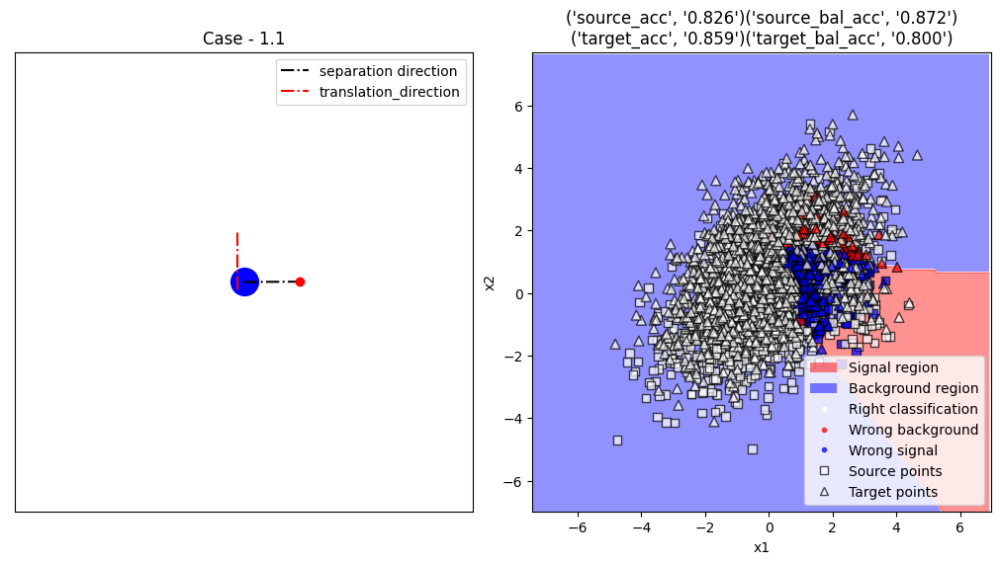

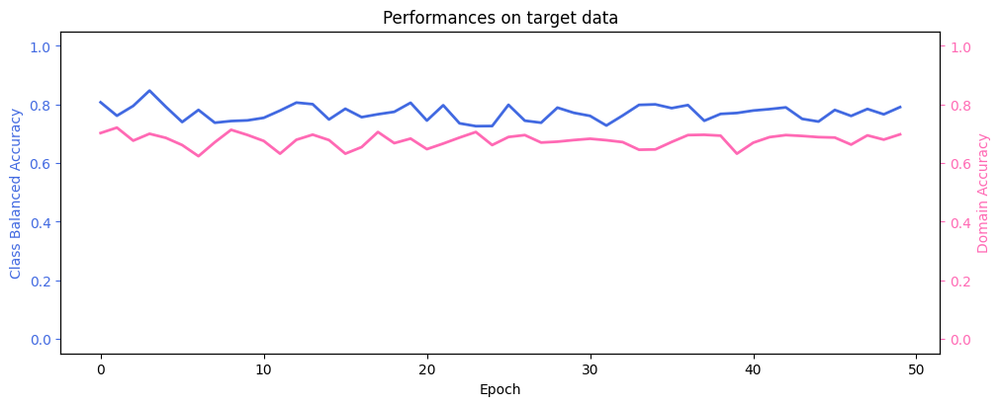

Results with  DANN_2
63/63 [==============================] - 0s 3ms/step


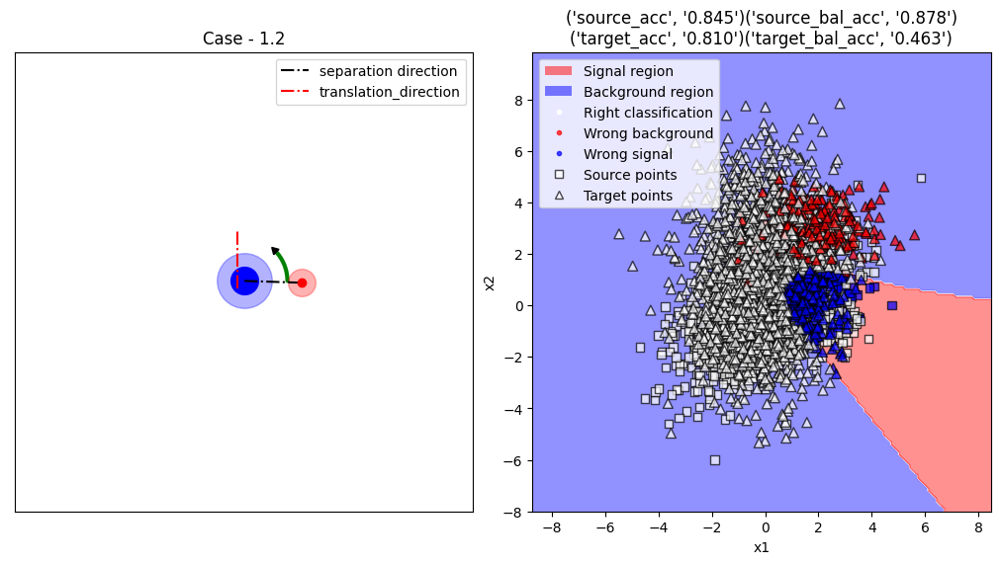

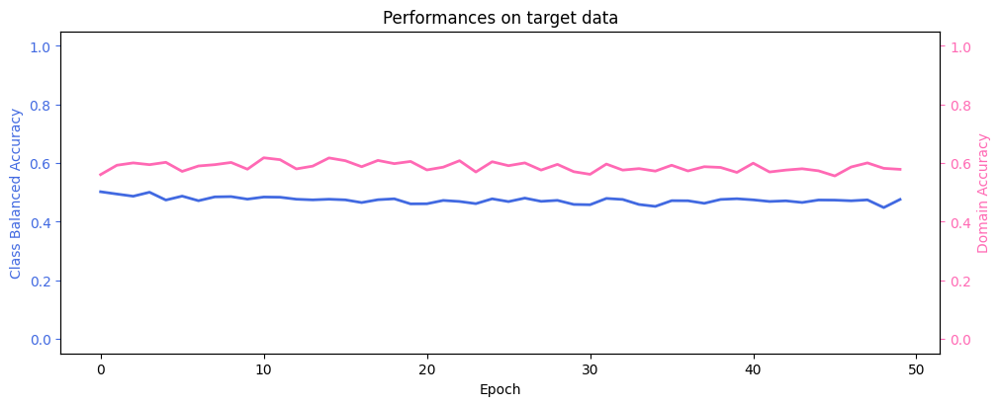

Results with  DANN_3
43/43 [==============================] - 0s 3ms/step


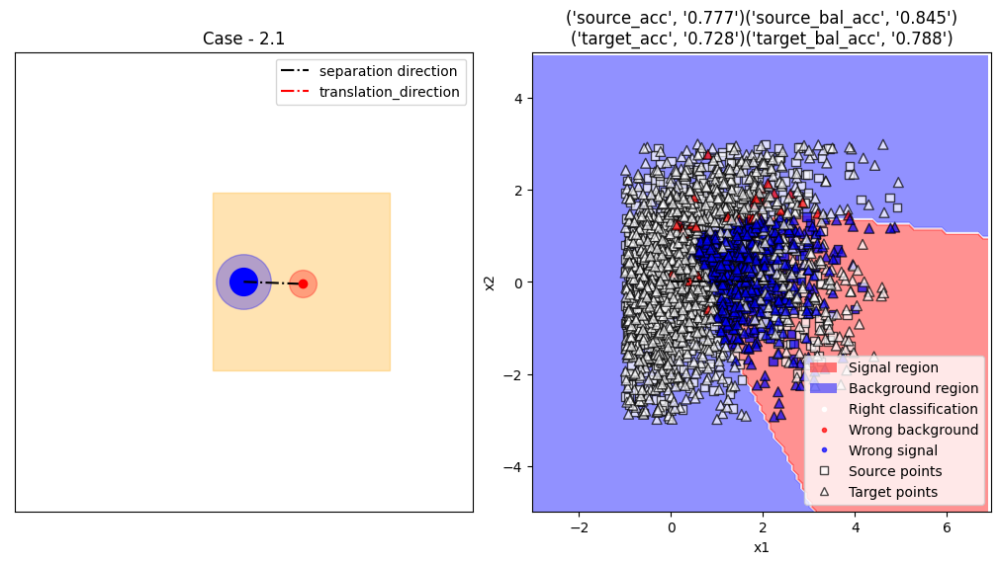

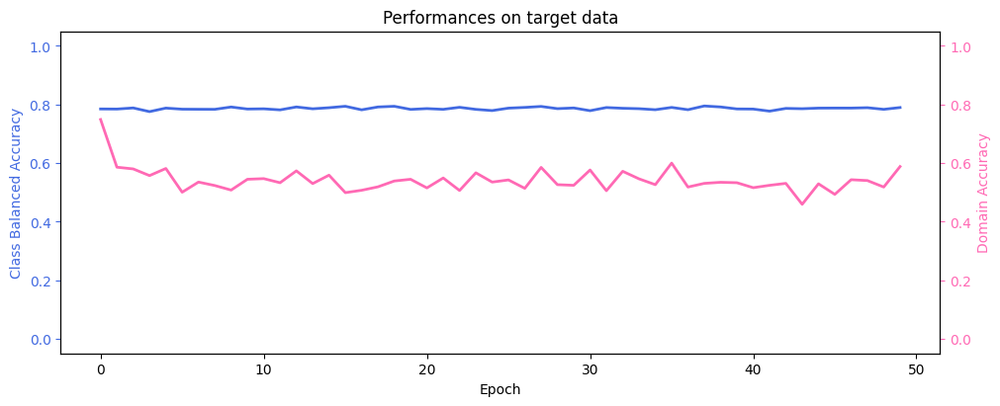

Results with  DANN_4
47/47 [==============================] - 0s 2ms/step


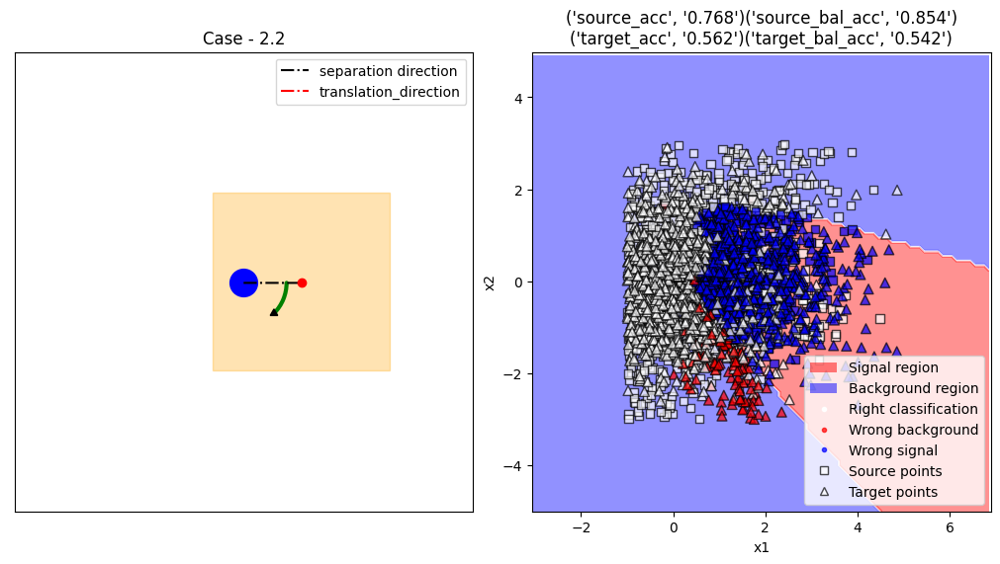

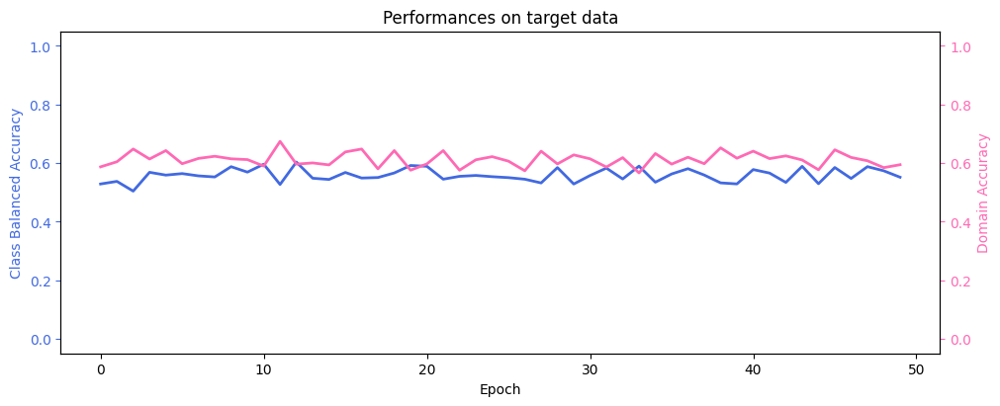

Results with  DANN_5
37/37 [==============================] - 0s 3ms/step


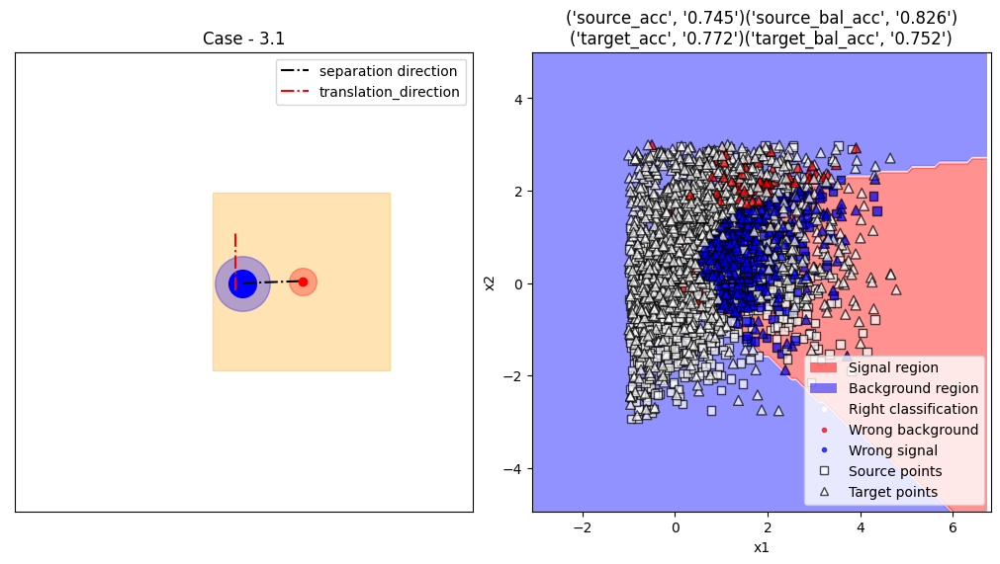

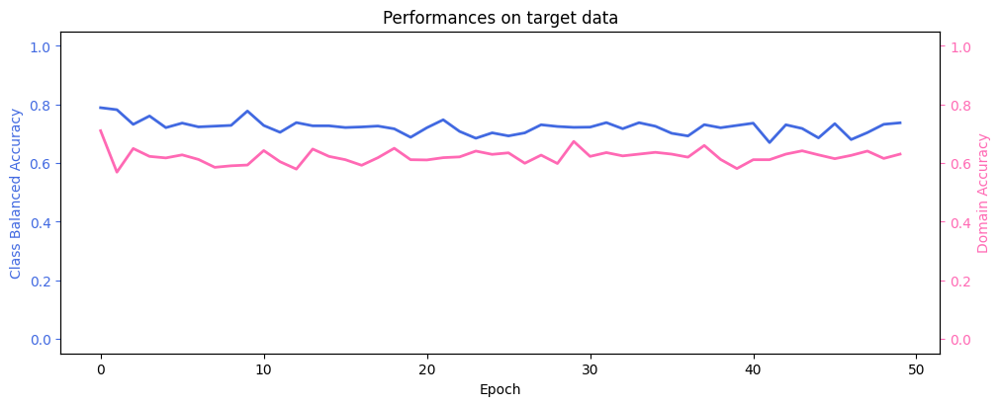

Results with  DANN_6
39/39 [==============================] - 0s 3ms/step


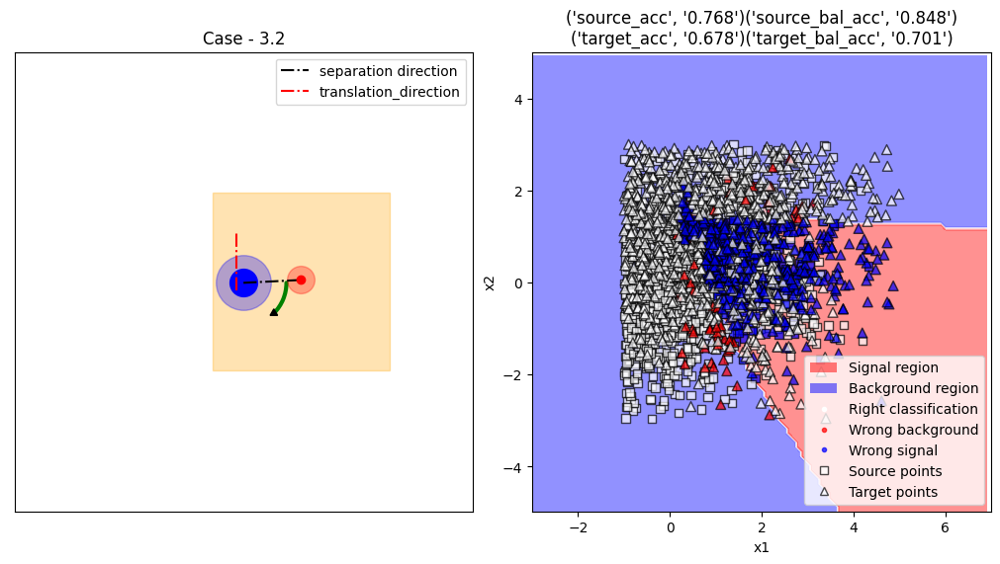

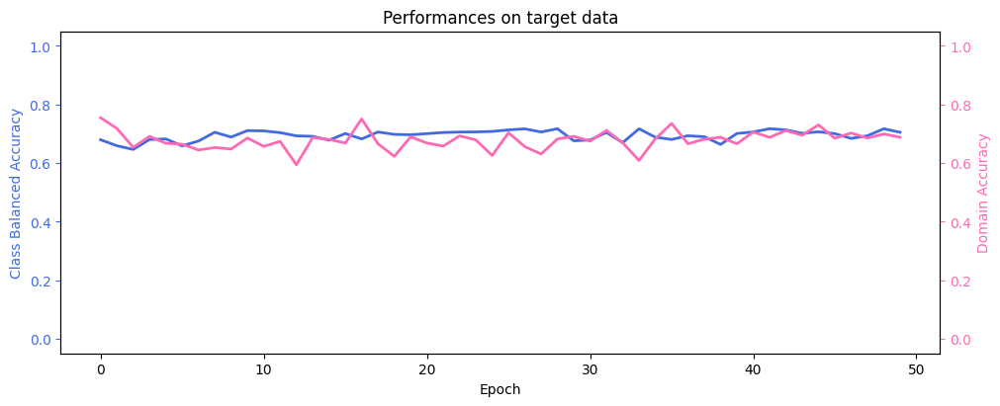

Results with  DANN_7
29/29 [==============================] - 0s 2ms/step


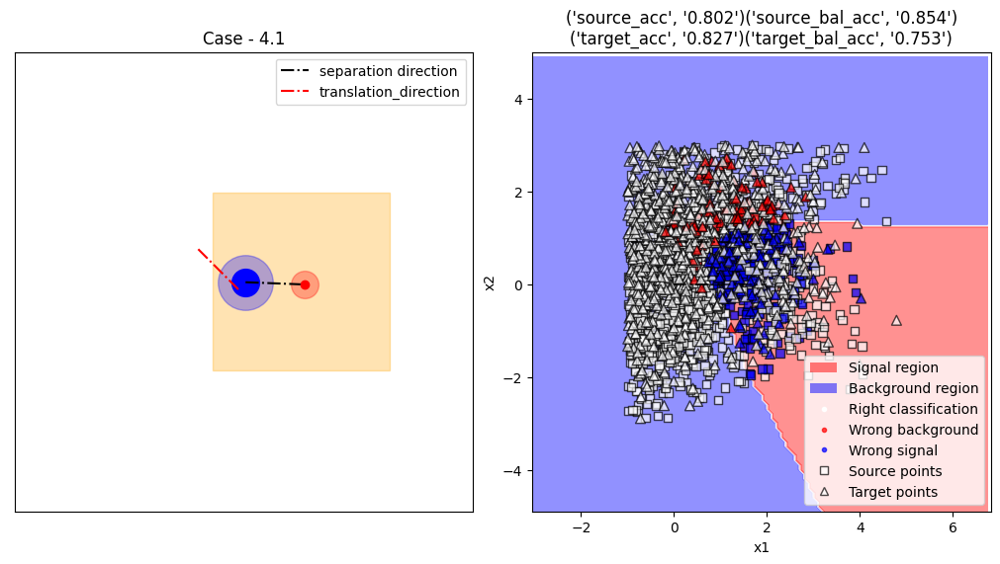

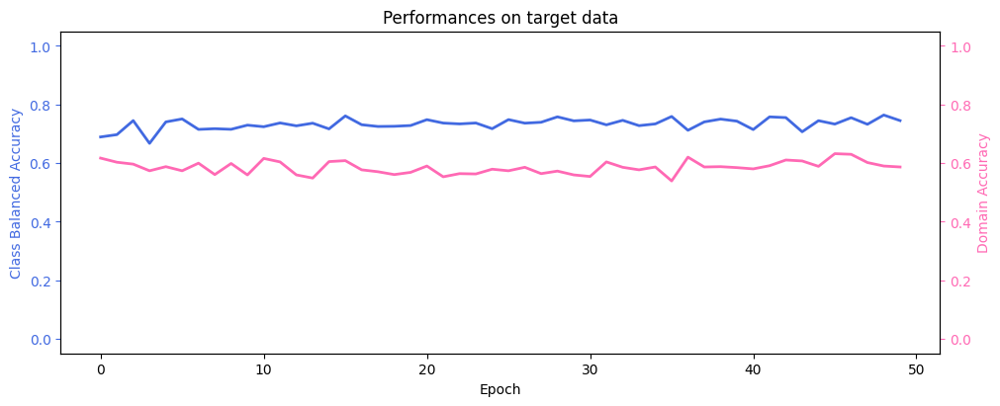

Results with  DANN_8
34/34 [==============================] - 0s 2ms/step


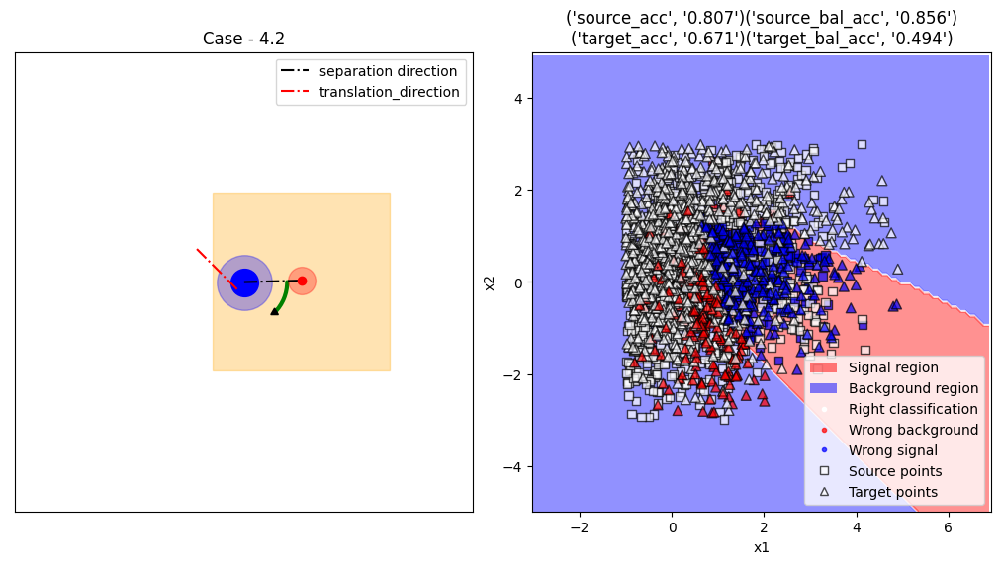

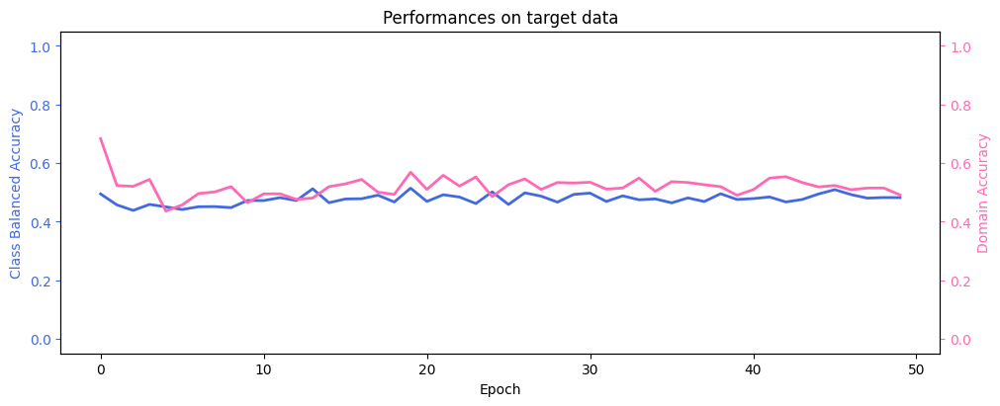

Results with  DANN_9
36/36 [==============================] - 0s 2ms/step


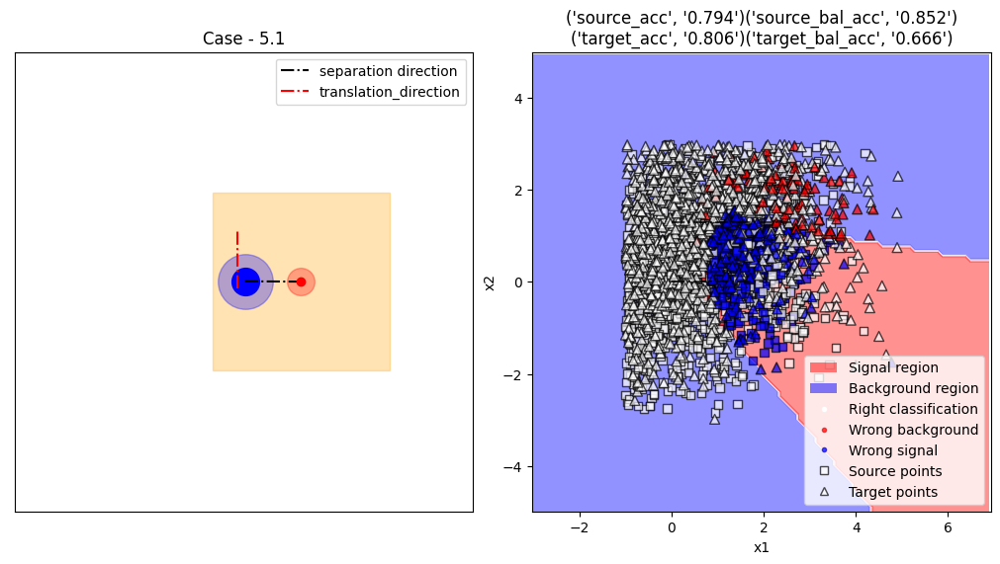

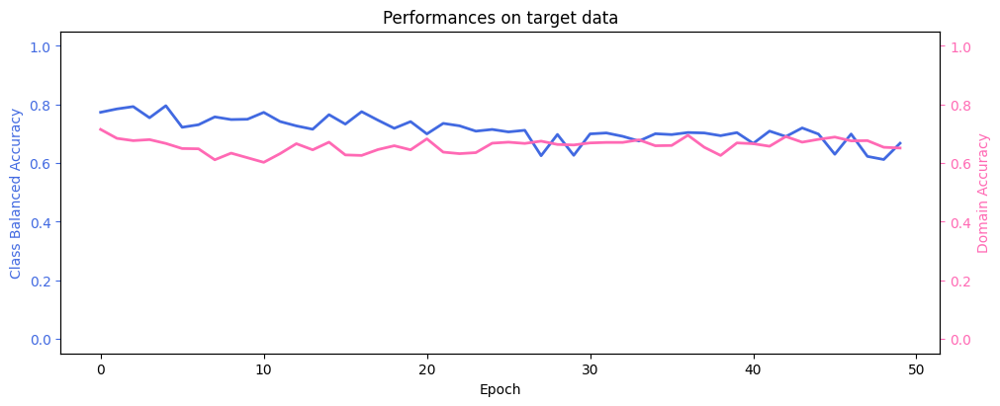

Results with  DANN_10
40/40 [==============================] - 0s 2ms/step


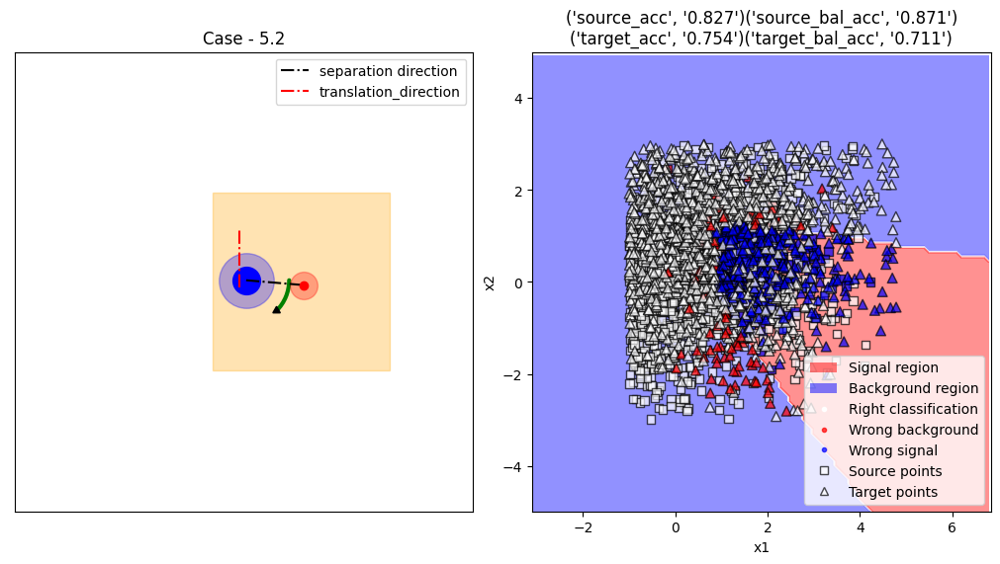

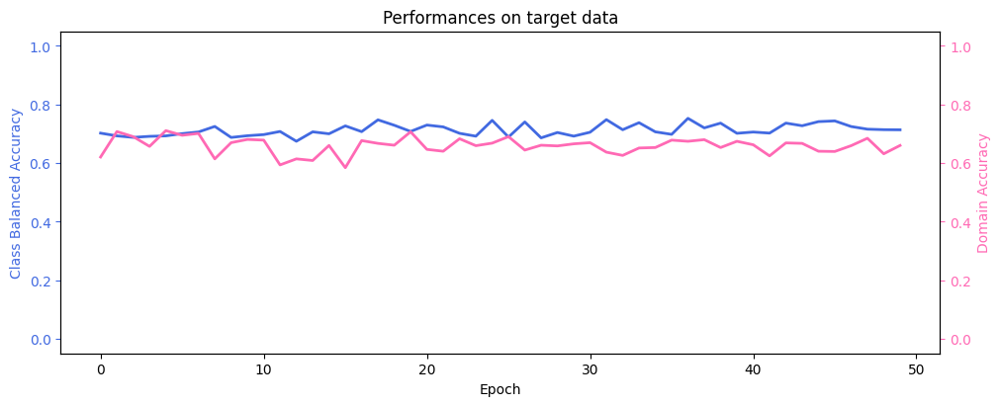

Results with  DANN_11
46/46 [==============================] - 0s 3ms/step


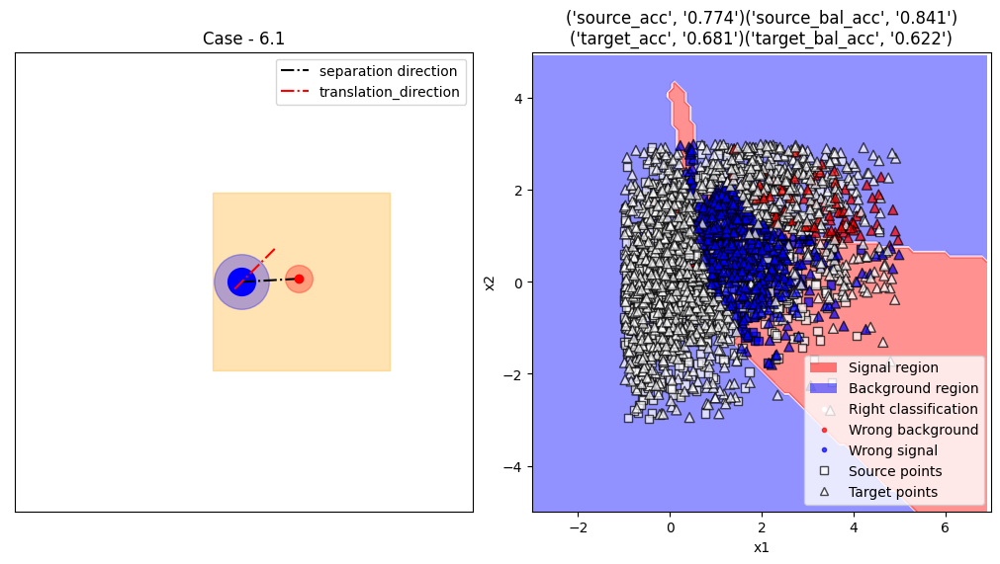

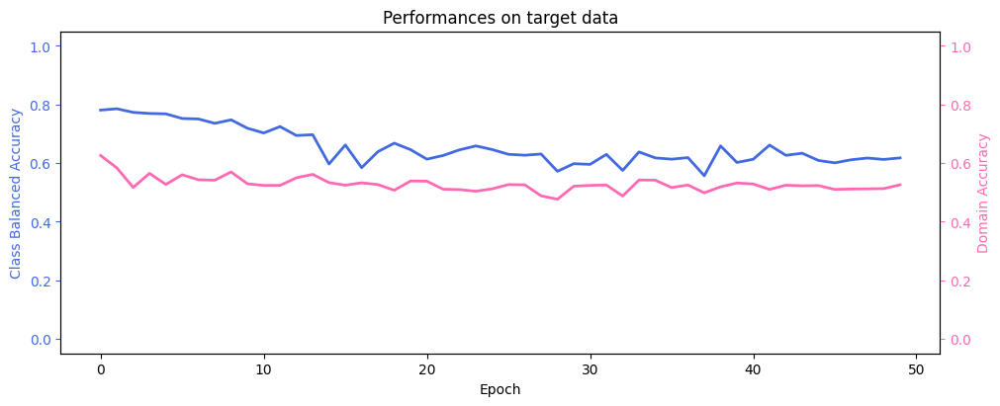

Results with  DANN_12
47/47 [==============================] - 0s 2ms/step


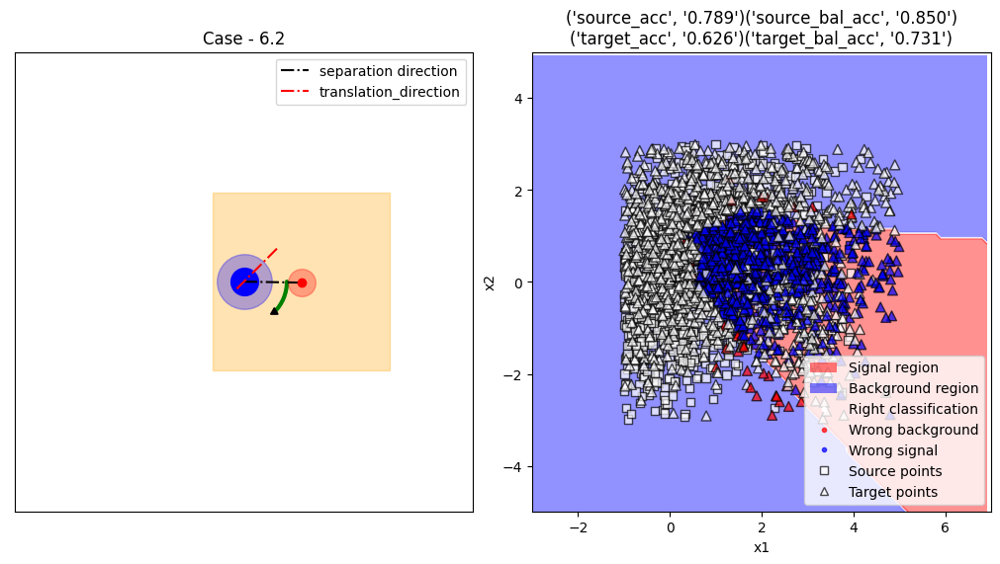

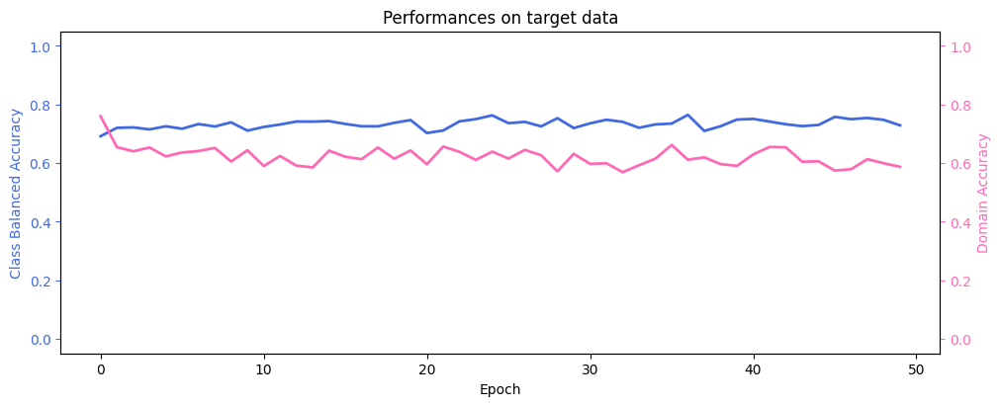

In [77]:
for i,data_pack in enumerate(zip(models,x_sources,y_sources,x_targets,y_targets,settings,histories)):

    # Unpack
    DANN_model,x_source,y_source,x_target,y_target,setting,history = data_pack
    print("Results with ", DANN_model.name)
    
    # Evaluate DANN
    results = evaluate_DANN(DANN_model,x_source, y_source, x_target, y_target)
    
    # Visualize DANN
    before_training = False # If True, true color of the points and no decision boundary. Prediction colors if False
    source_alpha = 0.7 # Opacity of source points
    target_alpha = 0.7 # Opacity of target points
    target_colors = True # Plot target points with meaningful colors if True and in grey if False
    regions_alpha = 0.5 # Opacity of prediction regions
    show_scores = True # Whether or not to show the title made of scores
    save_figure = True
    visualize_DANN_boundaries(DANN_model, x_source.values, y_source, x_target.values, y_target, setting, results, before_training, source_alpha, target_alpha, target_colors, regions_alpha, show_scores, save_figure)
    
    visualize_history(history)

# 8 - All systematics Gaussian copulas

## 8.1 - Generate Data

In [78]:
from data_loader import get_settings_from_json
from data_generator_all_systematics import DataGenerator

In [79]:
data_dir = "DANN_data/qualitative/all_systematics_normal_gamma_copulas"

In [80]:
data_gen_settings = get_settings_from_json('data_jsons/all_systematics_normal_gamma_copulas')
for index, settings in enumerate(data_gen_settings):
    data_gen = DataGenerator(settings_dict=settings)
    data_gen.generate_data()
    data_gen.save_data(directory=data_dir, file_index=index+1)
    

## 8.2 - Load Data

In [81]:
from data_io import load_data, show_data_statistics, write

In [82]:
train_sets, test_sets, settings = load_data(data_dir, load_settings=True)



###-------------------------------------###
### Data Loading
###-------------------------------------###

[*] data dir :  DANN_data/qualitative/all_systematics_normal_gamma_copulas
[*] train data dir :  DANN_data/qualitative/all_systematics_normal_gamma_copulas\train\data
[*] train labels dir :  DANN_data/qualitative/all_systematics_normal_gamma_copulas\train\labels
[*] test data dir :  DANN_data/qualitative/all_systematics_normal_gamma_copulas\test\data
[*] test labels dir :  DANN_data/qualitative/all_systematics_normal_gamma_copulas\test\labels
[*] settings dir :  DANN_data/qualitative/all_systematics_normal_gamma_copulas\settings
[+] train data dir found
[+] train labels dir found
[+] test data dir found
[+] test labels dir found
[+] settings dir found
[+] 12 train and test sets found
---------------------------------
[+] Train and Test data loaded!
---------------------------------




## 8.3 - Visualize Data

In [83]:
from visualize import visualize_data

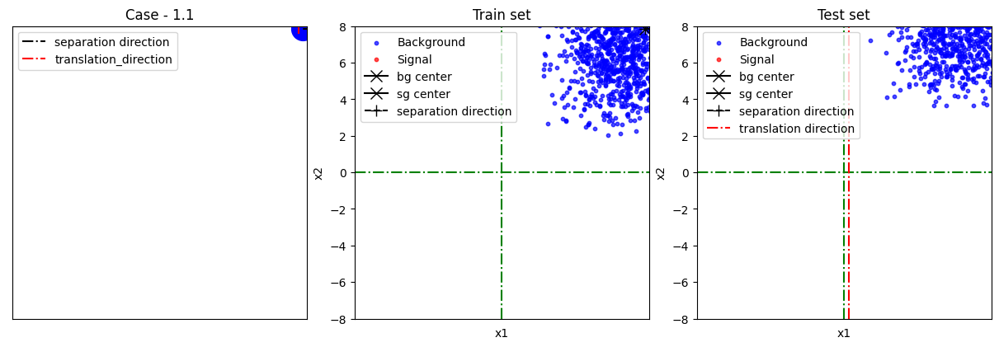

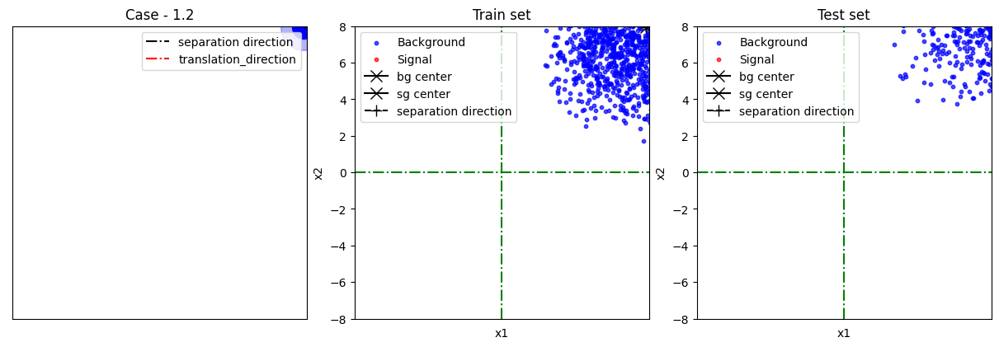

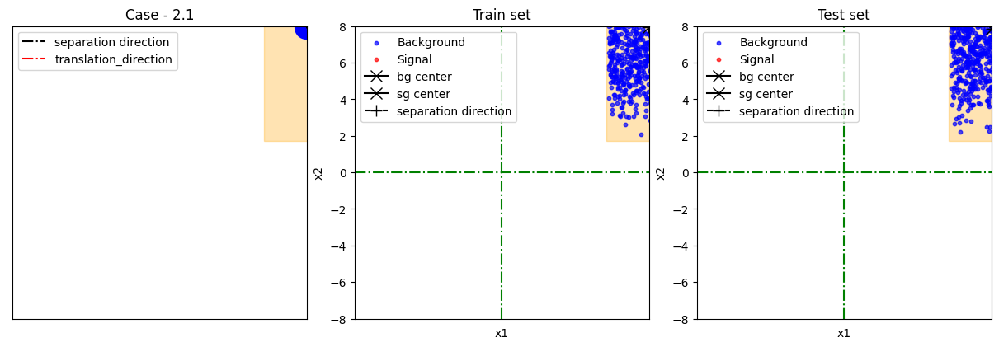

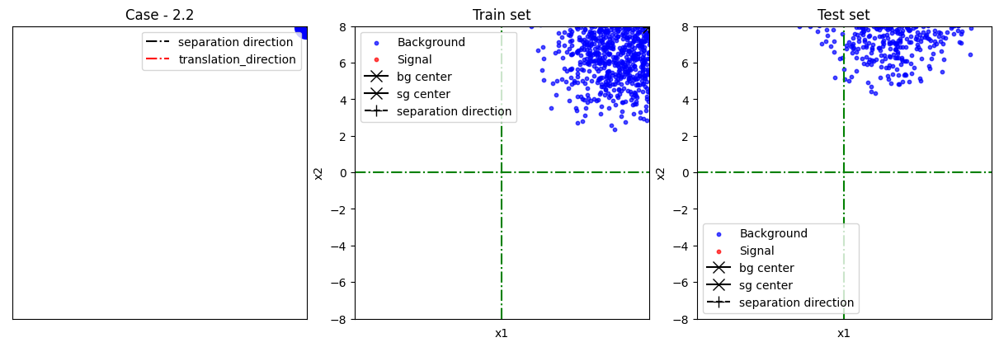

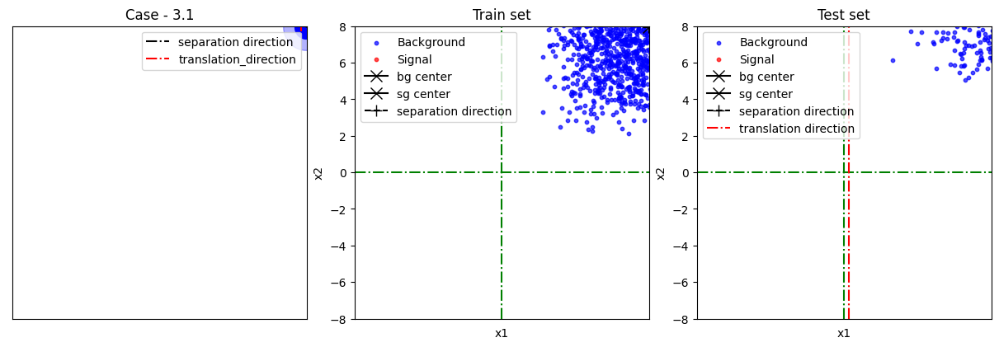

...

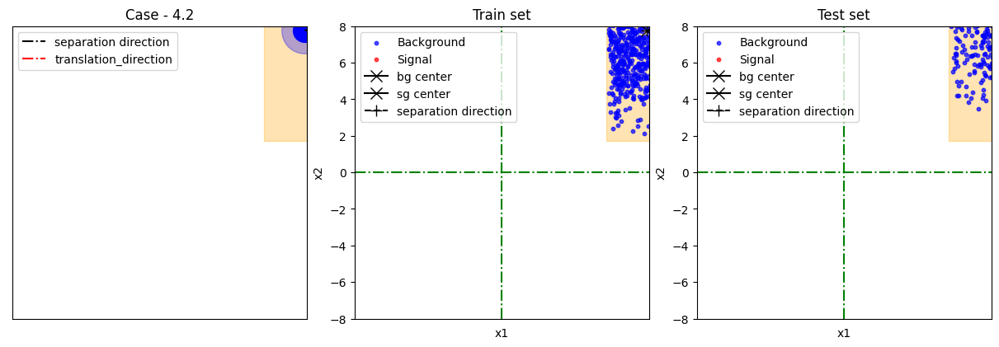

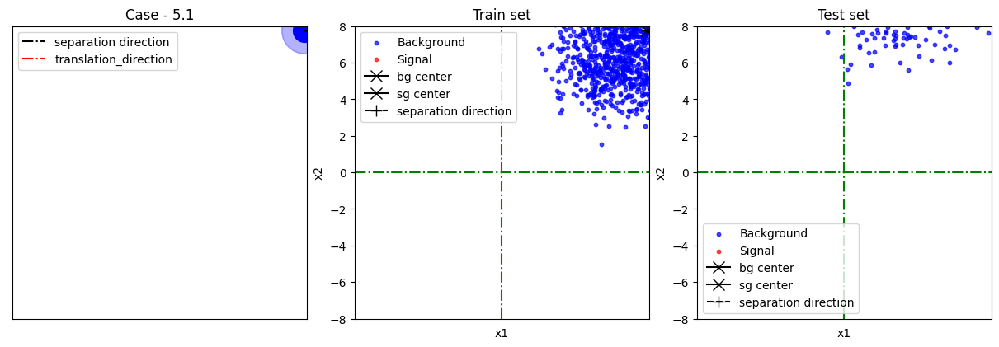

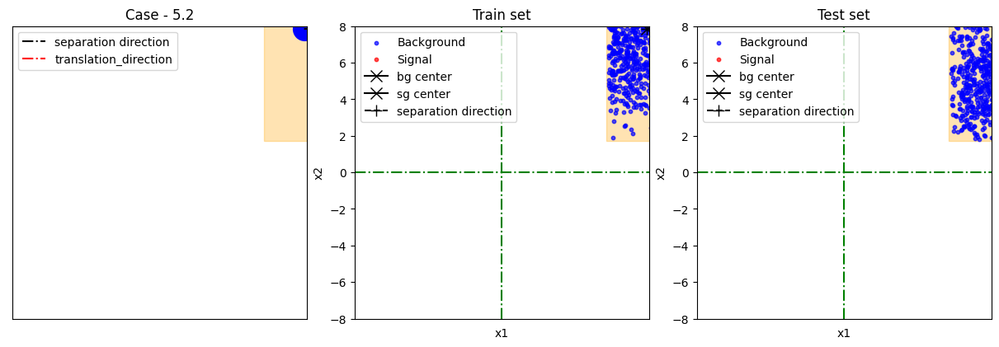

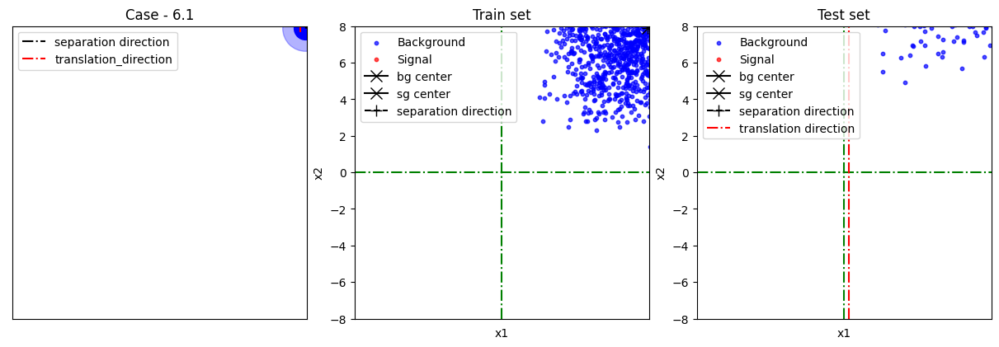

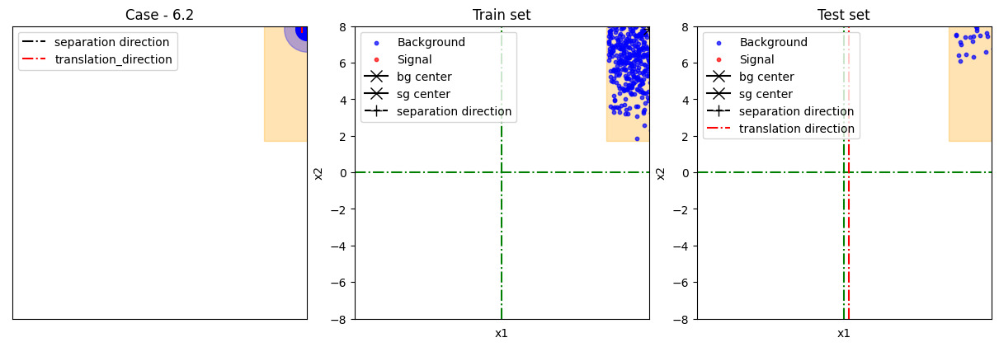

In [84]:
for index, _ in enumerate(train_sets):
    visualize_data(settings[index], train_sets[index], test_sets[index])
    #if index == 0:
    #    break

## 8.4 - Set parameters for DANN

In [85]:
input_size  = (2,)
hp_lambda = 1.0
num_epochs  = 50
batch_size  = 20
class_weights = [1,9]
# Becarefull that batch_size cannot be odd : if you set it to 25, each training batch will actualy be of size 24 
# and some samples will not be used at each epoch. 
# The reason for this is that training batches are made of the same number of source and target points 
nums_source_samples = [train_set["labels"].shape[0] for train_set in train_sets]

nums_target_samples = [test_set["labels"].shape[0] for test_set in test_sets]
nums_train_steps_per_epoch = [math.ceil((num_source_samples+num_target_samples)/batch_size) for num_source_samples,num_target_samples in zip(nums_source_samples,nums_target_samples)]
nums_test_steps_per_epoch = [math.ceil(num_target_samples/batch_size) for num_target_samples in nums_target_samples]

## 8.5 - Prepare data for DANN

In [86]:
from DANN import set_data_for_DANN,build_datasets_for_DANN

In [87]:
x_sources, y_sources, x_targets, y_targets = set_data_for_DANN (train_sets,test_sets)

In [88]:
training_datasets, testing_datasets = build_datasets_for_DANN (x_sources,y_sources,x_targets,y_targets,num_epochs, batch_size, portion_of_target_for_train=1)

## 8.6 - Use DANN

In [89]:
from DANN import (build_DANN,
                  compile_DANN,
                  fit_DANN,
                  evaluate_DANN)
from visualize import visualize_DANN_boundaries

In [90]:
models = []
histories = []
for i,data_pack in enumerate(zip(training_datasets,testing_datasets,settings,nums_train_steps_per_epoch,nums_test_steps_per_epoch)):

    # Unpack
    training_dataset,testing_dataset,setting,num_train_steps_per_epoch,num_test_steps_per_epoch = data_pack
    
    # Build DANN
    DANN_model = build_DANN("DANN_"+str(i+1),input_size,hp_lambda)
    print("Started to work with", DANN_model.name)
    
    # Compile DANN
    compile_DANN(DANN_model,class_weights)
    
    # Fit DANN
    history = fit_DANN(DANN_model,training_dataset,testing_dataset,num_epochs,num_train_steps_per_epoch,num_test_steps_per_epoch)
    models.append(DANN_model)
    histories.append(history)

Started to work with DANN_1
Started to work with DANN_2
Started to work with DANN_3
Started to work with DANN_4
Started to work with DANN_5
Started to work with DANN_6
Started to work with DANN_7
Started to work with DANN_8
Started to work with DANN_9
Started to work with DANN_10
Started to work with DANN_11
Started to work with DANN_12


Results with  DANN_1
63/63 [==============================] - 0s 3ms/step


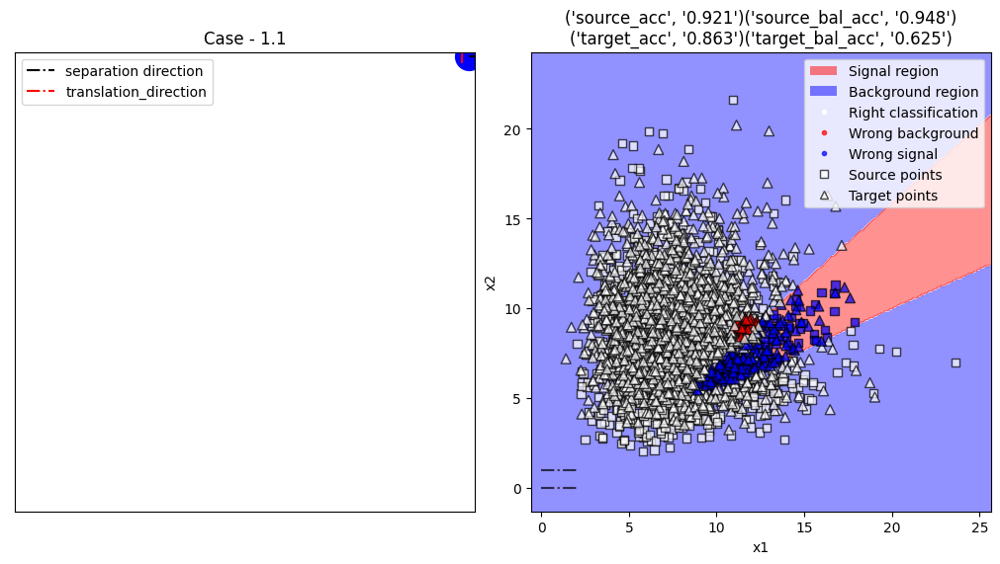

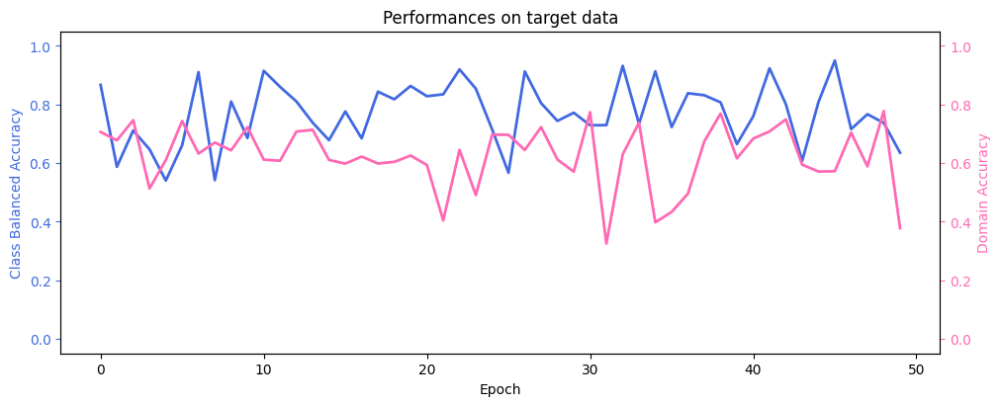

Results with  DANN_2
63/63 [==============================] - 0s 2ms/step


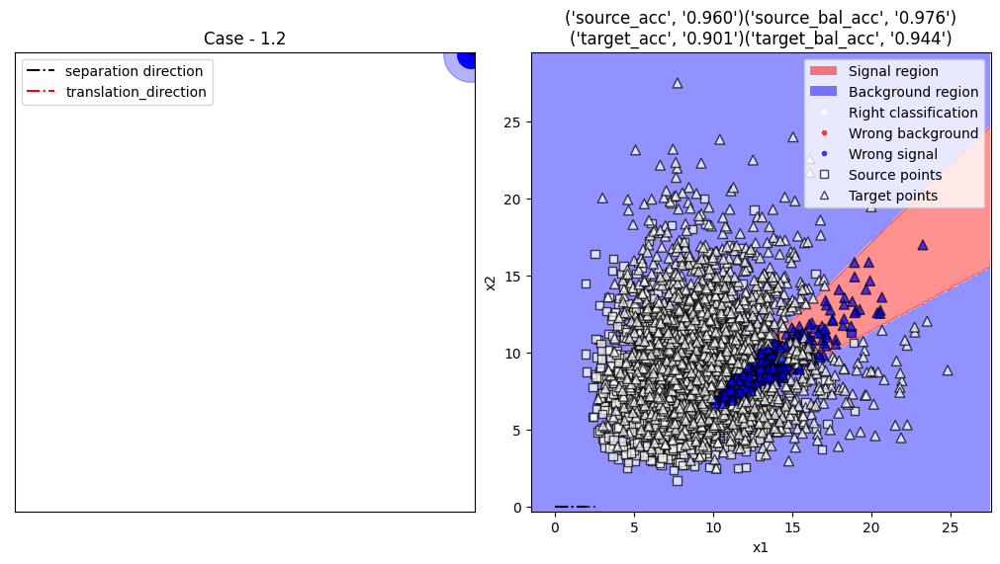

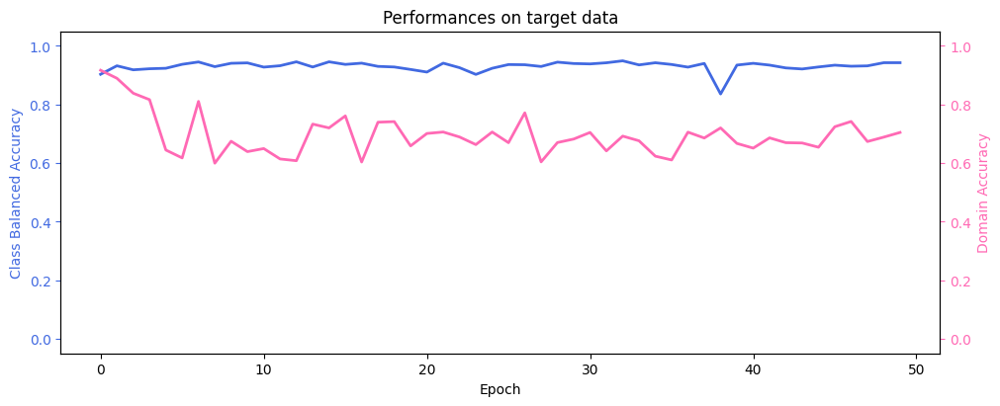

Results with  DANN_3
49/49 [==============================] - 0s 3ms/step


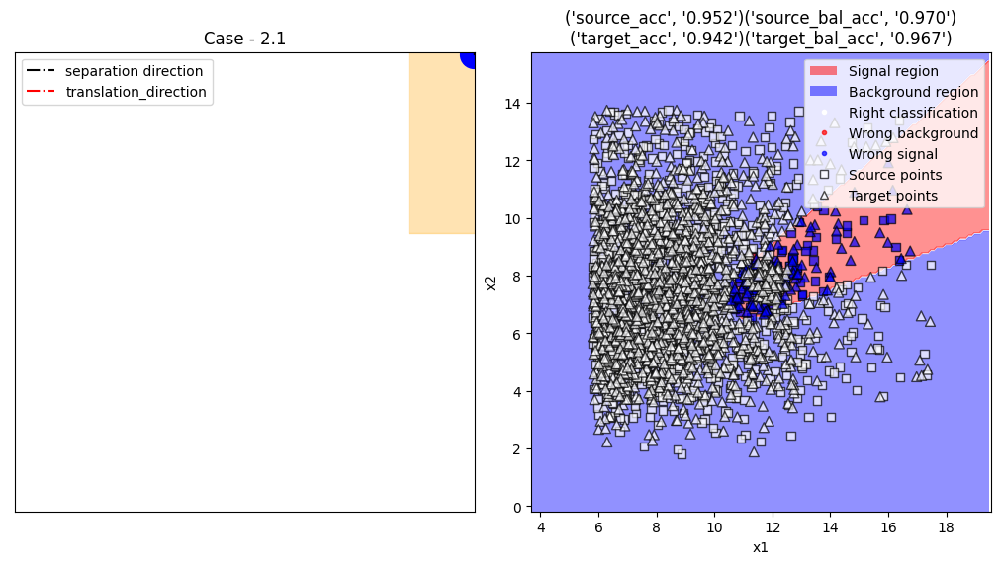

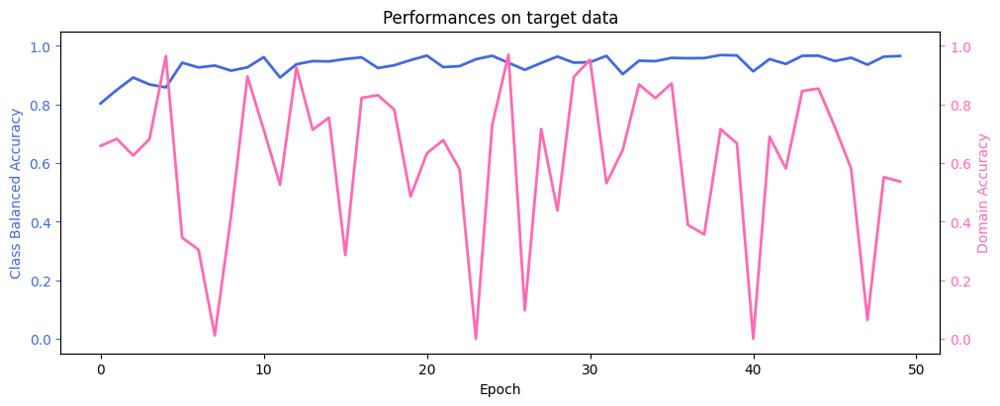

Results with  DANN_4
63/63 [==============================] - 0s 2ms/step


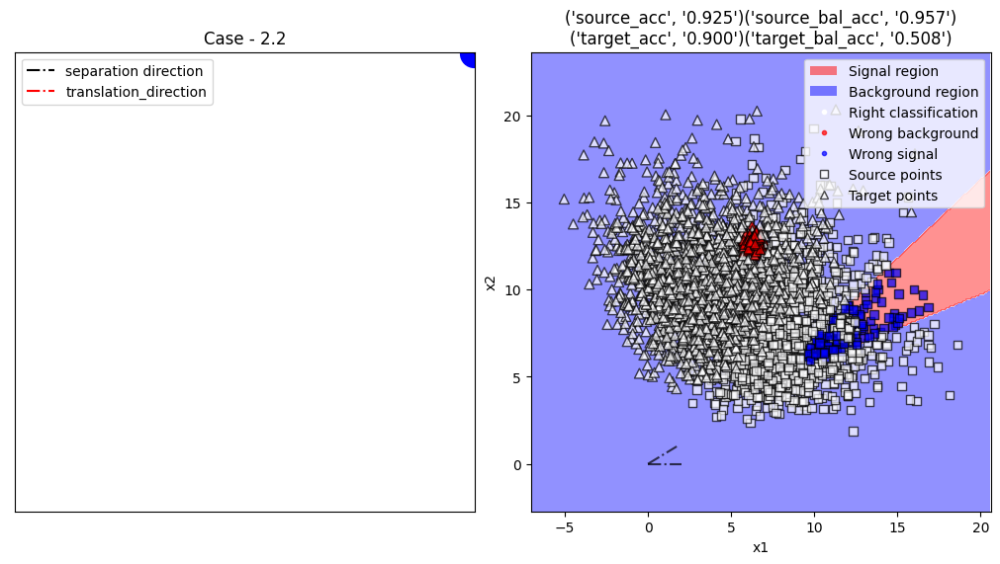

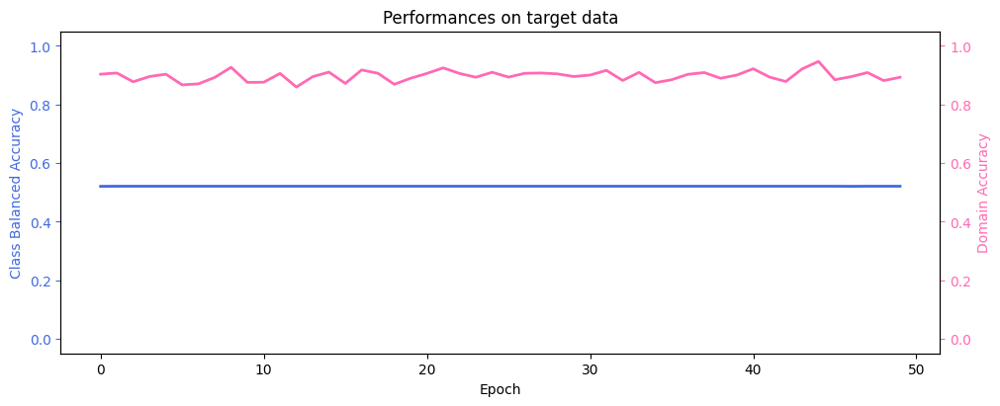

Results with  DANN_5
63/63 [==============================] - 0s 2ms/step


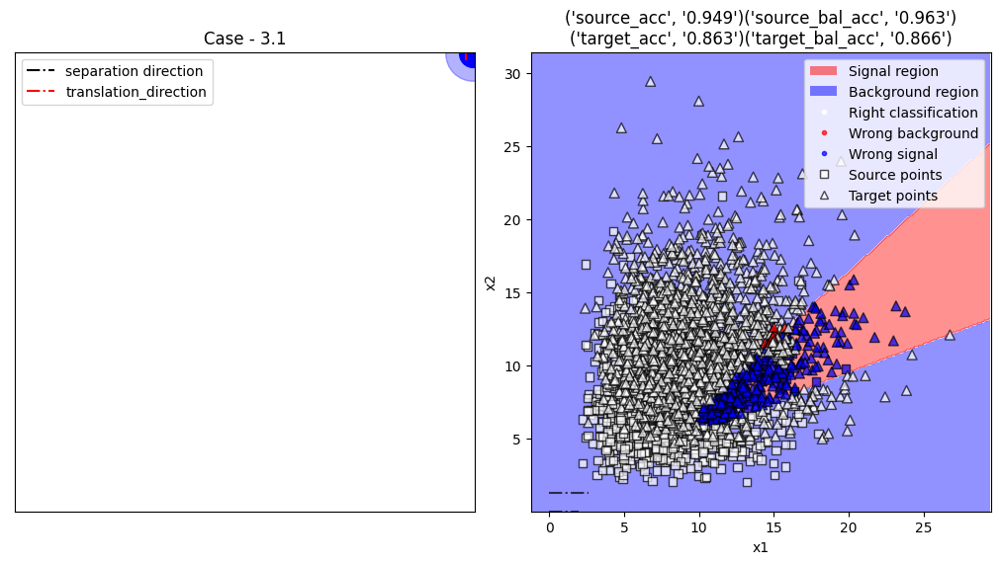

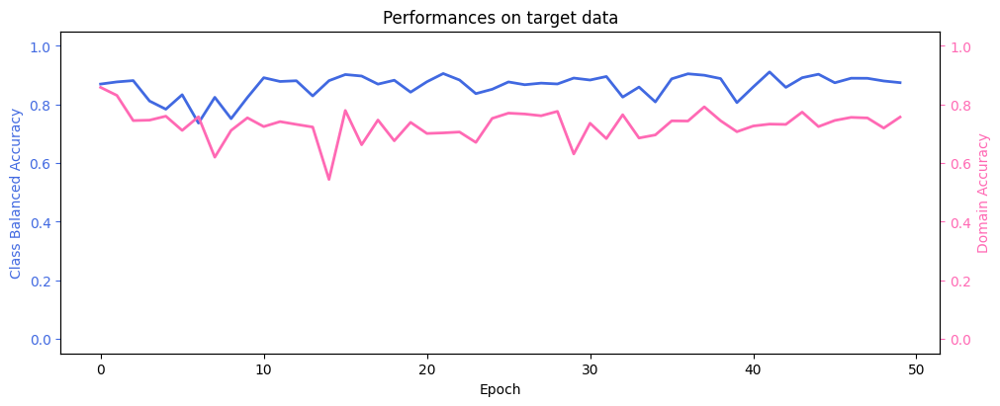

Results with  DANN_6
47/47 [==============================] - 0s 2ms/step


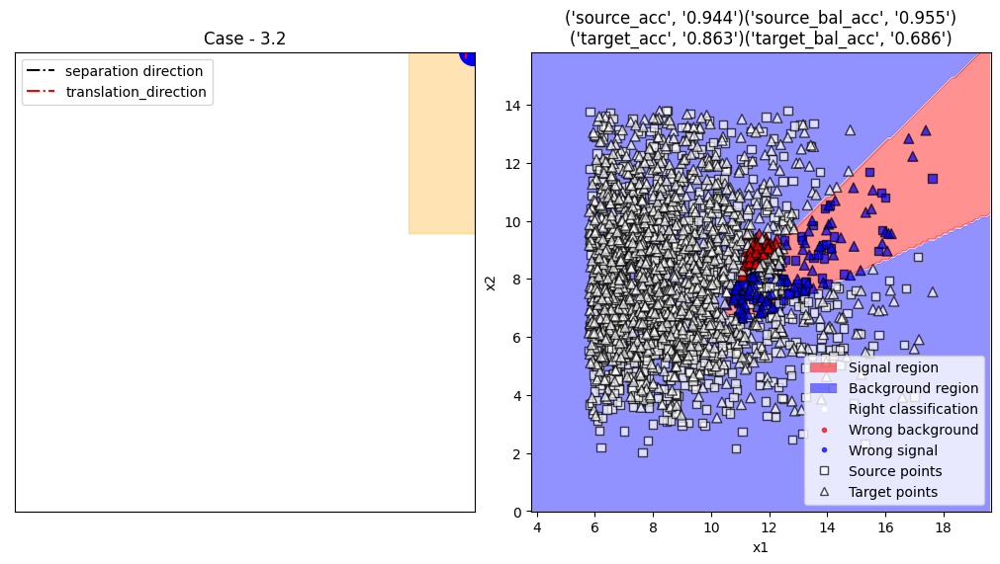

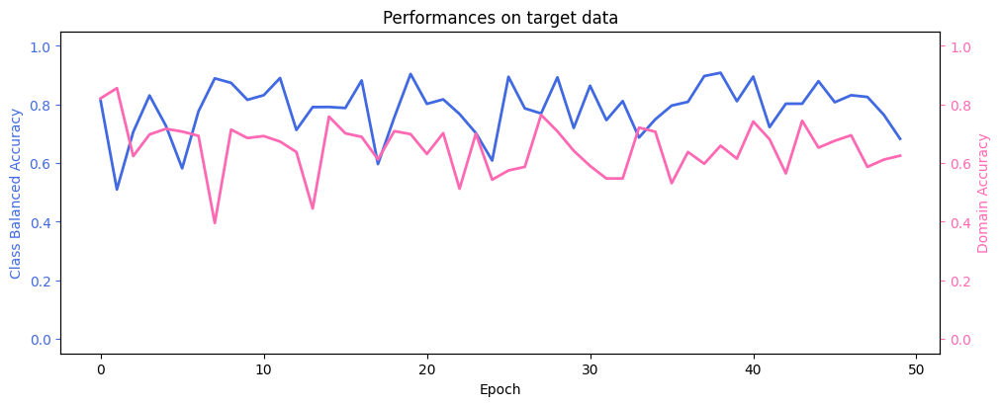

Results with  DANN_7
63/63 [==============================] - 0s 2ms/step


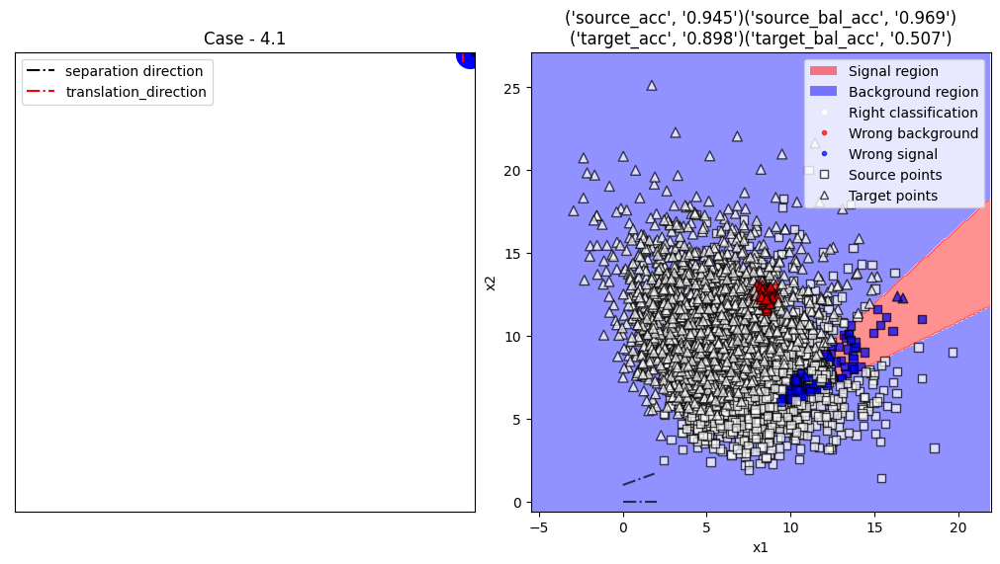

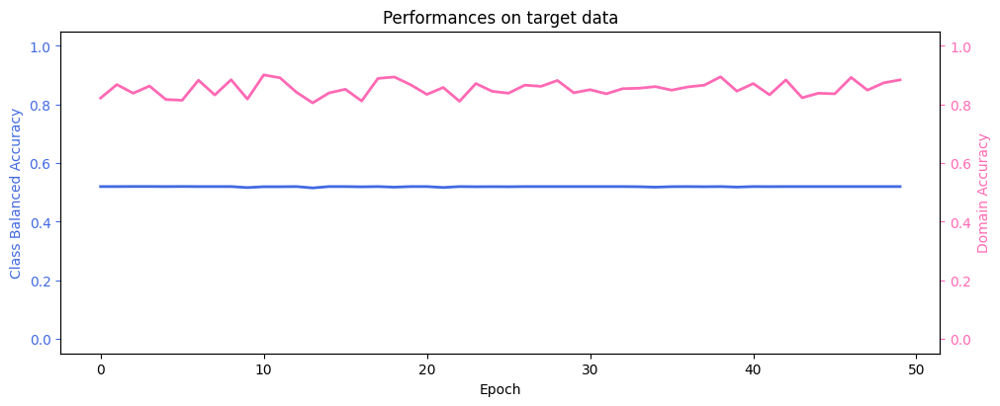

Results with  DANN_8
49/49 [==============================] - 0s 3ms/step


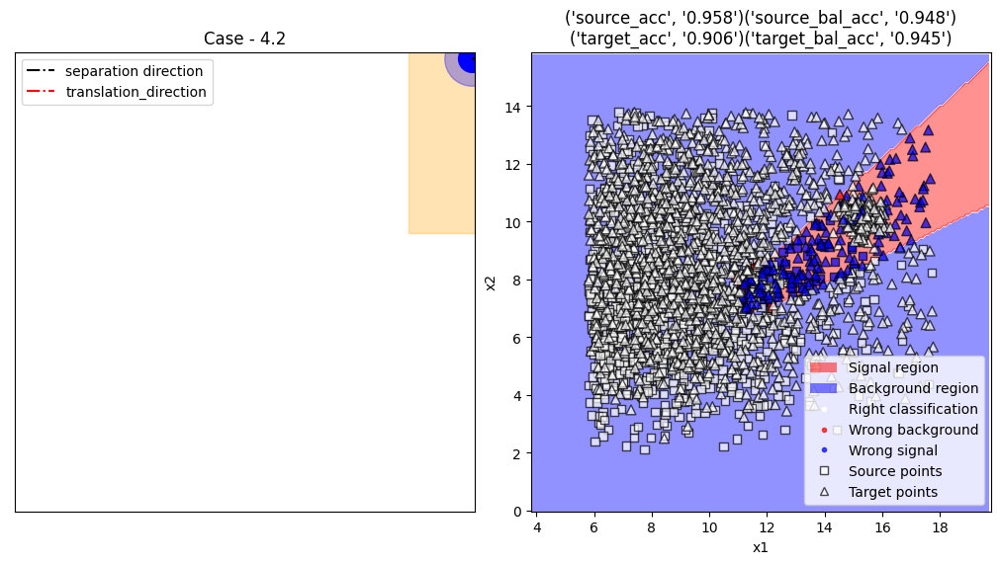

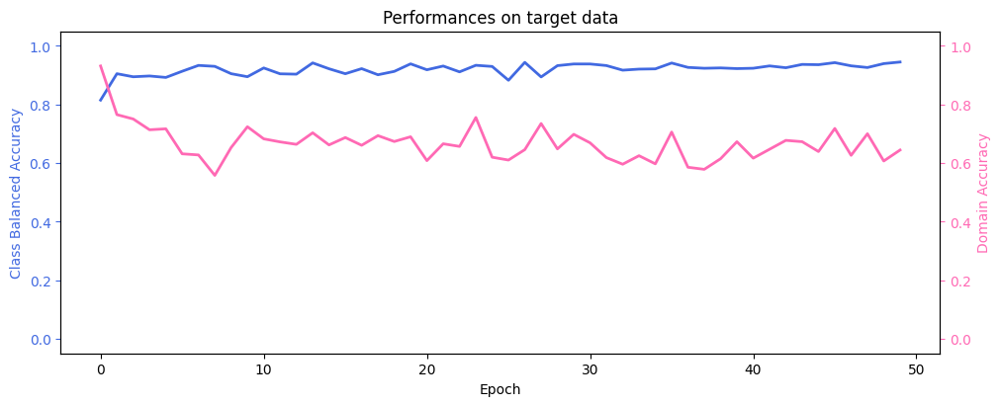

Results with  DANN_9
63/63 [==============================] - 0s 2ms/step


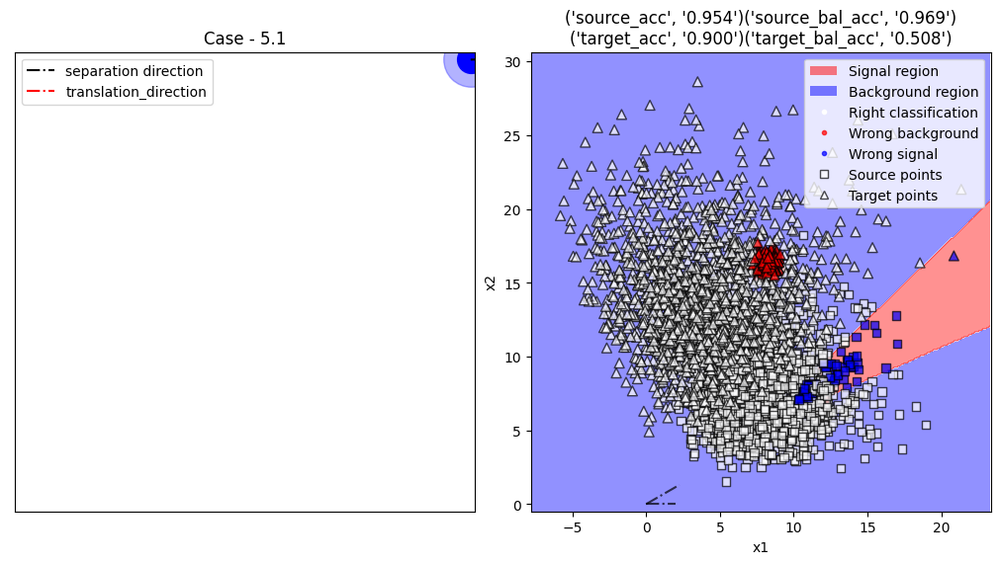

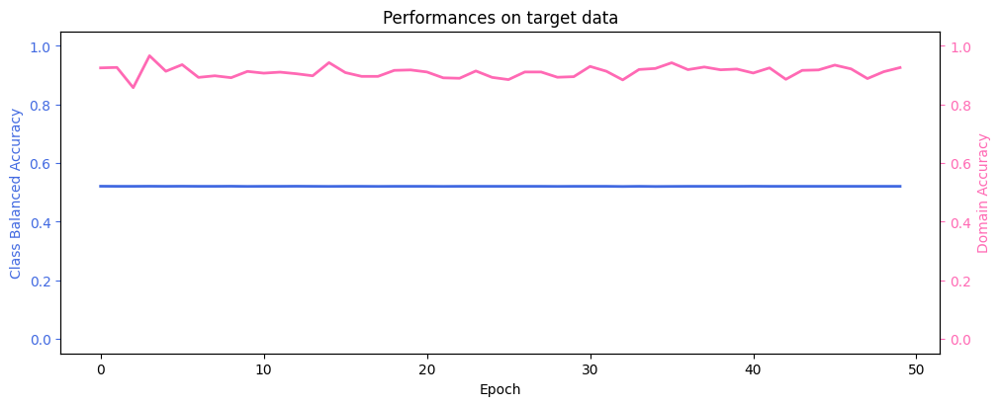

Results with  DANN_10
56/56 [==============================] - 0s 3ms/step


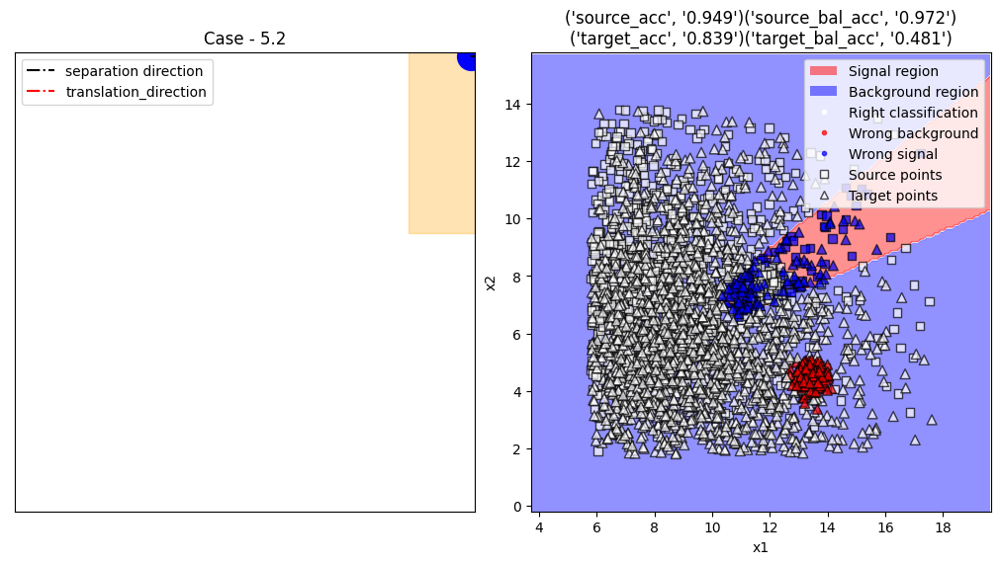

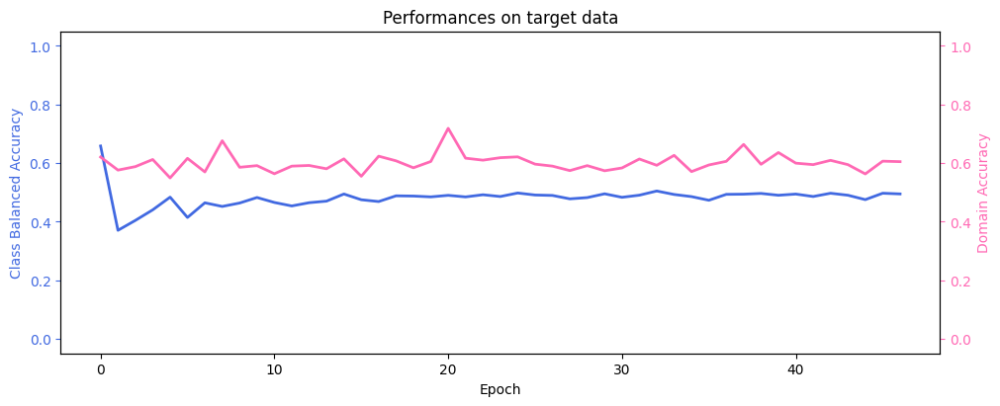

Results with  DANN_11
63/63 [==============================] - 0s 2ms/step


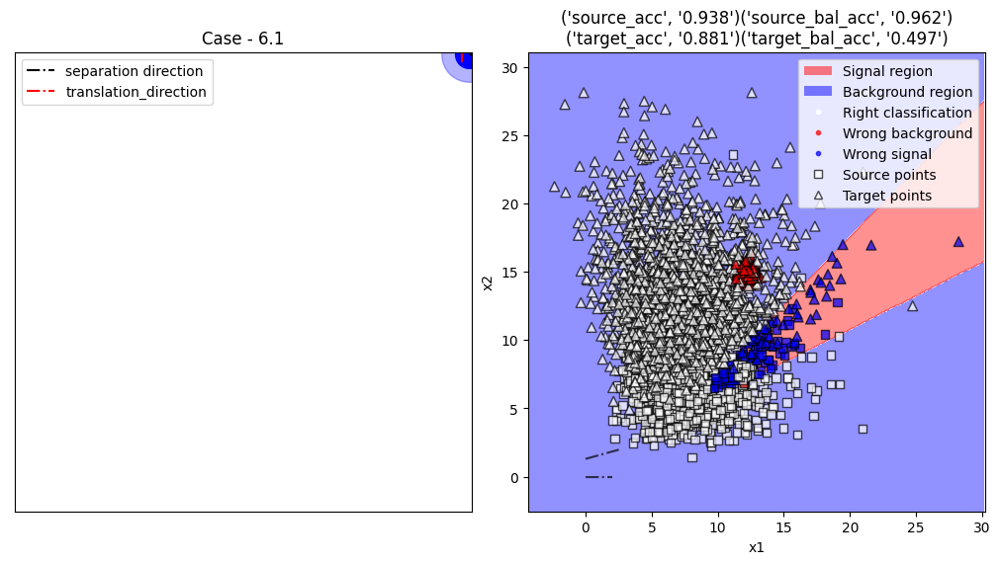

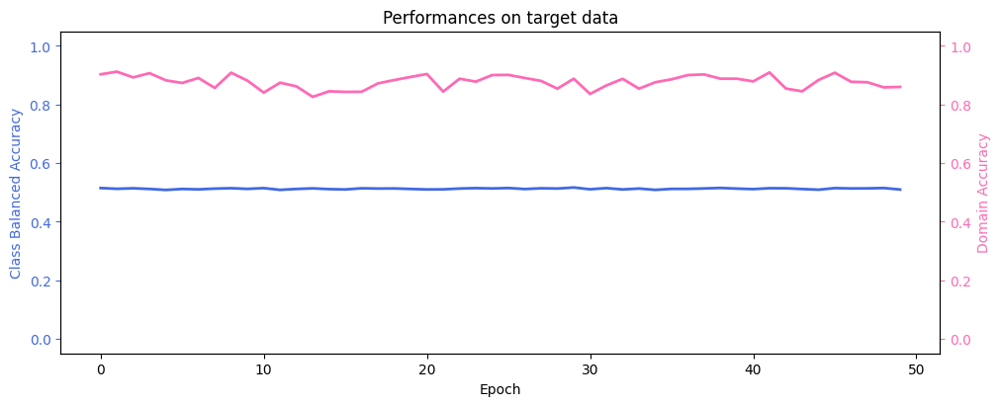

Results with  DANN_12
20/20 [==============================] - 0s 2ms/step


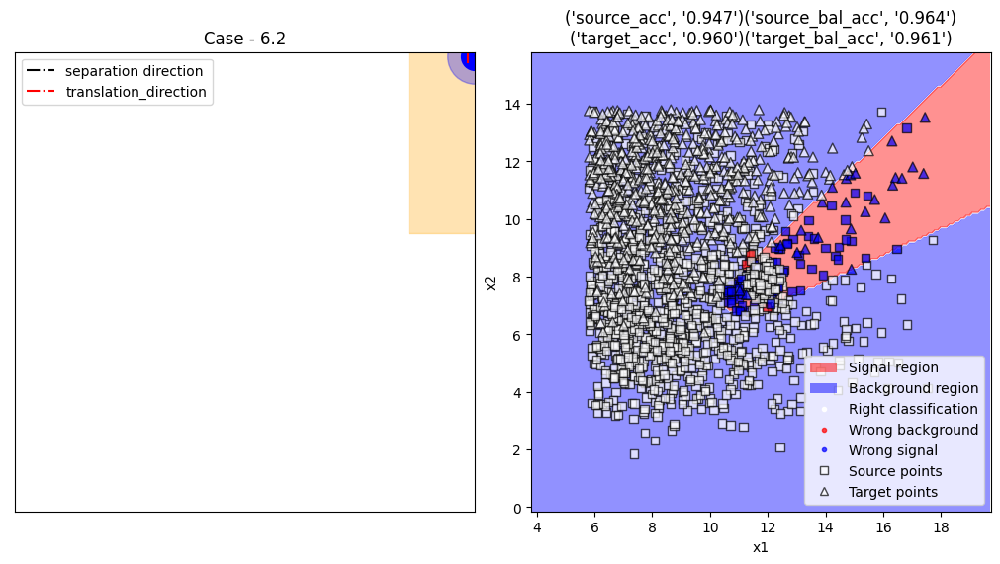

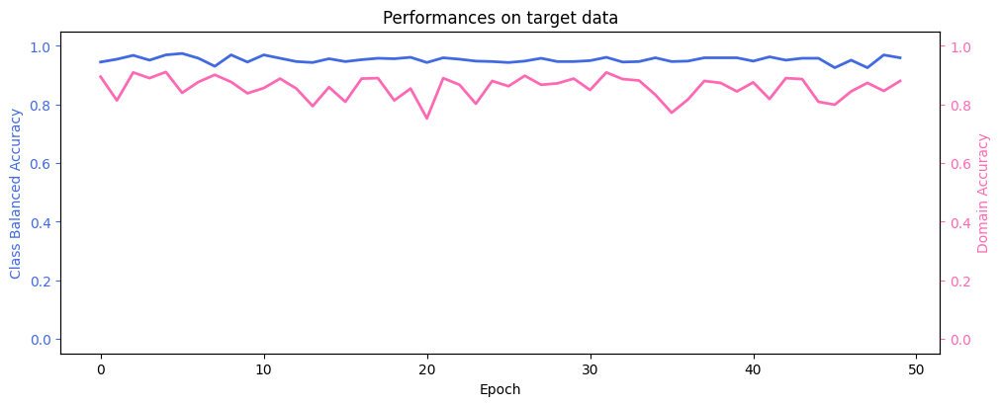

In [91]:
for i,data_pack in enumerate(zip(models,x_sources,y_sources,x_targets,y_targets,settings,histories)):

    # Unpack
    DANN_model,x_source,y_source,x_target,y_target,setting,history = data_pack
    print("Results with ", DANN_model.name)
    
    # Evaluate DANN
    results = evaluate_DANN(DANN_model,x_source, y_source, x_target, y_target)
    
    # Visualize DANN
    before_training = False # If True, true color of the points and no decision boundary. Prediction colors if False
    source_alpha = 0.7 # Opacity of source points
    target_alpha = 0.7 # Opacity of target points
    target_colors = True # Plot target points with meaningful colors if True and in grey if False
    regions_alpha = 0.5 # Opacity of prediction regions
    show_scores = True # Whether or not to show the title made of scores
    save_figure = True
    visualize_DANN_boundaries(DANN_model, x_source.values, y_source, x_target.values, y_target, setting, results, before_training, source_alpha, target_alpha, target_colors, regions_alpha, show_scores, save_figure)
    
    visualize_history(history)